# Common Imports

In [10]:
import os, glob, itertools
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
import pypulse, your
import driftrate, driftlaw
import pandas as pd
from tqdm import tqdm
from datetime import datetime
from matplotlib.ticker import (MultipleLocator, AutoMinorLocator)
import PyQt6.QtCore

# Marthi et al. 2020: FRB20180916B (FRB180916.J0158+65)

B:\dev\frbrepeaters\driftrate.py:169: ComplexWarning: Casting complex values to real discards the imaginary part
  temp_array_a[0:nx,:] = result_shifted[nx-1:2*nx-1,:]
B:\dev\frbrepeaters\driftrate.py:170: ComplexWarning: Casting complex values to real discards the imaginary part
  temp_array_a[nx:2*nx-1,:] = result_shifted[0:nx-1,:]


type: <class 'numpy.ndarray'>	shape: (128, 200), type: <class 'numpy.ndarray'>	shape: (255, 399)
type: <class 'numpy.ndarray'>	shape: (128, 200), type: <class 'numpy.ndarray'>	shape: (255, 399)
type: <class 'numpy.ndarray'>	shape: (128, 200), type: <class 'numpy.ndarray'>	shape: (255, 399)


<ipython-input-1-4d1ff1ba89a9>:53: UserWarning: No contour levels were found within the data range.
  plt.contour(fitmap, [popt[0]/4, popt[0]*0.9], colors='b', alpha=0.75, extent=corrextents, origin='lower')


type: <class 'numpy.ndarray'>	shape: (128, 200), type: <class 'numpy.ndarray'>	shape: (255, 399)
type: <class 'numpy.ndarray'>	shape: (128, 200), type: <class 'numpy.ndarray'>	shape: (255, 399)
type: <class 'numpy.ndarray'>	shape: (128, 200), type: <class 'numpy.ndarray'>	shape: (255, 399)
type: <class 'numpy.ndarray'>	shape: (128, 200), type: <class 'numpy.ndarray'>	shape: (255, 399)
type: <class 'numpy.ndarray'>	shape: (128, 200), type: <class 'numpy.ndarray'>	shape: (255, 399)
type: <class 'numpy.ndarray'>	shape: (128, 200), type: <class 'numpy.ndarray'>	shape: (255, 399)
type: <class 'numpy.ndarray'>	shape: (128, 200), type: <class 'numpy.ndarray'>	shape: (255, 399)


B:\dev\frbrepeaters\driftrate.py:48: RuntimeWarning: invalid value encountered in sqrt
  width_x = np.sqrt(abs((np.arange(col.size)-y)**2*col).sum()/col.sum())
C:\Users\hmsmo\AppData\Roaming\Python\Python38\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\Users\hmsmo\AppData\Roaming\Python\Python38\site-packages\matplotlib\contour.py:1494: UserWarning: Warning: converting a masked element to nan.
  self.zmax = float(z.max())
C:\Users\hmsmo\AppData\Roaming\Python\Python38\site-packages\matplotlib\contour.py:1495: UserWarning: Warning: converting a masked element to nan.
  self.zmin = float(z.min())


type: <class 'numpy.ndarray'>	shape: (128, 200), type: <class 'numpy.ndarray'>	shape: (255, 399)
type: <class 'numpy.ndarray'>	shape: (128, 200), type: <class 'numpy.ndarray'>	shape: (255, 399)


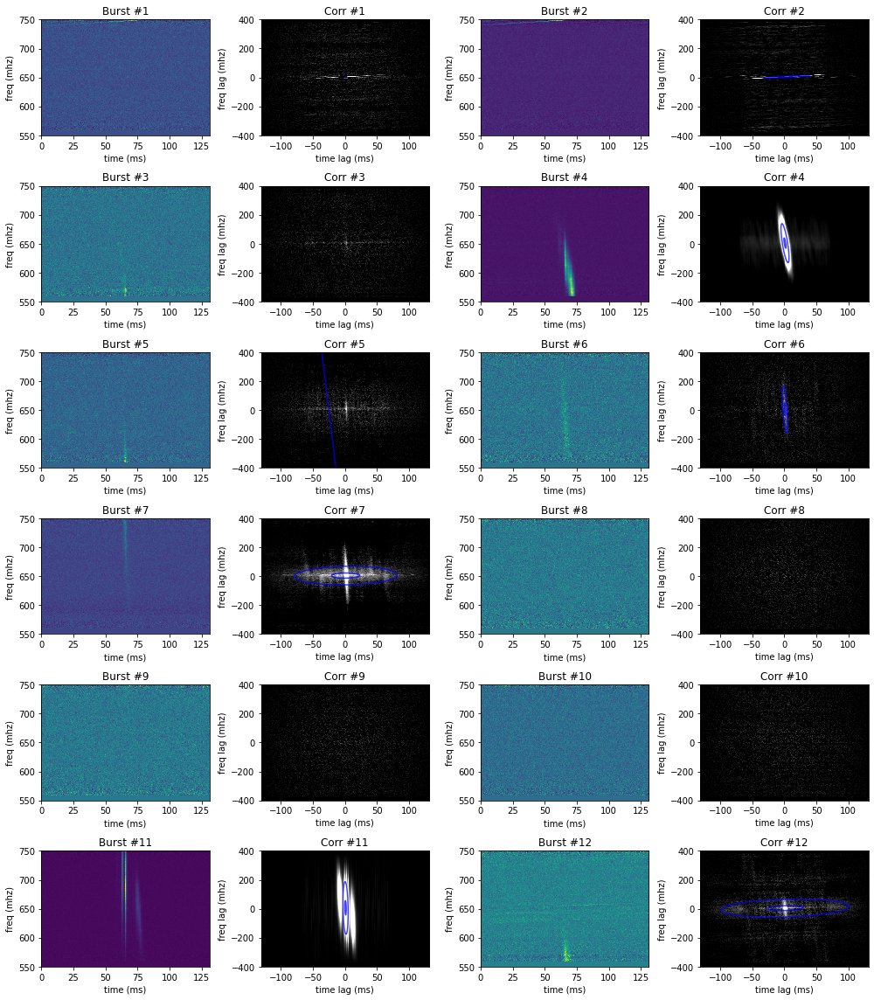

In [1]:
import os, glob, itertools
import numpy as np
import matplotlib.pyplot as plt
import pypulse, your
import driftrate, driftlaw
import frbrepeaters
import pandas as pd

# %matplotlib qt
%matplotlib inline

DM = 348.82       # pc/cm3
bwidth = 200   # mhz
df = bwidth / 2048   # mhz
dt = 327.68          # us
dt = 0.32768          # ms
lowest_freq = 550 # mhz

plt.figure(figsize=(14,16))
nrows, ncols = 6, 4
ploti = itertools.count(start=1, step=1)
burstnum = 1

for filename in glob.glob('data/marthi2020/DDTC123_24Mar2020/*.npy'):
    # print(f'loading {filename}')
    wfall = np.transpose(np.load(filename))
    wfall[:100] = 0
    wfall[2036:] = 0
    
    nfreq = 128
    tfac = 2
    wfall = driftrate.subsample(wfall, nfreq, wfall.shape[1]//tfac)
    wfall = driftrate.subtractbg(wfall, tleft=0, tright=100)
    ts = np.nanmean(wfall, axis=0)
    pkidx = np.nanargmax(ts)
   
    view = wfall[..., pkidx-100:pkidx+100]
    corr = driftrate.autocorr2d(view)
    print(f'type: {type(view)}\tshape: {view.shape}, type: {type(corr)}\tshape: {corr.shape}')
    drift, drift_error, popt, perr, theta, red_chisq, center_f, fitmap = driftrate.processBurst(view, bwidth/nfreq, dt*tfac, lowest_freq, verbose=False)
    extents, corrextents = driftrate.getExtents(view, df=bwidth/nfreq, dt=dt*tfac, lowest_freq=lowest_freq)

    plt.subplot(nrows, ncols, next(ploti))
    plt.imshow(view, origin='lower', interpolation='none', aspect='auto', extent=extents)
    plt.title(f'Burst #{burstnum}')
    plt.xlabel('time (ms)'), plt.ylabel('freq (mhz)')
    
    plt.subplot(nrows, ncols, next(ploti))
    plt.imshow(corr, origin='lower', interpolation='none', aspect='auto', extent=corrextents, cmap='gray')
    plt.clim(0, np.max(corr)/20)
    plt.title(f'Corr #{burstnum}')
    plt.xlabel('time lag (ms)'), plt.ylabel('freq lag (mhz)')
    if popt[0] > 0:
        plt.contour(fitmap, [popt[0]/4, popt[0]*0.9], colors='b', alpha=0.75, extent=corrextents, origin='lower')

    burstnum += 1

plt.tight_layout()
# plt.savefig('MarthiBursts.pdf')
plt.show()


# Luo et al. 2020: FRB180301

/home/mohammed/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


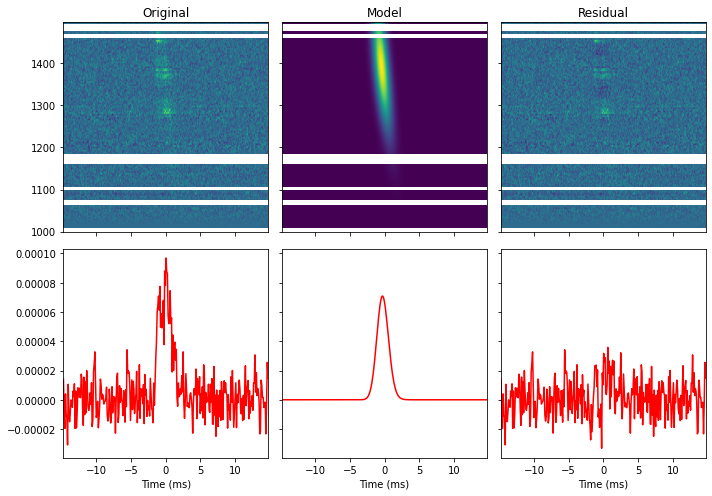

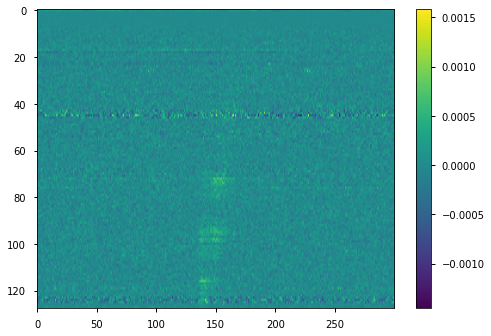

/home/mohammed/.local/lib/python3.8/site-packages/numpy/core/fromnumeric.py:755: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  a.partition(kth, axis=axis, kind=kind, order=order)


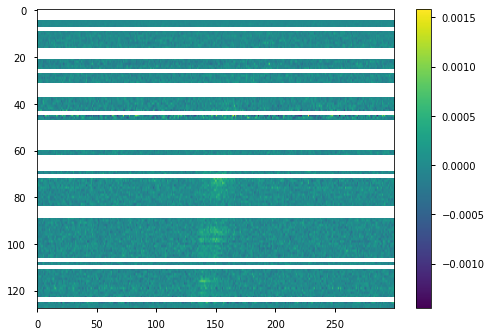

/home/mohammed/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/mnt/b/dev/burstfit/burstfit/utils/functions.py:150: RuntimeWarning: overflow encountered in exp
  B = np.exp((1 / 2) * (sigma / tau) ** 2)
/mnt/b/dev/burstfit/burstfit/utils/functions.py:155: RuntimeWarning: overflow encountered in exp
  pulse[scat_idx] = A * B * np.exp(ln_C) * D
/mnt/b/dev/burstfit/burstfit/utils/functions.py:155: RuntimeWarning: invalid value encountered in multiply
  pulse[scat_idx] = A * B * np.exp(ln_C) * D
/mnt/b/dev/burstfit/burstfit/utils/functions.py:278: RuntimeWarning: invalid value encountered in multiply
  model = l * spectra_from_fit[:, None]
/mnt/b/dev/burstfit/burstfit/utils/functions.py:155: RuntimeWarning: overflow encountered in multiply
  pulse[scat_idx] = A * B * np.exp(ln_C) * D


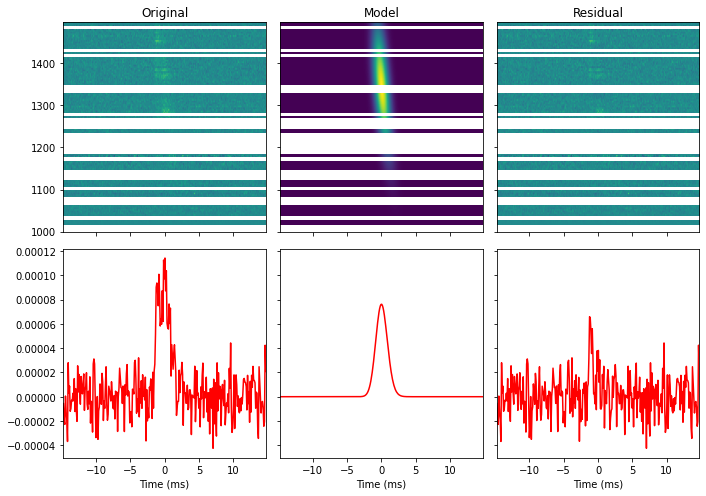

In [57]:
from burstfit.data import BurstData
from burstfit.fit import BurstFit
from burstfit.model import Model, SgramModel
from burstfit.utils.plotter import plot_me, plot_fit_results
from burstfit.utils.functions import pulse_fn_vec, sgram_fn_vec, gauss_norm, gauss_norm2
from your.utils.rfi import sk_sg_filter_raw

filename = 'data/luo2020/180813_ar_file/ar_file/converted/FRB180301_20190716-M07_0086_sub.npz'
data = np.load(filename)

def prep_mask(nfchans, mask_chans=[]):
    input_mask = np.zeros(nfchans, dtype="bool")
    for m in mask_chans:
        if isinstance(m, tuple) or isinstance(m, list):
            assert len(m) == 2
            input_mask[m[0] : m[1]] = True
        elif isinstance(m, int):
            input_mask[m] = True
    return input_mask
                
mask = prep_mask(data['wfall'].shape[0], [125, 124, 123, 45, 44, 42, 43, 46, 26, 18, 17, 1, 0, 119])
wfall = np.ma.array(data['wfall'], mask=False*np.ones(data['wfall'].shape))
wfall.mask[mask, :] = True
pkidx = np.nanargmax(np.nanmean(wfall, axis=0))
wfall = wfall[..., pkidx-150:pkidx+150]

# For pulse, we will use a gaussian convolved with an exponential model 
pnames = ['S', 'mu_t', 'sigma_t', 'tau']
pulseModel = Model(pulse_fn_vec, param_names=pnames)
snames = ['mu_f', 'sigma_f']
spectraModel = Model(gauss_norm, param_names=snames)
sgramModel = SgramModel(pulseModel, spectraModel, sgram_fn_vec, mask=mask)

bf = BurstFit(
    sgram_model=sgramModel,
    sgram=wfall,
    width=wfall.shape[0],
    dm=data['DM'],
    foff=3.91,
    fch1=data['dfs'][0],
    tsamp=0.0983/1000,
    mask=mask)

bf.validate()
bf.precalc()
bf.fitall(plot=False)
plot_fit_results(bf.sgram, bf.sgram_model.evaluate, bf.sgram_params['all'][1]['popt'], bf.tsamp, bf.fch1, bf.foff, show=True, save=False)

## Using the noise removal stuff
view = data['wfall'][..., pkidx-150:pkidx+150]
plot_me(view)
sigma = 3
window = 15
mask = sk_sg_filter_raw(
    data=view.copy().T,
    foff=3.91,
    tsamp=0.0983/1000,
    spectral_kurtosis_sigma=sigma,
    savgol_frequency_window=window,
    savgol_sigma=sigma,
)
wfall2 = np.ma.array(view.copy(), mask=False*np.ones(view.copy().shape))
# mask = prep_mask(wfall2.shape[0], mask)
wfall2.mask[mask, :] = True
# wfall2[mask,:] = 0
plot_me(wfall2)

bf = BurstFit(
    sgram_model=sgramModel,
    sgram=wfall2,
    width=wfall2.shape[0],
    dm=data['DM'],
    foff=3.91,
    fch1=data['dfs'][0],
    tsamp=0.0983/1000,
    mask=mask)

bf.validate()
bf.precalc()
bf.fitall(plot=False)
plot_fit_results(bf.sgram, bf.sgram_model.evaluate, bf.sgram_params['all'][1]['popt'], bf.tsamp, bf.fch1, bf.foff, show=True, save=False)


In [83]:
masks = {
    'B:\\dev\\frbrepeaters\\data\\luo2020\\180813_ar_file\\ar_file\\converted\\FRB180301_20190716-M07_0086_sub.npz': [125, 124, 123, 45, 44, 42, 43, 46, 26, 18, 17, 1, 0, 119], 
    'B:\\dev\\frbrepeaters\\data\\luo2020\\180813_ar_file\\ar_file\\converted\\FRB180301_20190716-M07_0254_sub.npz': [43, 44, 46, 45, 119, 120, 124, 123, 125, 121, 122, 24, 23, 1, 0], 
    'B:\\dev\\frbrepeaters\\data\\luo2020\\180813_ar_file\\ar_file\\converted\\FRB180301_20190716-M07_0260_sub.npz': [42, 44, 43, 45, 46, 125, 122, 124, 123, 119, 121, 120, 40, 41, 1, 0, 49, 25, 23], 
    'B:\\dev\\frbrepeaters\\data\\luo2020\\180813_ar_file\\ar_file\\converted\\FRB180301_20190716-M07_0409_sub.npz': [22, 23, 119, 120, 125, 124, 123, 29, 45, 46, 0, 43, 44], 
    'B:\\dev\\frbrepeaters\\data\\luo2020\\180813_ar_file\\ar_file\\converted\\FRB180301_20191007-M01_0030_sub.npz': [126, 125, 127, 0, 45, 47, 46], 
    'B:\\dev\\frbrepeaters\\data\\luo2020\\180813_ar_file\\ar_file\\converted\\FRB180301_20191007-M01_0520_sub.npz': [120, 119, 47, 46, 44, 45, 43, 41, 62, 50, 49], 
    'B:\\dev\\frbrepeaters\\data\\luo2020\\180813_ar_file\\ar_file\\converted\\FRB180301_20191007-M01_0621_sub.npz': [51, 50, 52, 46, 45, 62, 119, 120, 123, 122, 124, 126, 125, 0], 
    'B:\\dev\\frbrepeaters\\data\\luo2020\\180813_ar_file\\ar_file\\converted\\FRB180301_20191007-M01_1003_sub.npz': [119, 120, 68, 70, 69, 67, 52, 54, 53, 44, 46, 45, 43, 35, 116], 
    'B:\\dev\\frbrepeaters\\data\\luo2020\\180813_ar_file\\ar_file\\converted\\FRB180301_20191007-M01_1463_sub.npz': [23, 22, 68, 69, 71, 125, 124, 123, 120, 118, 119, 122, 1, 0], 
    'B:\\dev\\frbrepeaters\\data\\luo2020\\180813_ar_file\\ar_file\\converted\\FRB180301_20191007-M01_1481_sub.npz': [124, 123, 125, 119, 121, 120, 122, 1, 0], 
    'B:\\dev\\frbrepeaters\\data\\luo2020\\180813_ar_file\\ar_file\\converted\\FRB180301_20191008-M01_0098a_sub.npz': [1, 45, 46, 120, 0], 
    'B:\\dev\\frbrepeaters\\data\\luo2020\\180813_ar_file\\ar_file\\converted\\FRB180301_20191008-M01_0098b_sub.npz': [1, 45, 46, 120, 0], 
    'B:\\dev\\frbrepeaters\\data\\luo2020\\180813_ar_file\\ar_file\\converted\\FRB180301_20191008-M01_0334_sub.npz': [123, 125, 124, 43, 44, 45, 46, 0, 120, 119], 
    'B:\\dev\\frbrepeaters\\data\\luo2020\\180813_ar_file\\ar_file\\converted\\FRB180301_20191008-M01_0850_sub.npz': [119, 121, 120, 26, 62, 44, 45, 47, 46, 27, 23], 
    'B:\\dev\\frbrepeaters\\data\\luo2020\\180813_ar_file\\ar_file\\converted\\FRB180301_20191008-M01_1509_sub.npz': [119, 120, 68, 44, 46, 45, 23, 43]
}

np.save('luomasks.npy', [masks])
stuff = np.load('luomasks.npy', allow_pickle=True)[0]

dict

/mnt/b/dev/frbrepeaters/driftrate.py:172: ComplexWarning: Casting complex values to real discards the imaginary part
  temp_array_a[0:nx,:] = result_shifted[nx-1:2*nx-1,:]
/mnt/b/dev/frbrepeaters/driftrate.py:173: ComplexWarning: Casting complex values to real discards the imaginary part
  temp_array_a[nx:2*nx-1,:] = result_shifted[0:nx-1,:]


shape: (128, 298), 	shape: (255, 595)
shape: (128, 288), 	shape: (255, 575)
shape: (128, 187), 	shape: (255, 373)
shape: (128, 284), 	shape: (255, 567)


/mnt/b/dev/frbrepeaters/driftrate.py:50: RuntimeWarning: invalid value encountered in sqrt
  width_x = np.sqrt(abs((np.arange(col.size)-y)**2*col).sum()/col.sum())
/home/mohammed/.local/lib/python3.8/site-packages/scipy/optimize/minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
/home/mohammed/.local/lib/python3.8/site-packages/matplotlib/contour.py:1430: UserWarning: Warning: converting a masked element to nan.
  self.zmax = float(z.max())
/home/mohammed/.local/lib/python3.8/site-packages/matplotlib/contour.py:1431: UserWarning: Warning: converting a masked element to nan.
  self.zmin = float(z.min())
/mnt/b/dev/frbrepeaters/driftrate.py:352: UserWarning: No contour levels were found within the data range.
  plt.contour(fitmap, [popt[0]/4, popt[0]*0.9], colors='b', alpha=0.75, extent=corrextents, origin='lower')


shape: (128, 282), 	shape: (255, 563)
shape: (128, 280), 	shape: (255, 559)


/mnt/b/dev/frbrepeaters/driftrate.py:52: RuntimeWarning: invalid value encountered in sqrt
  width_y = np.sqrt(abs((np.arange(row.size)-x)**2*row).sum()/row.sum())


shape: (128, 278), 	shape: (255, 555)
shape: (128, 276), 	shape: (255, 551)
shape: (128, 274), 	shape: (255, 547)
shape: (128, 272), 	shape: (255, 543)
shape: (128, 270), 	shape: (255, 539)
shape: (128, 268), 	shape: (255, 535)
shape: (128, 266), 	shape: (255, 531)
shape: (128, 264), 	shape: (255, 527)
shape: (128, 236), 	shape: (255, 471)


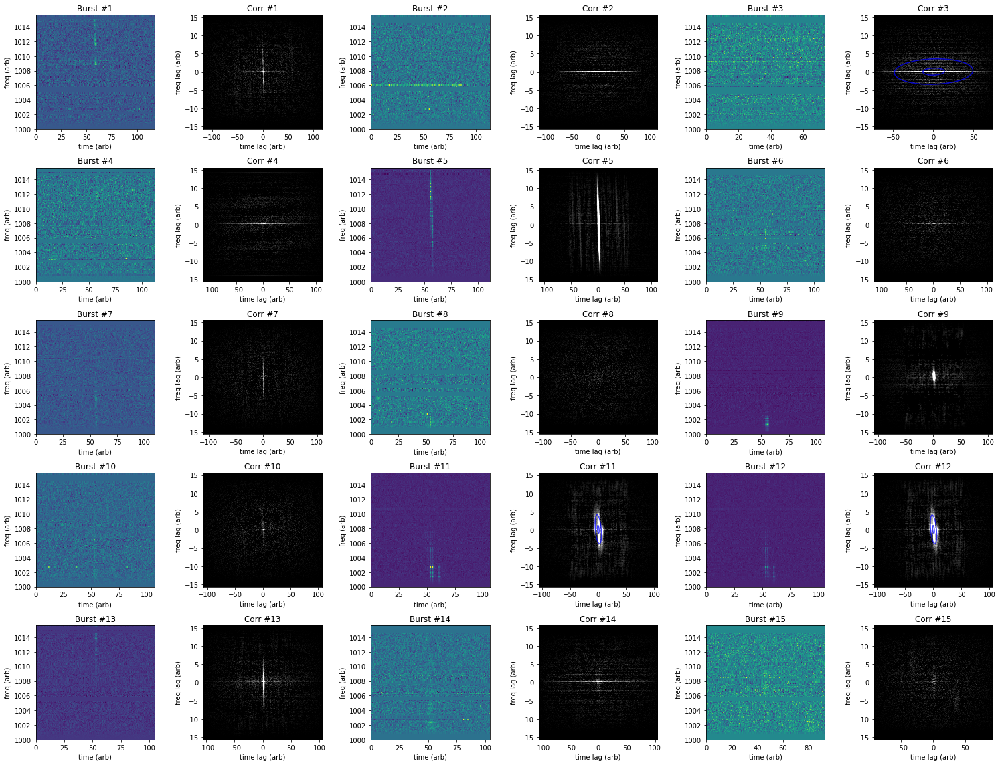

In [2]:
def loadluodata_raw(filename):
    ar = pypulse.Archive(filename, prepare=True)
    wfall = ar.getData()
    burstmetadata = {
        'dt'        : ar.getTimes(),
        'dfs'       : ar.getFreqs(),
        'DM'        : ar.getDM(),
        'bandwidth' : ar.getBandwidth(),
        'duration'  : ar.getDuration(),
        'center_f'  : ar.getCenterFrequency(),
        'freq_unit' : ar.getFrequencyUnit(),
        'time_unit' : ar.getTimeUnit(),
        'int_unit'  : ar.getIntensityUnit(),
        'telescope' : ar.getTelescope(),
        'burstSN'   : ar.getSN(),
        'raw_shape' : wfall.shape
    }
    
    subfall = driftrate.subsample(wfall, 128, wfall.shape[1]//4)
    pkidx = np.nanargmax(np.nanmean(subfall, axis=0))
    np.save(filename.split('.')[0] + '_sub.npy', subfall)    
    np.savez(filename.split('.')[0] + '_sub.npz', wfall=subfall, **burstmetadata)

    return subfall, pkidx, wfall, burstmetadata

def loadluodata_npz(filename):
    obsdata = np.load(filename)
    wfall = obsdata['wfall']
    for mask in masks[filename]:
        wfall[mask] = 0
    subfall = driftrate.subsample(wfall, 128, 7168//4)
    # subfall = driftrate.subtractbg(subfall, tleft=0, tright=10)
    pkidx = np.nanargmax(np.nanmean(subfall, axis=0))
    return subfall, pkidx, wfall, obsdata

masks = {
    'shape': (128, 7168),
    'data/luo2020/180813_ar_file/ar_file/converted/FRB180301_20190716-M07_0086_sub.npz': [125, 124, 123, 45, 44, 42, 43, 46, 26, 18, 17, 1, 0, 119], 
    'data/luo2020/180813_ar_file/ar_file/converted/FRB180301_20190716-M07_0254_sub.npz': [43, 44, 46, 45, 119, 120, 124, 123, 125, 121, 122, 24, 23, 1, 0], 
    'data/luo2020/180813_ar_file/ar_file/converted/FRB180301_20190716-M07_0260_sub.npz': [42, 44, 43, 45, 46, 125, 122, 124, 123, 119, 121, 120, 40, 41, 1, 0, 49, 25, 23], 
    'data/luo2020/180813_ar_file/ar_file/converted/FRB180301_20190716-M07_0409_sub.npz': [22, 23, 119, 120, 125, 124, 123, 29, 45, 46, 0, 43, 44], 
    'data/luo2020/180813_ar_file/ar_file/converted/FRB180301_20191007-M01_0030_sub.npz': [126, 125, 127, 0, 45, 47, 46], 
    'data/luo2020/180813_ar_file/ar_file/converted/FRB180301_20191007-M01_0520_sub.npz': [120, 119, 47, 46, 44, 45, 43, 41, 62, 50, 49], 
    'data/luo2020/180813_ar_file/ar_file/converted/FRB180301_20191007-M01_0621_sub.npz': [51, 50, 52, 46, 45, 62, 119, 120, 123, 122, 124, 126, 125, 0], 
    'data/luo2020/180813_ar_file/ar_file/converted/FRB180301_20191007-M01_1003_sub.npz': [119, 120, 68, 70, 69, 67, 52, 54, 53, 44, 46, 45, 43, 35, 116], 
    'data/luo2020/180813_ar_file/ar_file/converted/FRB180301_20191007-M01_1463_sub.npz': [23, 22, 68, 69, 71, 125, 124, 123, 120, 118, 119, 122, 1, 0], 
    'data/luo2020/180813_ar_file/ar_file/converted/FRB180301_20191007-M01_1481_sub.npz': [124, 123, 125, 119, 121, 120, 122, 1, 0], 
    'data/luo2020/180813_ar_file/ar_file/converted/FRB180301_20191008-M01_0098a_sub.npz': [1, 45, 46, 120, 0], 
    'data/luo2020/180813_ar_file/ar_file/converted/FRB180301_20191008-M01_0098b_sub.npz': [1, 45, 46, 120, 0], 
    'data/luo2020/180813_ar_file/ar_file/converted/FRB180301_20191008-M01_0334_sub.npz': [123, 125, 124, 43, 44, 45, 46, 0, 120, 119], 
    'data/luo2020/180813_ar_file/ar_file/converted/FRB180301_20191008-M01_0850_sub.npz': [119, 121, 120, 26, 62, 44, 45, 47, 46, 27, 23], 
    'data/luo2020/180813_ar_file/ar_file/converted/FRB180301_20191008-M01_1509_sub.npz': [119, 120, 68, 44, 46, 45, 23, 43]
}

# driftrate.plotStampcard(loadluodata_raw, fileglob='data/luo2020/180813_ar_file/ar_file/converted/*.rf', figsize=(21, 16), nrows=5, ncols=6)
driftrate.plotStampcard(loadluodata_npz, fileglob='data/luo2020/180813_ar_file/ar_file/converted/*.npz', figsize=(21, 16), nrows=5, ncols=6)

In [19]:
ar = pypulse.Archive('data/luo2020/180813_ar_file/ar_file/converted/FRB180301_20190716-M07_0086.rf', prepare=True, thread=True)
dt, dfs = ar.getAxis('T'), ar.getAxis('F')
dt
# dt, dfs, luoDM = ar.getTimes(), ar.getFreqs(), ar.getDM(), ar.getBandwidth(), ar.getDuration(), ar.getCenterFrequency()
luometadata = {
    'dt'        : ar.getTimes(),
    'dfs'       : ar.getFreqs(),
    'DM'        : ar.getDM(),
    'bandwidth' : ar.getBandwidth(),
    'duration'  : ar.getDuration(),
    'center_f'  : ar.getCenterFrequency(),
    'freq_unit' :ar.getFrequencyUnit(),
    'time_unit' :ar.getTimeUnit(),
    'int_unit'  :ar.getIntensityUnit(),
    'telescope' :ar.getTelescope(),
    'burstSN'   :ar.getSN(),
}
print(metadata)
print(ar.getData().shape, dfs[1]-dfs[0], (dfs[-1] - dfs[0])/len(dfs))
timeres = metadata['dt'][0] / ar.getData().shape[1]

{'dt': array([0.70464307]), 'dfs': array([1000.        , 1000.12207031, 1000.24414062, ..., 1499.63378906,
       1499.75585938, 1499.87792969]), 'DM': 518.3, 'bandwidth': 500.0, 'duration': 1.409286144, 'center_f': 1250.0, 'freq_unit': 'MHz', 'time_unit': 'SEC', 'int_unit': 'Jy', 'telescope': 'FAST', 'burstSN': 5.30820815917212}
(4096, 28672) 0.1220703125 0.1220405101776123


2.4576e-05

In [27]:
# df = pd.read_csv('FRBName_results_3rows_Jul21.csv')
# df = df.set_index('name')
# df = driftlaw.computeModelDetails(df)
# df['DM'].dtype
df  = pd.DataFrame([['blah', 1.0, 'a']], columns=['name', 'val', 'val2']).set_index('name')
df2  = pd.DataFrame([['test2', 3.0, 'a']], columns=['name', 'val', 'val2']).set_index('name')
df3 = pd.DataFrame([['test2', 2.0, 'b']], columns=['name', 'val', 'val2']).set_index('name')
df4 = pd.DataFrame([['test2', 5.0, 'h']], columns=['name', 'val', 'val2']).set_index('name')
df = df.append([df2, df3])

dfnew = df2.copy()
dfnew['val2'] = 'b'

display(dfnew), display(df)
# df.reset_index().merge(dfnew.reset_index(), how='outer').set_index('name')
df[(df.index == 'test2') & (df['val'] == 3.0)] = dfnew

test = [ddf[p] for p in ['val', 'val2']]
ddf = df.head(1)
float(test[0])

,val,val2
name,,
test2,3.0,b


,val,val2
name,,
blah,1.0,a
test2,3.0,a
test2,2.0,b


1.0

Loading: data/luo2020/180813_ar_file/ar_file/converted/FRB180301_20190716-M07_0086.rf
Load time: 34.69 s


  0%|                                                                                            | 0/11 [00:00<?, ?it/s]

resolution:  3.9052963256835938 0.098304
(4096, 28672) (128, 7168)


100%|███████████████████████████████████████████████████████████████████████████████████| 11/11 [00:22<00:00,  2.05s/it]


,DM,slope (mhz/ms),center_f,theta
name,,,,
Burst1,516.300000,-67.337856,1372.474317,27.236543
Burst1,517.322222,-92.093128,1372.474317,20.827611
Burst1,518.344444,-143.099461,1372.474317,4.983186
Burst1,519.366667,-335.958987,1372.474317,7.971684
Burst1,520.388889,-11.593528,1372.474317,-0.283946
Burst1,521.411111,25.508239,1372.474317,-2.570796
Burst1,522.433333,107.686182,1372.474317,4.358966
Burst1,523.455556,75.439089,1372.474317,16.794054
Burst1,524.477778,58.655824,1372.474317,35.532998


,DM,center_f,slope (mhz/ms),slope error (mhz/ms),theta,red_chisq,amplitude,xo,yo,sigmax,...,slope_abs_nuobssq,min_sigma,max_sigma,min_sigma_error,max_sigma_error,sigma_t,tau_w,tau_w_error,sigma_t_ms,tau_w_ms
name,,,,,,,,,,,,,,,,,,,,,
Burst1,516.300000,1372.474317,-67.337856,0.062354,27.236543,1.625163e+01,0.000023,300.453141,128.443017,-35.442546,...,3.574792e-08,8.115246,35.442546,0.009624,0.042031,0.000798,0.000918,0.001089,0.797761,0.917910
Burst1,517.322222,1372.474317,-92.093128,0.112589,20.827611,1.671092e+01,0.000023,300.457325,128.388223,-8.541066,...,4.888986e-08,8.541066,33.904425,0.009984,0.039634,0.000840,0.001830,0.002140,0.839621,1.830482
Burst1,518.344444,1372.474317,-143.099461,0.274433,4.983186,1.614265e+01,0.000023,300.460997,128.369067,8.944596,...,7.596780e-08,8.944596,32.849710,0.010633,0.039058,0.000879,0.002347,0.002790,0.879290,2.346720
Burst1,519.366667,1372.474317,-335.958987,1.540825,7.971684,1.614481e+01,0.000023,300.465063,128.423783,-31.838793,...,1.783519e-07,9.248986,31.838793,0.011026,0.037956,0.000909,0.000915,0.001091,0.909212,0.915007
Burst1,520.388889,1372.474317,-11.593528,787.324127,-0.283946,2.516659e+01,-0.000075,575.918210,782.470550,126.449915,...,6.154704e-09,126.449915,1134.137009,3173.508194,403048.073081,0.012431,0.012942,331.561042,12.430532,12.942197
Burst1,521.411111,1372.474317,25.508239,-56.105381,-2.570796,2.813852e+06,-1.000000,-1.000000,-1.000000,-1.000000,...,-1.354166e-08,1.000000,1.000000,-1.000000,-1.000000,0.000098,0.000098,0.075290,0.098304,0.098304
Burst1,522.433333,1372.474317,107.686182,0.162645,4.358966,1.533532e+01,0.000023,300.469232,128.533444,33.899227,...,-5.716781e-08,8.963550,33.899227,0.010933,0.041347,0.000881,0.000935,0.001140,0.881153,0.934765
Burst1,523.455556,1372.474317,75.439089,0.081411,16.794054,1.523717e+01,0.000022,300.474205,128.498813,-35.747000,...,-4.004866e-08,8.645762,35.747000,0.010589,0.043782,0.000850,0.000953,0.001167,0.849913,0.952860
Burst1,524.477778,1372.474317,58.655824,0.049945,35.532998,1.540192e+01,0.000022,300.468487,128.483553,8.216280,...,-3.113886e-08,8.216280,37.715266,0.010042,0.046091,0.000808,0.001371,0.001676,0.807693,1.371140


trialDM = 516.3 drift = -67.33785604455426 center_f = 1372.474317444763 theta = 27.236542952430916
trialDM = 517.3222222222222 drift = -92.09312823479011 center_f = 1372.474317444763 theta = 20.827610669870268
trialDM = 518.3444444444444 drift = -143.09946081160209 center_f = 1372.474317444763 theta = 4.9831858213004985
trialDM = 519.3666666666667 drift = -335.9589865756213 center_f = 1372.474317444763 theta = 7.971683809184603
trialDM = 520.3888888888889 drift = -11.593527575145364 center_f = 1372.474317444763 theta = -0.2839464022395708
trialDM = 521.411111111111 drift = 25.50823907223418 center_f = 1372.474317444763 theta = -2.5707963267948966
trialDM = 522.4333333333333 drift = 107.6861822840447 center_f = 1372.474317444763 theta = 4.35896635804663
trialDM = 523.4555555555555 drift = 75.43908907084881 center_f = 1372.474317444763 theta = 16.794053898905236
trialDM = 524.4777777777778 drift = 58.6558240088619 center_f = 1372.474317444763 theta = 35.532997520151724
trialDM = 525.5 dr

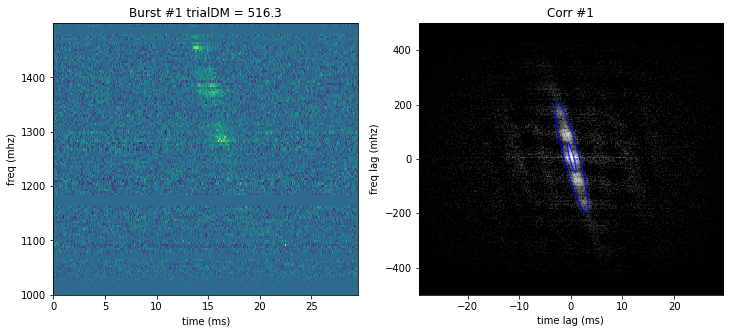

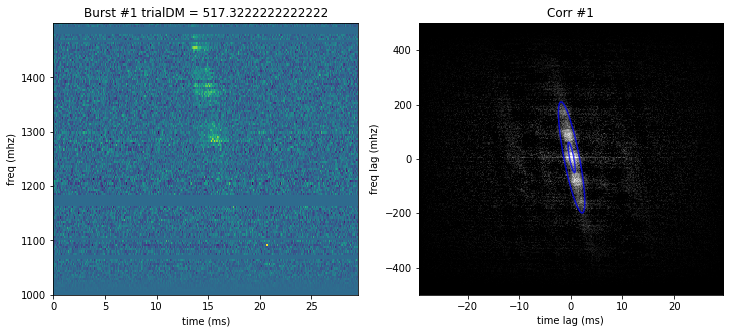

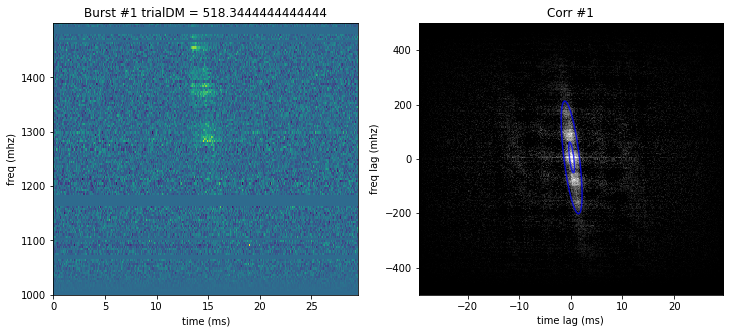

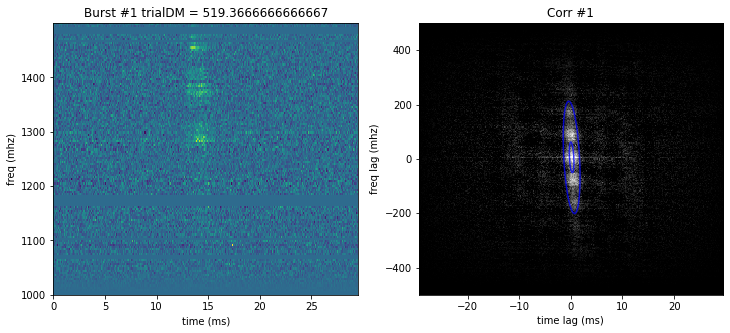

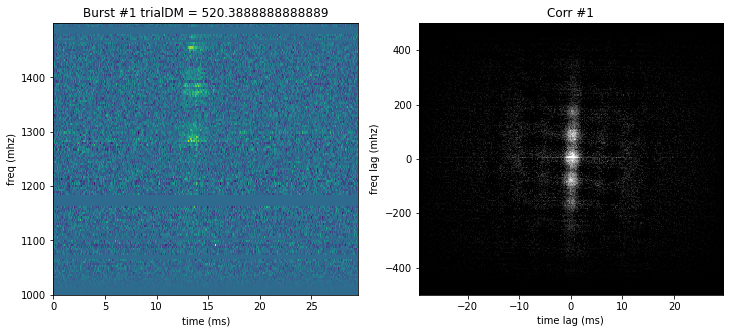

...

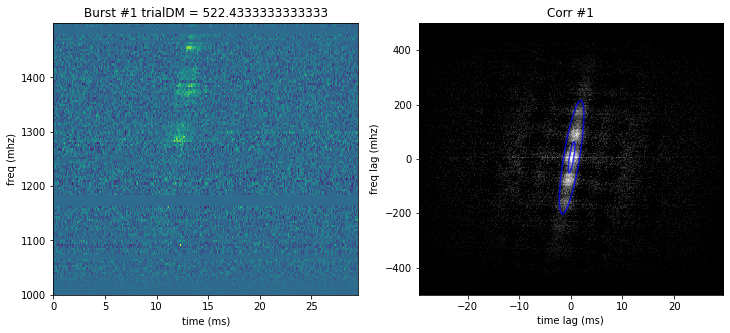

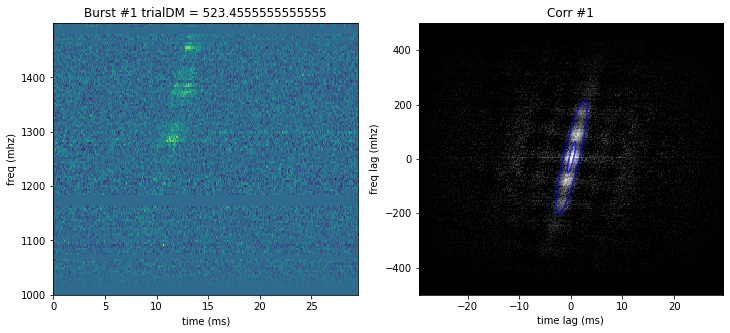

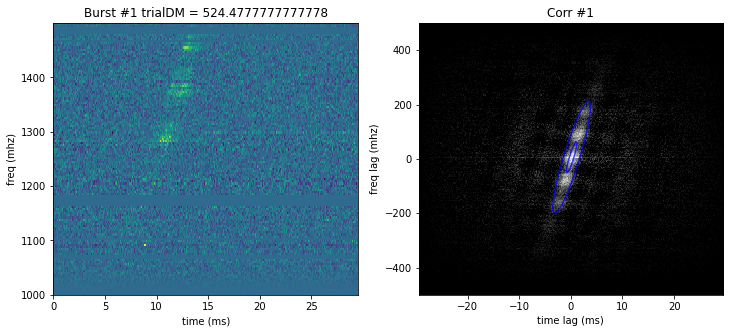

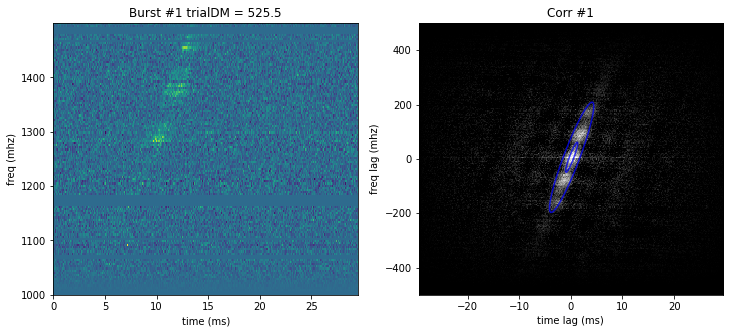

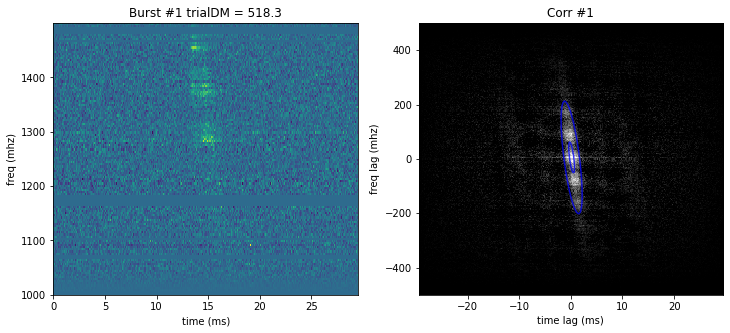

In [6]:
import warnings
warnings.filterwarnings("ignore")
import importlib
importlib.reload(driftrate)
importlib.reload(driftlaw)
# Single burst

# DM = 518.3       # pc/cm3
# bwidth = 500   # mhz
# df = (dfs[-1] - dfs[0])/len(dfs)   # mhz
# dt = metadata['dt'][0] / ar.getData().shape[1] # us
# dt = dt*1000          # ms
# lowest_freq = 1000 # mhz

subfall, pkidx, wfall, obsdata = loadluodata_raw('data/luo2020/180813_ar_file/ar_file/converted/FRB180301_20190716-M07_0086.rf')
subfall = driftrate.subsample(wfall, 128, wfall.shape[1]//4)

downf, downt = wfall.shape[0] / subfall.shape[0], wfall.shape[1] / subfall.shape[1]
DM = obsdata['DM']       # pc/cm3
bwidth = obsdata['bandwidth']   # mhz
dfs = obsdata['dfs']
df = (dfs[-1] - dfs[0])/len(dfs) * downf  # mhz

dt = obsdata['dt'][0] / wfall.shape[1]  * downt # s
dt = dt*1000          # ms
lowest_freq = 1000 # mhz
print('resolution: ', df, dt)

%matplotlib inline

# Burst 3 noise
# subfall[0:4]     = 0
# subfall[39:50]   = 0
# subfall[23:24]   = 0
# subfall[119:128] = 0

# Burst 1 noise
# subfall[0:14] = 0
# subfall[17:18] = 0
# subfall[26] = 0
# subfall[20:24] = 0
# subfall[43:46] = 0
# subfall[119:128] = 0
burst1maskchans = [125, 124, 123, 45, 44, 42, 43, 46, 26, 18, 17, 1, 0, 119]
for mchan in burst1maskchans:
    subfall[mchan] = 0

# subfall = driftrate.subtractbg(subfall, tleft=0, tright=5)
ts = np.nanmean(subfall, axis=0)
pkidx = np.nanargmax(ts)
print(wfall.shape, subfall.shape)
burstDM = 518.3
trialDMs = np.append(np.linspace(516.3, 525.5, num=10), burstDM)

view = subfall[..., pkidx-150:pkidx+150]
result, burstdf = driftrate.processDMRange('Burst1', view, burstDM, trialDMs, df, dt, lowest_freq)
display(burstdf[['DM', 'slope (mhz/ms)', 'center_f', 'theta']])
modeldf = driftlaw.computeModelDetails(burstdf)
display(modeldf)


for trialDM in trialDMs:
    view = subfall[..., pkidx-150:pkidx+150]
    view = driftrate.dedisperse(view, trialDM - burstDM, lowest_freq, df, dt)
    corr = driftrate.autocorr2d(view)

    drift, drift_error, popt, perr, theta, red_chisq, center_f, fitmap = driftrate.processBurst(view, df, dt, lowest_freq, verbose=False)
    extents, corrextents = driftrate.getExtents(view, df=df, dt=dt, lowest_freq=lowest_freq)

    # plt.plot(ts[pkidx-150:pkidx+150])

    plt.figure(figsize=(12, 5))
    plt.subplot(1, 2, 1)
    plt.imshow(view, origin='lower', interpolation='none', aspect='auto', extent=extents)
    plt.title(f'Burst #{1} {trialDM = }')
    plt.xlabel('time (ms)'), plt.ylabel('freq (mhz)')

    plt.subplot(1, 2, 2)
    plt.imshow(corr, origin='lower', interpolation='none', aspect='auto', extent=corrextents, cmap='gray')
    plt.clim(0, np.max(corr)/20)
    plt.title(f'Corr #{1}')
    plt.xlabel('time lag (ms)'), plt.ylabel('freq lag (mhz)')
    if popt[0] > 0:
        plt.contour(fitmap, [popt[0]/4, popt[0]*0.9], colors='b', alpha=0.75, extent=corrextents, origin='lower')

    print(f"{trialDM = } {drift = } {center_f = } {theta = }")

(466560,)
72.0


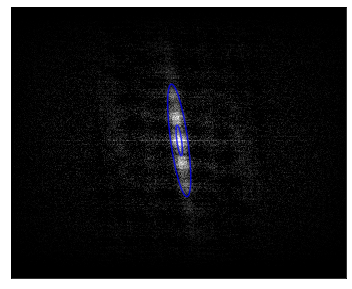

In [80]:
plt.figure(figsize=(6, 5))

# plt.imshow(corr, origin='lower', interpolation='none', aspect='auto', extent=corrextents, cmap='gray')
plt.imshow(corr, origin='lower', interpolation='none', aspect='auto', cmap='gray')

plt.clim(0, np.max(corr)/20)
# plt.contour(fitmap, [popt[0]/4, popt[0]*0.9], colors='b', alpha=0.75, extent=corrextents, origin='lower')
plt.contour(fitmap, [popt[0]/4, popt[0]*0.9], colors='b', alpha=0.75, origin='lower')
plt.gca().xaxis.set_major_locator(plt.NullLocator())
plt.gca().yaxis.set_major_locator(plt.NullLocator())
fig = plt.gcf()
fig.canvas.draw()
texture = np.frombuffer(fig.canvas.tostring_rgb(), dtype='uint8')
print(texture.shape)
fig.get_size_inches()*fig.dpi
print(fig.dpi)


In [24]:
from matplotlib.backends.backend_agg import FigureCanvasAgg as FigureCanvas
from matplotlib.figure import Figure
fig = Figure()
canvas = FigureCanvas(fig)
ax = fig.gca()
ax.imshow(corr, origin='lower', interpolation='none', aspect='auto', extent=corrextents, cmap='gray')
# ax.clim(0, np.max(corr)/20)
if popt[0] > 0:
    ax.contour(fitmap, [popt[0]/4, popt[0]*0.9], colors='b', alpha=0.75, extent=corrextents, origin='lower')
ax.axis('off')
canvas.draw()
texture = np.fromstring(canvas.tostring_rgb(), dtype='uint8')

AttributeError: Figure.show works only for figures managed by pyplot, normally created by pyplot.figure()

In [81]:
# Checking gui results
# df = pd.read_csv('FRB180301_results_11rows_Jul15.csv')
# df.set_index('DM')

df = pd.read_csv('FRBName_results_4rows_Jul19.csv')
df = df.set_index('DM')
# df = df.set_index(df.index.astype('float'))
# df = df.set_index('name')
# df = df.append(pd.DataFrame({'center_f': 1}, ['0086_sub_a.npz']))
# df = df.append(pd.DataFrame({'center_f': 1}, ['0052_sub_a.npz']))
df.loc[513.1170043945312][5:11]
df.loc[np.isclose(df.index, 513.11700439)].iloc[0][5:11]
np.isclose(df.index, 513.11700439)

array([ True, False, False, False])

# Oostrum et al. 2020: FRB20121102A 

Loading: data/oostrum2020/R1_frb121102/R1_B23.rf
Load time: 10.07 s
done loading


Window size is less than 41 channels. Setting it to 41 channels.


subfall.shape = (128, 3125), wfall.shape = (1024, 25000)
df = 1.56097412109375, dt/1000 = 0.00032768
pkidx = 1955
burstmetadata['duration'] = 0.065536
saved data/oostrum2020/R1_frb121102/R1_B23


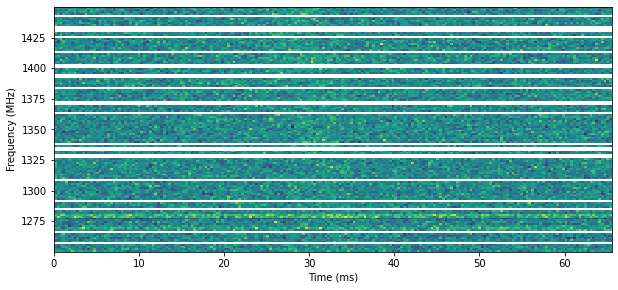

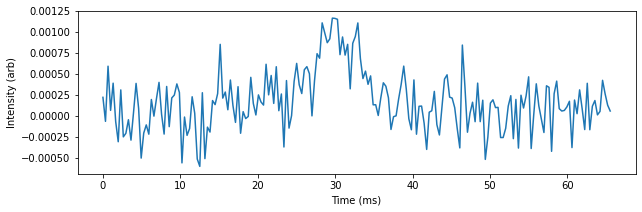

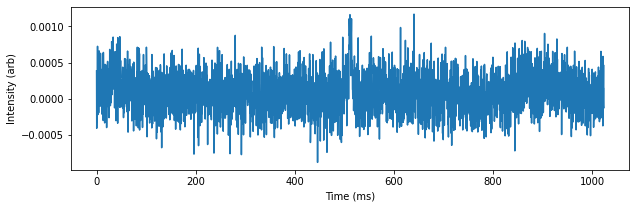

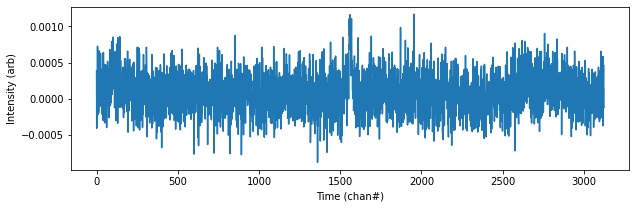

In [24]:
#filename = 'data/oostrum2020/R1_frb121102/R1_B01.rf'
import warnings
warnings.filterwarnings("ignore")
import importlib
from your.utils.rfi import sk_sg_filter
importlib.reload(driftrate)
importlib.reload(driftlaw)
importlib.reload(frbrepeaters)
plt.close('all')

for filename in glob.glob('data/oostrum2020/R1_frb121102/*.rf'):
    if filename != 'data/oostrum2020/R1_frb121102/R1_B23.rf':
        continue

    subfall, pkidx, wfall, burstmetadata = frbrepeaters.loadpsrfits(filename)
    subfall = driftrate.subsample(wfall, 128, wfall.shape[1]//8)
    print(f'{subfall.shape = }, {wfall.shape = }')
    width = 100
    burstmetadata['raw_shape'] = subfall.shape # overwrite

    dfs = burstmetadata['dfs']
    df = (dfs[-1] - dfs[0])/subfall.shape[0]
    dt = burstmetadata['duration'] / subfall.shape[1]*1000
    # spectral kurtosis RFI
    sigma = 8
    window = 7
    mask = sk_sg_filter(
        data=subfall.copy().T,
        foff=df,
        tsamp=dt/1000,
        spectral_kurtosis_sigma=sigma,
        savgol_frequency_window=window,
        savgol_sigma=sigma,
    )
    # print(mask.shape, mask)
    print(f"{df = }, {dt/1000 = }")
    subfall = np.ma.array(subfall.copy(), mask=np.zeros(subfall.shape))
    subfall.mask[mask , :] = True
    # print(subfall[0])
    # subfall[mask , :] = 0
    # print(subfall[0])
    # subfall = np.clip(subfall, np.min(subfall), 0.0001)

    # wfall2.mask[mask, :] = True

    fullts = np.nanmean(subfall, axis=0)
    pkidx = np.nanargmax(fullts)
    print(f"{pkidx = }")
    if 'B23' in filename: pkidx = 1570
    
    view = subfall[:, pkidx-width:pkidx+width]
    burstmetadata['duration'] = dt*view.shape[1]/1000 # s
    print(f"{burstmetadata['duration'] = }")
    extents, _ = driftrate.getExtents(view, df=df, dt=dt, lowest_freq=dfs[0])
    ts = np.nanmean(view, axis=0)
    plt.figure(figsize=(10, 4.5))
    plt.xlabel("Time (ms)"); plt.ylabel("Frequency (MHz)")
    plt.imshow(view, origin='lower', interpolation='none', aspect='auto', extent=extents)
    
    plt.figure(figsize=(10, 3))
    plt.plot(np.linspace(extents[0], extents[1], num=len(ts)), ts)
    plt.xlabel("Time (ms)"); plt.ylabel("Intensity (arb)")

    plt.figure(figsize=(10, 3))
    plt.plot(np.linspace(extents[0], len(fullts)*dt, num=len(fullts)), fullts)
    plt.xlabel("Time (ms)"); plt.ylabel("Intensity (arb)")

    plt.figure(figsize=(10, 3))
    plt.plot(range(0, len(fullts)), fullts)
    plt.xlabel("Time (chan#)"); plt.ylabel("Intensity (arb)")

    savename = filename.split('.')[0]
    np.savez(savename, wfall=view, **burstmetadata)
    print('saved', savename)

## R1_B30

Loading: data/oostrum2020/R1_frb121102/R1_B30.rf
Load time: 4.83 s
done loading
(1536, 12500)


Window size is less than 41 channels. Setting it to 41 channels.


subfall.shape = (192, 3125), wfall.shape = (1536, 12500)
df = 1.5614827473958333, dt/1000 = 0.00032768
pkidx = 1014
burstmetadata['duration'] = 0.065536
saved data/oostrum2020/R1_frb121102/R1_B30


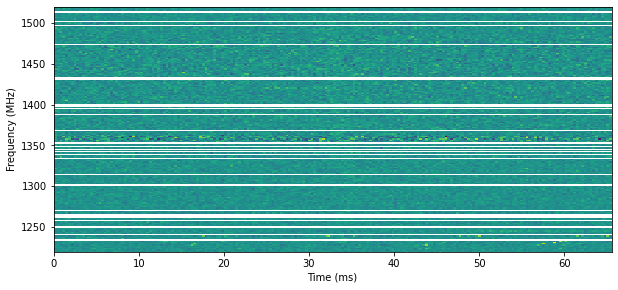

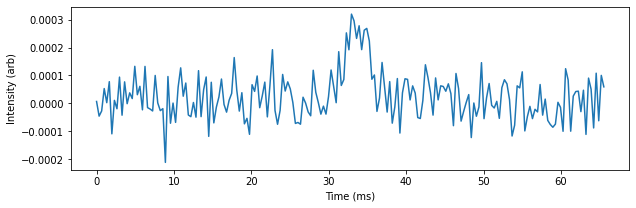

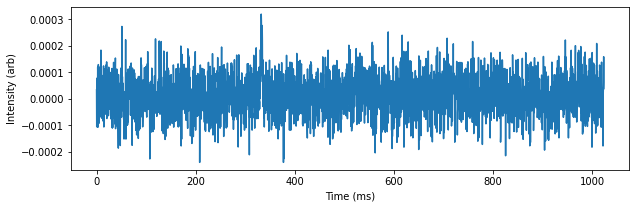

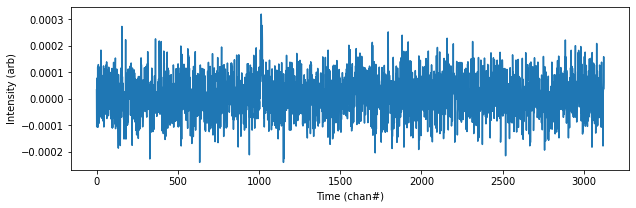

In [53]:
#filename = 'data/oostrum2020/R1_frb121102/R1_B01.rf'
import warnings
warnings.filterwarnings("ignore")
import importlib
from your.utils.rfi import sk_sg_filter
importlib.reload(driftrate)
importlib.reload(driftlaw)
importlib.reload(frbrepeaters)
plt.close('all')

for filename in glob.glob('data/oostrum2020/R1_frb121102/*.rf'):
    if filename != 'data/oostrum2020/R1_frb121102/R1_B30.rf':
        continue

    subfall, pkidx, wfall, burstmetadata = frbrepeaters.loadpsrfits(filename)
    print(wfall.shape)
    subfall = driftrate.subsample(wfall, 192, wfall.shape[1]//4)
    print(f'{subfall.shape = }, {wfall.shape = }')
    width = 100
    burstmetadata['raw_shape'] = subfall.shape # overwrite

    dfs = burstmetadata['dfs']
    df = (dfs[-1] - dfs[0])/subfall.shape[0]
    dt = burstmetadata['duration'] / subfall.shape[1]*1000
    # spectral kurtosis RFI
    sigma = 8
    window = 7
    mask = sk_sg_filter(
        data=subfall.copy().T,
        foff=df,
        tsamp=dt/1000,
        spectral_kurtosis_sigma=sigma,
        savgol_frequency_window=window,
        savgol_sigma=sigma,
    )
    # print(mask.shape, mask)
    print(f"{df = }, {dt/1000 = }")
    subfall = np.ma.array(subfall.copy(), mask=np.zeros(subfall.shape))
    subfall.mask[mask , :] = True
    # print(subfall[0])
    # subfall[mask , :] = 0
    # print(subfall[0])
    # subfall = np.clip(subfall, np.min(subfall), 0.0001)

    # wfall2.mask[mask, :] = True

    fullts = np.nanmean(subfall, axis=0)
    pkidx = np.nanargmax(fullts)
    print(f"{pkidx = }")
    if 'B23' in filename: pkidx = 1570
    
    view = subfall[:, pkidx-width:pkidx+width]
    burstmetadata['duration'] = dt*view.shape[1]/1000 # s
    print(f"{burstmetadata['duration'] = }")
    extents, _ = driftrate.getExtents(view, df=df, dt=dt, lowest_freq=dfs[0])
    ts = np.nanmean(view, axis=0)
    plt.figure(figsize=(10, 4.5))
    plt.xlabel("Time (ms)"); plt.ylabel("Frequency (MHz)")
    plt.imshow(view, origin='lower', interpolation='none', aspect='auto', extent=extents)
    
    plt.figure(figsize=(10, 3))
    plt.plot(np.linspace(extents[0], extents[1], num=len(ts)), ts)
    plt.xlabel("Time (ms)"); plt.ylabel("Intensity (arb)")

    plt.figure(figsize=(10, 3))
    plt.plot(np.linspace(extents[0], len(fullts)*dt, num=len(fullts)), fullts)
    plt.xlabel("Time (ms)"); plt.ylabel("Intensity (arb)")

    plt.figure(figsize=(10, 3))
    plt.plot(range(0, len(fullts)), fullts)
    plt.xlabel("Time (chan#)"); plt.ylabel("Intensity (arb)")

    savename = filename.split('.')[0]
    np.savez(savename, wfall=view, **burstmetadata)
    print('saved', savename)

## Autocorrelation SNR

/mnt/b/dev/frbrepeaters/driftrate.py:224: ComplexWarning: Casting complex values to real discards the imaginary part
  temp_array_a[0:nx,:] = result_shifted[nx-1:2*nx-1,:]
/mnt/b/dev/frbrepeaters/driftrate.py:225: ComplexWarning: Casting complex values to real discards the imaginary part
  temp_array_a[nx:2*nx-1,:] = result_shifted[0:nx-1,:]


amplitude     0.001970
xo            0.463533
yo            1.621118
sigmax        1.206081
sigmay       74.434009
angle         0.012927
Name: R1_B01, dtype: float64
81 176 197 205 8 (255, 399) 2.412161653428492 (-65.536, 65.536, -199.8046875, 199.8046875)
results/FRB121102_oostrum_984rows_Mar01.pdf
plotting R1_B01
plotting R1_B02
plotting R1_B03
plotting R1_B06
plotting R1_B07
plotting R1_B08
plotting R1_B09
plotting R1_B10
plotting R1_B12
plotting R1_B13
plotting R1_B14
plotting R1_B16
plotting R1_B17
plotting R1_B18
plotting R1_B19
plotting R1_B21
plotting R1_B22
plotting R1_B23
plotting R1_B24
plotting R1_B25
plotting R1_B26
plotting R1_B27
plotting R1_B28
plotting R1_B29


True

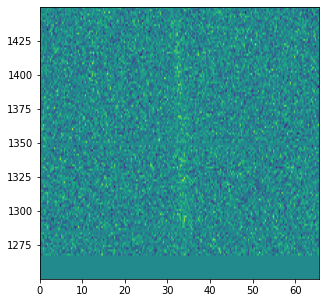

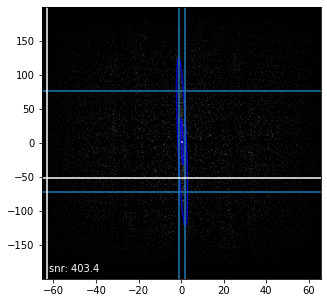

In [2]:
data = np.load('data/oostrum2020/R1_frb121102/R1_B01.npz')
wfall = data['wfall']
# for k in data.iterkeys():
#     print(k, data[k])
# print(f'{wfall.shape = }')

dm = 560.5
wfall[0:11] = 0
wfall[22] = 0
wfall[63] = 0
wfall = driftrate.subtractbg(wfall, 0, 400)
corr = driftrate.autocorr2d(wfall)

tseries = np.nanmean(wfall, axis=0)
# plt.plot(tseries)
oostrumdf = pd.read_csv('results/FRB121102_oostrum_984rows_Mar01.csv').set_index('name')
popt = oostrumdf.loc[(oostrumdf.index == 'R1_B01') & (oostrumdf['DM'] == dm)][['amplitude', 'xo', 'yo', 'sigmax', 'sigmay', 'angle']].iloc[0]
print(popt)
dfs = data['dfs']
df = (dfs[-1] - dfs[0])/wfall.shape[0]
dt = data['duration'] / wfall.shape[1]*1000
lowest_freq = min(data['dfs'])
extents, correxts = driftrate.getExtents(wfall, df=df, dt=dt, lowest_freq=lowest_freq)

figsize = (5,5)
plt.figure(figsize=figsize)
plt.imshow(wfall, origin='lower', aspect='auto', extent=extents)

plt.figure(figsize=figsize)

fitmap = driftrate.makeDataFitmap(popt, corr, correxts)
plt.imshow(corr, origin='lower', aspect='auto', cmap='gray', extent=correxts)
plt.clim(0, np.max(corr)/20)
plt.contour(fitmap, [popt[0]/4, popt[0]*0.9], colors='b', alpha=0.75, origin='lower', extent=correxts)

plt.axvline(x=popt[1]+popt[3])
plt.axvline(x=popt[1]-popt[3])
plt.axhline(y=popt[2]+popt[4])
plt.axhline(y=popt[2]-popt[4])
plt.axvline(x=correxts[0] + 2*popt[3], c='w')
plt.axhline(y=correxts[2] + 2*popt[4], c='w')

popt[1]-popt[3], popt[1]+popt[3], corr.shape, correxts[0], correxts[1]

a = round(np.interp(popt[1]-popt[3], [correxts[0], correxts[1]], [0, corr.shape[1]]))
b = round(np.interp(popt[1]+popt[3], [correxts[0], correxts[1]], [0, corr.shape[1]]))
c = round(np.interp(popt[2]-popt[4], [correxts[2], correxts[3]], [0, corr.shape[0]]))
d = round(np.interp(popt[2]+popt[4], [correxts[2], correxts[3]], [0, corr.shape[0]]))

print(c, d, a, b, b-a, corr.shape, 2*popt[3], correxts)
snr = abs(corr[c:d, a:b].sum() / corr[0:(d-c), 0:(b-a)].sum())
plt.text(correxts[0]*0.95, correxts[2]*0.95, f"snr: {snr:.1f}", color='w')
# plt.figure(figsize=figsize)
# corr[corr > 0.0015]
# corr[np.min(corr), np.max(corr)

import importlib
import warnings
warnings.filterwarnings("ignore")
importlib.reload(driftrate)

# filename = 'results/FRB121102_Li_waittimes_1592rows_Apr08.csv'
# files = glob.glob('/mnt/e/Li2021/samp_wait*/*.npz')
# masks = np.load('li_masks_Apr04.npy', allow_pickle=True)[0]
# mask2 = np.load('li_masks_Apr08.npy', allow_pickle=True)[0]
# masks.update(mask2)
# driftrate.plotResults(filename, datafiles=files, masks=masks)
masks = np.load('oostrummasks_may2_2022.npy', allow_pickle=True)[0]
filename = 'results/FRB121102_oostrum_984rows_Mar01.csv'
files = glob.glob('data/oostrum2020/R1_frb121102/*.npz')
driftrate.plotResults(filename, datafiles=files, masks=masks, clip=100)

# Aggarwal et al. 2021: FRB20121102A 

/tmp/ipykernel_1106/1297685149.py:2: DeprecationWarning: NpzFile.iterkeys is deprecated in python 3, to match the removal of dict.iterkeys. Use .keys() instead.
  for k in data.iterkeys():
/mnt/b/dev/frbrepeaters/driftrate.py:172: ComplexWarning: Casting complex values to real discards the imaginary part
  temp_array_a[0:nx,:] = result_shifted[nx-1:2*nx-1,:]
/mnt/b/dev/frbrepeaters/driftrate.py:173: ComplexWarning: Casting complex values to real discards the imaginary part
  temp_array_a[nx:2*nx-1,:] = result_shifted[0:nx-1,:]


wfall [[-0.00351015 -0.00226763 -0.00471992 ... -0.00086231  0.00134327
  -0.00255637]
 [ 0.00197296 -0.0037088  -0.00012312 ... -0.00125049  0.00123461
  -0.00011136]
 [-0.00114068  0.00203237  0.00212517 ... -0.00094603  0.00064756
   0.00129416]
 ...
 [-0.00066953  0.00211136 -0.00062831 ...  0.00165525  0.00089627
  -0.00267298]
 [ 0.00281152  0.00137407 -0.00065996 ...  0.00042956 -0.00143815
  -0.00155454]
 [ 0.0013647   0.00206079 -0.0023549  ...  0.00470351  0.00048024
  -0.00639009]]
dt [0.512]
dfs [1250.09765625 1250.29296875 1250.48828125 ... 1449.51171875 1449.70703125
 1449.90234375]
DM 560.5
bandwidth 200.0
duration 1.024
center_f 1350.0
freq_unit MHz
time_unit SEC
int_unit Jy
telescope WSRT
burstSN 4.5020024247994055
raw_shape [ 128 3125]
wfall.shape = (128, 160)


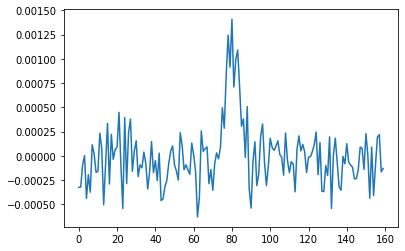

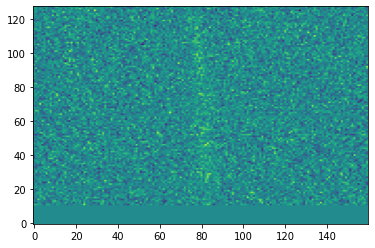

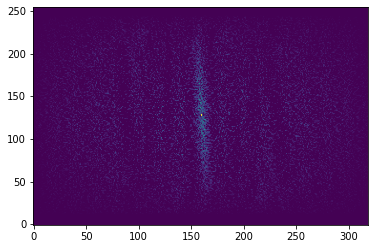

In [12]:
data = np.load('data/oostrum2020/R1_frb121102/R1_B01.npz')
for k in data.iterkeys():
    print(k, data[k])
wfall = data['wfall']
print(f'{wfall.shape = }')
wfall[0:11] = 0
wfall[22] = 0
wfall[63] = 0
wfall = driftrate.subtractbg(wfall, 0, 400)
tseries = np.nanmean(wfall, axis=0)
plt.plot(tseries)
plt.figure()
plt.imshow(wfall, origin='lower', aspect='auto')
plt.figure()
corr = driftrate.autocorr2d(wfall)
plt.imshow(corr, origin='lower', aspect='auto')
plt.clim(0, np.max(corr)/20)

In [234]:
## Replace by dm and burstname so that DM range can be extended
import warnings
df = pd.read_csv("results/FRB121102_aggarwal_1122rows_Feb10.csv").set_index('name')

trialDMs = [555, 556, 560, 560.5]
burstname = 'B011'
newdf = df.iloc[0:4].copy()
# newdf['center_f'].iloc[0:2] = [1000, 1200]
# newdf['DM'].iloc[2:] = [555, 556]
newdf.iloc[0:2, newdf.columns.get_loc("center_f")] = [1000, 1200]
newdf.iloc[2:4, newdf.columns.get_loc("DM")] = [555, 556]

# display(newdf)
# print("before::")
# display(df.loc[burstname])
# df[(df.index == burstname) & (np.round(df['DM'], 4).isin(np.round(trialDMs, 4)))] = newdf.iloc[0:2]
# df.loc['B011']
# df.merge(newdf, how='right')
# print("after::")
df = newdf.append(df).reset_index().drop_duplicates(['name', 'DM']).set_index('name').sort_values(['name', 'DM'])
# display(df.loc[burstname])
resultsdm = df[df.index.str.startswith('B109')]['DM']
dmrange = np.arange(555, 575+0.5, step=0.5)
print(resultsdm)
len(set(dmrange) ^ set(resultsdm))
# df.loc['B109']

name
B109      560.0
B109      560.5
B109      561.0
B109      561.5
B109      562.0
          ...  
B109_b    568.0
B109_b    568.5
B109_b    569.0
B109_b    569.5
B109_b    570.0
Name: DM, Length: 66, dtype: float64


21

## Data space vs channel space Measurements

Data space measurements do not need conversion and so are more stable at large aspect ratios

corrextents = (-65.536, 65.536, -800.0, 800.0)
processBurst args: wfall.shape = (64, 800) df = 12.5 dt = 0.08192 lowest_f = 974.53125
process burst >> -5027.757420185348


/home/mohammed/.local/lib/python3.8/site-packages/pandas/core/arraylike.py:364: RuntimeWarning: invalid value encountered in sqrt
  result = getattr(ufunc, method)(*inputs, **kwargs)


data gauss
data coords: [[-65.536      -65.45397747 -65.37195494 ...  65.37195494  65.45397747
   65.536     ]
 [-65.536      -65.45397747 -65.37195494 ...  65.37195494  65.45397747
   65.536     ]
 [-65.536      -65.45397747 -65.37195494 ...  65.37195494  65.45397747
   65.536     ]
 ...
 [-65.536      -65.45397747 -65.37195494 ...  65.37195494  65.45397747
   65.536     ]
 [-65.536      -65.45397747 -65.37195494 ...  65.37195494  65.45397747
   65.536     ]
 [-65.536      -65.45397747 -65.37195494 ...  65.37195494  65.45397747
   65.536     ]] [[-800.        -800.        -800.        ... -800.        -800.
  -800.       ]
 [-787.3015873 -787.3015873 -787.3015873 ... -787.3015873 -787.3015873
  -787.3015873]
 [-774.6031746 -774.6031746 -774.6031746 ... -774.6031746 -774.6031746
  -774.6031746]
 ...
 [ 774.6031746  774.6031746  774.6031746 ...  774.6031746  774.6031746
   774.6031746]
 [ 787.3015873  787.3015873  787.3015873 ...  787.3015873  787.3015873
   787.3015873]
 [ 800.        

,DM,slope (mhz/ms),slope error (mhz/ms),tau_w_ms,tau_w_ms_old,sigmax,sigmay,t_from_sigma
name,,,,,,,,
B006,562.056,-5027.75742,15.631674,1.452221,0.118966,185.720359,1.452221,1.452221


,DM,slope (mhz/ms),slope error (mhz/ms),tau_w_ms,tau_w_ms_old,sigmax,sigmay,t_from_sigma
name,,,,,,,,
B006_chan,562.056,-10.029071,0.000204,17.705131,1.450404,17.723073,14.610668,-0.958241


data_popt =	2318.8914 0.1232 19.0131 185.7204 1.4522 1.5710 
popt =	2318.8929 800.5017 64.4973 17.7231 14.6107 -6.3488 
slope = -5027.757420185348 slope_err = 15.631674212559954
chan_slope = -10.029070554307381
data_slope = -5027.757420185348
adding popt contour
adding data popt contour


/mnt/b/dev/frbgui/driftrate.py:233: ComplexWarning: Casting complex values to real discards the imaginary part
  temp_array_a[0:nx,:] = result_shifted[nx-1:2*nx-1,:]
/mnt/b/dev/frbgui/driftrate.py:234: ComplexWarning: Casting complex values to real discards the imaginary part
  temp_array_a[nx:2*nx-1,:] = result_shifted[0:nx-1,:]


(-800.0, 800.0)

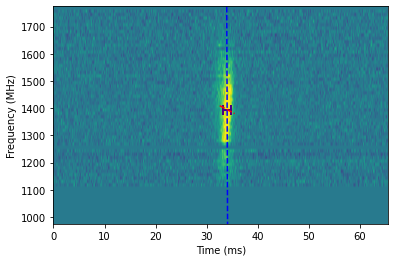

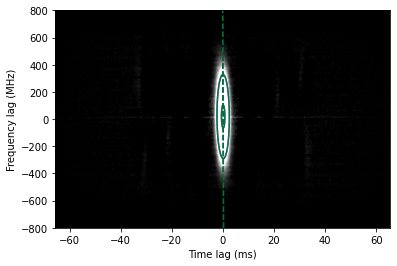

In [76]:
import scipy.optimize
import importlib
importlib.reload(driftrate)
importlib.reload(driftlaw)
data = np.load('data/aggarwal2021/B006.1.npz')
%matplotlib inline

wfall = data['wfall']
# print(f'{wfall.shape = }')
wfall[0:11] = 0
wfall[22] = 0
wfall[63] = 0
ddm = 0
wfall = driftrate.subtractbg(wfall, 0, 100)
# def dedisperse(intensity, DM, nu_low, df_mhz, dt_ms, cshift=0):
wfall = driftrate.dedisperse(wfall, ddm, min(data['dfs']), data['dfs'][1]-data['dfs'][0], data['dt']*1000)
# wfall = driftrate._dedisperse(wfall, 100, burstmetadata['dfs'], data['dt'])
wfall = wfall[:, 200:1000]
downt = 1
wfall = driftrate.subsample(wfall, int(wfall.shape[0]/1), int(wfall.shape[1]/downt))
df = data['bandwidth'] / wfall.shape[0]
dt = data['dt']*1000*downt
lowest_f = min(data['dfs'])
extents, corrextents = driftrate.getExtents(wfall, df=df, dt=dt, lowest_freq=lowest_f)
print(f"{corrextents = }")

## library measurement
print('processBurst args:', f"{wfall.shape = } {df = } {dt = } {lowest_f = }")
measurement = driftrate.processBurst(wfall, df, dt, lowest_f, verbose=False, p0=[])
slope, slope_err, popt, perr, theta, red_chisq, center_f, fitmap = measurement
print('process burst >>', slope)

## channel space measurement
corr = driftrate.autocorr2d(wfall)
autocorr_sigma = np.std( corr[:, 0:50] )
popt, pcov = driftrate.fitgaussiannlsq(corr, p0=[], sigma=autocorr_sigma, bounds=(-np.inf, np.inf))
perr = np.sqrt(np.diag(pcov))
theta = popt[5] if abs(popt[3]) > abs(popt[4]) else popt[5] - np.pi/2 # defined via eqs. A2 and A3
conversion = df / (dt)
chan_slope = conversion * np.tan(theta) # MHz/ms
chan_slope_err = (perr[-1] * (1/np.cos(theta))**2)
fitmap = driftrate.makeFitmap(popt, corr)
center_f = driftrate.findCenter(wfall)[0]*df + lowest_f
chanrow = ['B006_chan'] + [data['DM'], center_f, chan_slope, chan_slope_err, theta, -1] + list(popt) + list(perr) + [df, dt/1000]
results = [chanrow]
chanspace_df = driftrate.exportresults(results)
chanspace_df = driftlaw.computeModelDetails(chanspace_df)

## data space measurement
def getDataCoords(extents, shape):
    x = np.linspace(extents[0], extents[1], num=shape[1])
    y = np.linspace(extents[2], extents[3], num=shape[0])
    x, y = np.meshgrid(x, y)
    return x, y
    
def fitdatagaussiannlsq(data, extents, p0=[], sigma=0, bounds=(-np.inf, np.inf)):
    print('data gauss')
    # use curve-fit (non-linear leastsq)
    # x = range(0, data.shape[1]); y = range(0, data.shape[0])
    x, y = getDataCoords(extents, data.shape)
    print("data coords:", x, y)
    # p0 = driftrate.moments_data(data, extents) if p0 == [] else p0 
    p0 = [1,1,1,1,1,1] if p0 == [] else p0
    sigma = np.zeros(len(data.ravel())) + sigma
    popt, pcov = scipy.optimize.curve_fit(driftrate.twoD_Gaussian, (y, x), data.ravel(), p0=p0, sigma=sigma, absolute_sigma=True, bounds=bounds)
    return popt, pcov

def makeDataFitmap(popt, corr, extents):
    x, y = getDataCoords(extents, corr.shape)
    fitmap = driftrate.twoD_Gaussian((y, x), *popt).reshape(corr.shape[0], corr.shape[1])
    return fitmap

autocorr_sigma = np.std( corr[:, 0:50] )
data_popt, data_pcov = fitdatagaussiannlsq(driftrate.autocorr2d(wfall), corrextents, p0=[], sigma=autocorr_sigma, bounds=(-np.inf, np.inf))
data_perr = np.sqrt(np.diag(data_pcov))
# data_popt = [200, 0, 0, 10, 20, 0]
theta = data_popt[5] if abs(data_popt[3]) > abs(data_popt[4]) else data_popt[5] - np.pi/2 # defined via eqs. A2 and A3
conversion = df / dt
# data_slope = conversion * np.tan(theta) # MHz/ms
data_slope = np.tan(theta) # MHz/ms no conversion needed?
dslope_err = (data_perr[-1] * (1/np.cos(theta))**2)
data_fitmap = makeDataFitmap(data_popt, corr, corrextents)
dcenter_f = driftrate.findCenter(wfall)[0]*df + lowest_f
datarow = ['B006'] + [data['DM'], dcenter_f, data_slope, dslope_err, theta, -1] + list(data_popt) + list(data_perr) + [df, dt/1000]
results = [datarow]
dataspace_df = driftrate.exportresults(results)
dataspace_df = driftlaw.computeModelDetails(dataspace_df)

## results
display(dataspace_df[['DM', 'slope (mhz/ms)', 'slope error (mhz/ms)', 'tau_w_ms', 'tau_w_ms_old', 'sigmax', 'sigmay', 't_from_sigma']])
display(chanspace_df[['DM', 'slope (mhz/ms)', 'slope error (mhz/ms)', 'tau_w_ms', 'tau_w_ms_old', 'sigmax', 'sigmay', 't_from_sigma']])
# print(f"{data_popt = }")
# print(f"{popt = }")
print("data_popt =\t", end = ""); [print(f"{datap:.4f}", end=" ") for datap in data_popt];print()
print("popt =\t", end = ""); [print(f"{datap:.4f}", end=" ") for datap in popt];print()
print(f"{slope = } {slope_err = }")
print(f"{chan_slope = }")
print(f"{data_slope = }")

plt.figure()
plt.xlabel("Time (ms)"); plt.ylabel("Frequency (MHz)")
plt.imshow(wfall, origin='lower', aspect='auto', extent=extents)
# plot burst duration
pkidx = np.nanargmax(np.nanmean(wfall, axis=0))
tw_ms = dataspace_df['tau_w_ms'][0]
# plt.plot([pkidx*dt - tw_ms/2, pkidx*dt + tw_ms/2], [dcenter_f+100]*2, 'k-', linewidth=3)
plt.errorbar(pkidx*dt, dcenter_f, xerr=tw_ms/2, color='#4b0082', linewidth=2, capthick=2, capsize=5, fmt='none')
xo = pkidx*dt
x = np.array([xo - tw_ms, xo + tw_ms])
# plt.plot(x, data_slope*x + dcenter_f - data_slope*xo, 'b--', lw=1.5)
plt.plot(x, data_slope*(x - xo) + dcenter_f, 'b--', lw=1.5)
plt.plot(x, chan_slope*(x - xo) + center_f, 'r--', lw=1.5)
plt.xlim(extents[:2])
plt.ylim(extents[2:])

plt.figure()
corr = driftrate.autocorr2d(wfall)
plt.xlabel("Time lag (ms)"); plt.ylabel("Frequency lag (MHz)")
plt.imshow(corr, origin='lower', aspect='auto', cmap='gray', extent=corrextents)
plt.clim(0, np.max(corr)/20)

if popt[0] > 0:
    print("adding popt contour")
    plt.contour(fitmap, [popt[0]/4, popt[0]*0.9], colors='b', alpha=0.75, extent=corrextents)
    xo = (popt[1]-fitmap.shape[1]/2)*dt
    x = np.array([corrextents[2] / slope + xo, corrextents[3] / slope + xo])
    plt.plot(x, slope*(x-xo), 'b--')
if data_popt[0] > 0:
    print("adding data popt contour")
    plt.contour(data_fitmap, [data_popt[0]/4, data_popt[0]*0.9], colors='g', alpha=0.75, extent=corrextents)
    xo = data_popt[1]
    x = np.array([corrextents[2] / data_slope + xo, corrextents[3] / data_slope + xo])
    plt.plot(x, data_slope*(x-xo), 'g--')

plt.xlim(corrextents[:2])
plt.ylim(corrextents[2:])

## Prep Bursts

In [5]:
from your.utils.plotter import save_bandpass
from burstfit.data import BurstData
from burstfit.utils.plotter import plot_me
import your

def padlabel(s):
    if '.' in s:
        s = f"B{s.split('B')[1].split('.')[0]:0>3}.{s.split('.')[1]}"
    else:
        s = f"B{s.split('B')[1].split('.')[0]:0>3}"
    return s

files = [
    '/mnt/b/dev/frbgui/SurveyFRB20121102A/data/aggarwal2021/hyrule/data/users/dagarwal/KG_FRB121102/puppi_57644_C0531+33_0021_subs_0001/puppi_57644_C0531+33_0021_subs_0001.fil',
    '/mnt/b/dev/frbgui/SurveyFRB20121102A/data/aggarwal2021/hyrule/data/users/dagarwal/KG_FRB121102/puppi_57645_C0531+33_0029_subs_0001/puppi_57645_C0531+33_0029_subs_0001.fil'
]

canddf = pd.read_csv('../../FRB121102/data/all_bursts_bary.csv')

yourdata = your.Your(files[1])
datameta = yourdata.your_header
print(yourdata.your_header)

canddf['tstart'] = [float(candid.split('_')[2]) for candid in canddf['cand_id']]
canddf['tcand']  = [float(candid.split('_')[4]) for candid in canddf['cand_id']]
canddf['dm']     = [float(candid.split('_')[6]) for candid in canddf['cand_id']]
canddf['snr']    = [float(candid.split('_')[8]) for candid in canddf['cand_id']]
canddf['label']  = canddf['bidx']
canddf['width']  = 256
canddf['num_files']  = 1
canddf['chan_mask_path']  = 'mask.txt'
canddf['file']   = [files[0] if '57644' in str(tstart) else files[1] for tstart in canddf['tstart']]
canddf = canddf.set_index('label')

wfall = None 
time_window = 0.1
for bid, row in canddf.iterrows():
    print(bid, 'DM:', row['dm'], 'SNR:', row['snr'])
    bd = BurstData(  # fclean_21
        fp=row['file'],
        dm=row['dm'],
        width=row['width'],
        snr=row['snr'],
        tcand=row['tcand'],
    )
    bd.prepare_data(time_window=time_window)#, mask_chans=[(0,3), (40,42),(52,64)])
    plot_me(bd.sgram)    
    wfall = np.flipud(bd.sgram.astype(np.float64).copy())
    # print(datameta.tsamp, type(datameta.tsamp))
    # print(f"{datameta.bw = }")
    continue
    burstmetadata = {
        'dt'        : datameta.tsamp,
        'dfs'       : np.linspace(datameta.fch1-abs(datameta.bw), datameta.fch1, num=datameta.nchans),
        'DM'        : row['dm'],
        'bandwidth' : abs(datameta.bw),
        'duration'  : time_window, 
        'center_f'  : datameta.center_freq,
        'freq_unit' : 'MHz',
        'time_unit' : 's',
        'int_unit'  : 'arb',
        'telescope' : 'Arecibo',
        'burstSN'   : row['snr'],
        'raw_shape' : wfall.shape
    }

    bid = padlabel(bid) # for better filesystem sorting
    wfallout = f'data/aggarwal2021/{bid}.npz'
    # np.savez(wfallout, wfall=wfall, **burstmetadata)
    print('saved', wfallout)


Unified Header:
  "basename": "puppi_57645_C0531+33_0029_subs_0001"
  "bw": -800.0
  "center_freq": 1380.78125
  "dec_deg": 33.14711122222222
  "dtype": "uint8"
  "fch1": 1774.53125
  "filelist": [
    "/mnt/b/dev/frbgui/SurveyFRB20121102A/data/aggarwal2021/hyrule/data/users/dagarwal/KG_FRB121102/puppi_57645_C0531+33_0029_subs_0001/puppi_57645_C0531+33_0029_subs_0001.fil"
  ]
  "filename": "/mnt/b/dev/frbgui/SurveyFRB20121102A/data/aggarwal2021/hyrule/data/users/dagarwal/KG_FRB121102/puppi_57645_C0531+33_0029_subs_0001/puppi_57645_C0531+33_0029_subs_0001.fil"
  "foff": -12.5
  "format": "fil"
  "frequency_decimation_factor": 1
  "gb": -0.22260846394980455
  "gl": -5.119968059432011
  "native_foff": -12.5
  "native_nbits": 8
  "native_nchans": 64
  "native_nspectra": 67692032.0
  "native_tsamp": 8.192e-05
  "nbits": 8
  "nchans": 64
  "npol": 1
  "nspectra": 67692032
  "poln_order": "I"
  "ra_deg": 82.99416666666666
  "source_name": "C0531+33"
  "time_decimation_factor": 1
  "tsamp": 8.

/mnt/b/dev/burstfit/burstfit/utils/plotter.py:302: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  return plt.show()


datameta.bw = -800.0
B2 DM: 562.056 SNR: 6.36612


/mnt/b/dev/burstfit/burstfit/utils/plotter.py:302: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  return plt.show()


datameta.bw = -800.0
B3.1 DM: 568.562 SNR: 8.73822


/mnt/b/dev/burstfit/burstfit/utils/plotter.py:302: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  return plt.show()


datameta.bw = -800.0
B3.2 DM: 568.562 SNR: 8.73822


/mnt/b/dev/burstfit/burstfit/utils/plotter.py:302: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  return plt.show()


datameta.bw = -800.0
B4 DM: 565.3 SNR: 6.50775


/mnt/b/dev/burstfit/burstfit/utils/plotter.py:302: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  return plt.show()


datameta.bw = -800.0
B5 DM: 562.056 SNR: 6.82033


/mnt/b/dev/burstfit/burstfit/utils/plotter.py:302: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  return plt.show()


datameta.bw = -800.0
B6.1 DM: 562.056 SNR: 97.1239


/mnt/b/dev/burstfit/burstfit/utils/plotter.py:302: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  return plt.show()


datameta.bw = -800.0
B6.2 DM: 562.056 SNR: 97.1239


/mnt/b/dev/burstfit/burstfit/utils/plotter.py:302: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  return plt.show()


datameta.bw = -800.0
B7.1 DM: 605.713 SNR: 8.36633


/mnt/b/dev/burstfit/burstfit/utils/plotter.py:302: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  return plt.show()


datameta.bw = -800.0
B7.2 DM: 605.713 SNR: 8.36633


/mnt/b/dev/burstfit/burstfit/utils/plotter.py:302: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  return plt.show()


datameta.bw = -800.0
B8 DM: 568.562 SNR: 7.65924


/mnt/b/dev/burstfit/burstfit/utils/plotter.py:302: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  return plt.show()


datameta.bw = -800.0
B9 DM: 562.056 SNR: 6.35508


/mnt/b/dev/burstfit/burstfit/utils/plotter.py:302: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  return plt.show()


datameta.bw = -800.0
B10 DM: 565.3 SNR: 6.45913


/mnt/b/dev/burstfit/burstfit/utils/plotter.py:302: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  return plt.show()


datameta.bw = -800.0
B11 DM: 562.056 SNR: 8.38639


/mnt/b/dev/burstfit/burstfit/utils/plotter.py:302: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  return plt.show()


datameta.bw = -800.0
B12 DM: 555.625 SNR: 6.78833


/mnt/b/dev/burstfit/burstfit/utils/plotter.py:302: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  return plt.show()


datameta.bw = -800.0
B13 DM: 571.843 SNR: 9.70367


/mnt/b/dev/burstfit/burstfit/utils/plotter.py:302: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  return plt.show()


datameta.bw = -800.0
B14 DM: 565.0 SNR: 6.0


/mnt/b/dev/burstfit/burstfit/utils/plotter.py:302: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  return plt.show()


datameta.bw = -800.0
B15.1 DM: 571.843 SNR: 9.83474


/mnt/b/dev/burstfit/burstfit/utils/plotter.py:302: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  return plt.show()


datameta.bw = -800.0
B15.2 DM: 571.843 SNR: 9.83474


/mnt/b/dev/burstfit/burstfit/utils/plotter.py:302: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  return plt.show()


datameta.bw = -800.0
B16 DM: 565.3 SNR: 9.8


/mnt/b/dev/burstfit/burstfit/utils/plotter.py:302: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  return plt.show()


datameta.bw = -800.0
B17 DM: 568.562 SNR: 7.00356


/mnt/b/dev/burstfit/burstfit/utils/plotter.py:302: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  return plt.show()


datameta.bw = -800.0
B18 DM: 568.562 SNR: 7.26308


/mnt/b/dev/burstfit/burstfit/utils/plotter.py:302: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  return plt.show()


datameta.bw = -800.0
B19 DM: 558.831 SNR: 6.08731


/mnt/b/dev/burstfit/burstfit/utils/plotter.py:302: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  return plt.show()


datameta.bw = -800.0
B20 DM: 565.3 SNR: 7.42329


/mnt/b/dev/burstfit/burstfit/utils/plotter.py:302: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  return plt.show()


datameta.bw = -800.0
B21 DM: 486.748 SNR: 6.68708


/mnt/b/dev/burstfit/burstfit/utils/plotter.py:302: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  return plt.show()


datameta.bw = -800.0
B22 DM: 565.3 SNR: 8.49012


/mnt/b/dev/burstfit/burstfit/utils/plotter.py:302: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  return plt.show()


datameta.bw = -800.0
B23 DM: 565.3 SNR: 8.9189


/mnt/b/dev/burstfit/burstfit/utils/plotter.py:302: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  return plt.show()


datameta.bw = -800.0
B24 DM: 562.056 SNR: 7.12105


/mnt/b/dev/burstfit/burstfit/utils/plotter.py:302: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  return plt.show()


datameta.bw = -800.0
B25 DM: 568.562 SNR: 10.0596


/mnt/b/dev/burstfit/burstfit/utils/plotter.py:302: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  return plt.show()


datameta.bw = -800.0
B26 DM: 565.3 SNR: 10.3316


/mnt/b/dev/burstfit/burstfit/utils/plotter.py:302: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  return plt.show()


datameta.bw = -800.0
B27 DM: 571.843 SNR: 6.76876


/mnt/b/dev/burstfit/burstfit/utils/plotter.py:302: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  return plt.show()


datameta.bw = -800.0
B28 DM: 558.831 SNR: 10.484


/mnt/b/dev/burstfit/burstfit/utils/plotter.py:302: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  return plt.show()


datameta.bw = -800.0
B29 DM: 552.437 SNR: 6.90756


/mnt/b/dev/burstfit/burstfit/utils/plotter.py:302: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  return plt.show()


datameta.bw = -800.0
B30 DM: 562.056 SNR: 7.1107


/mnt/b/dev/burstfit/burstfit/utils/plotter.py:302: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  return plt.show()


datameta.bw = -800.0
B31 DM: 568.562 SNR: 16.4884


KeyboardInterrupt: 

## B7.1

Unified Header:
  "basename": "puppi_57645_C0531+33_0029_subs_0001"
  "bw": -800.0
  "center_freq": 1380.78125
  "dec_deg": 33.14711122222222
  "dtype": "uint8"
  "fch1": 1774.53125
  "filelist": [
    "/mnt/b/dev/frbrepeaters/data/aggarwal2021/hyrule/data/users/dagarwal/KG_FRB121102/puppi_57645_C0531+33_0029_subs_0001/puppi_57645_C0531+33_0029_subs_0001.fil"
  ]
  "filename": "/mnt/b/dev/frbrepeaters/data/aggarwal2021/hyrule/data/users/dagarwal/KG_FRB121102/puppi_57645_C0531+33_0029_subs_0001/puppi_57645_C0531+33_0029_subs_0001.fil"
  "foff": -12.5
  "format": "fil"
  "frequency_decimation_factor": 1
  "gb": -0.22260846394980455
  "gl": -5.119968059432011
  "native_foff": -12.5
  "native_nbits": 8
  "native_nchans": 64
  "native_nspectra": 67692032.0
  "native_tsamp": 8.192e-05
  "nbits": 8
  "nchans": 64
  "npol": 1
  "nspectra": 67692032
  "poln_order": "I"
  "ra_deg": 82.99416666666666
  "source_name": "C0531+33"
  "time_decimation_factor": 1
  "tsamp": 8.192e-05
  "tstart": 57645.

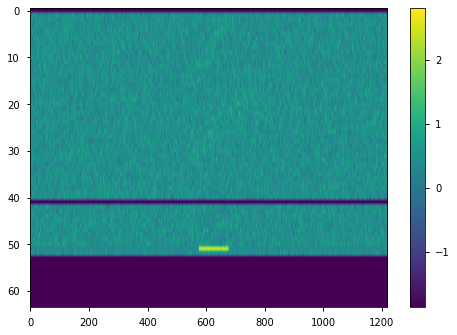

In [61]:
from your.utils.plotter import save_bandpass
from burstfit.data import BurstData
from burstfit.utils.plotter import plot_me
import your

def padlabel(s):
    if '.' in s:
        s = f"B{s.split('B')[1].split('.')[0]:0>3}.{s.split('.')[1]}"
    else:
        s = f"B{s.split('B')[1].split('.')[0]:0>3}"
    return s

files = [
    '/mnt/b/dev/frbrepeaters/data/aggarwal2021/hyrule/data/users/dagarwal/KG_FRB121102/puppi_57644_C0531+33_0021_subs_0001/puppi_57644_C0531+33_0021_subs_0001.fil',
    '/mnt/b/dev/frbrepeaters/data/aggarwal2021/hyrule/data/users/dagarwal/KG_FRB121102/puppi_57645_C0531+33_0029_subs_0001/puppi_57645_C0531+33_0029_subs_0001.fil'
]

canddf = pd.read_csv('../FRB121102/data/all_bursts_bary.csv')

yourdata = your.Your(files[1])
datameta = yourdata.your_header
print(yourdata.your_header)

canddf['tstart'] = [float(candid.split('_')[2]) for candid in canddf['cand_id']]
canddf['tcand']  = [float(candid.split('_')[4]) for candid in canddf['cand_id']]
canddf['dm']     = [float(candid.split('_')[6]) for candid in canddf['cand_id']]
canddf['snr']    = [float(candid.split('_')[8]) for candid in canddf['cand_id']]
canddf['label']  = canddf['bidx']
canddf['width']  = 256
canddf['num_files']  = 1
canddf['chan_mask_path']  = 'mask.txt'
canddf['file']   = [files[0] if '57644' in str(tstart) else files[1] for tstart in canddf['tstart']]
canddf = canddf.set_index('label')

wfall = None
time_window = 0.1
for bid, row in canddf.iterrows():
    if bid != 'B7.1':
        continue
    print(bid, 'DM:', row['dm'], 'SNR:', row['snr'])
    bd = BurstData(  # fclean_21
        fp=row['file'],
        dm=row['dm'],
        width=row['width'],
        snr=row['snr'],
        tcand=row['tcand'],
    )
    bd.prepare_data(time_window=time_window)#, mask_chans=[(0,3), (40,42),(52,64)])
    plot_me(bd.sgram)    
    wfall = np.flipud(bd.sgram.astype(np.float64).copy())
    wfall = wfall[...,wfall.shape[1]//2:]
    print(datameta.tsamp, type(datameta.tsamp))
    burstmetadata = {
        'dt'        : datameta.tsamp,
        'dfs'       : np.linspace(datameta.fch1-abs(datameta.bw), datameta.fch1, num=datameta.nchans),
        'DM'        : row['dm'],
        'bandwidth' : abs(datameta.bw),
        'duration'  : time_window*0.5, 
        'center_f'  : datameta.center_freq,
        'freq_unit' : 'MHz',
        'time_unit' : 's',
        'int_unit'  : 'arb',
        'telescope' : 'Arecibo',
        'burstSN'   : row['snr'],
        'raw_shape' : wfall.shape
    }

    bid = padlabel(bid) # for better filesystem sorting
    wfallout = f'data/aggarwal2021/{bid}.npz'
    np.savez(wfallout, wfall=wfall, **burstmetadata)
    print('saved', wfallout)


In [37]:
a, b, c = min(df.loc[df.index[0]]['DM']), max(df.loc[df.index[0]]['DM']), len(df.loc[df.index[0]]['DM'])-2
print(list(df.loc[df.index[0]]['DM']))
step = round((b-a)/c, 3)
print(a, b, c+1, step)

np.arange(a, b+step, step=step)
# gdata['trialDMs'] = np.arange(dmrange[0], dmrange[1]+dmstep, step=dmstep)


[560.0, 560.5, 561.0, 561.5, 562.0, 562.056, 562.5, 563.0, 563.5, 564.0, 564.5, 565.0, 565.5, 566.0, 566.5, 567.0, 567.5, 568.0, 568.5, 569.0, 569.5, 570.0]
560.0 570.0 21 0.5


array([560. , 560.5, 561. , 561.5, 562. , 562.5, 563. , 563.5, 564. ,
       564.5, 565. , 565.5, 566. , 566.5, 567. , 567.5, 568. , 568.5,
       569. , 569.5, 570. ])

## Plot Results

In [1]:
import os, glob, itertools
import numpy as np
import matplotlib.pyplot as plt
import pypulse, your
import driftrate, driftlaw
import frbrepeaters
import pandas as pd
import importlib, warnings
importlib.reload(driftrate)
warnings.filterwarnings('ignore')
%matplotlib inline

# files = glob.glob('data/gajjar2018/*.npz')
files = glob.glob('data/aggarwal2021/*.npz')
masks = np.load('aggarwalmasks_Jun17_2022.npy', allow_pickle=True)[0]
filename = 'results/FRB121102_aggarwal_4785rows_Jun17.csv'
# filename = 'Test_results_6rows_Jan18.csv'
# filenames = ['TestB006AngleTrend_results_63rows_Nov12.csv', 'TestB006AngleTrend_64x305_results_63rows_Nov12.csv', 'TestB006AngleTrend_64x610_results_63rows_Nov13.csv']
# for filename in filenames:
driftrate.plotResults(filename, datafiles=files, masks=masks)

# resultsdf = pd.read_csv(filename).set_index('name')
# dmframe = resultsdf.set_index('DM')


results/FRB121102_aggarwal_4785rows_Jun17.pdf
plotting B001
plotting B003
plotting B003_a
plotting B003_b
plotting B004
plotting B005
plotting B006
plotting B008
plotting B011
plotting B013
plotting B016
plotting B020
plotting B022
plotting B023
plotting B024
plotting B025
plotting B026
plotting B028
plotting B029
plotting B030
plotting B031
plotting B032
plotting B032_a
plotting B032_b
plotting B033
plotting B035
plotting B037
plotting B038
plotting B039
plotting B041
plotting B042
plotting B043
plotting B045
plotting B046
plotting B047
plotting B048
plotting B048_a
plotting B048_b
plotting B049
plotting B050
plotting B051
plotting B052
plotting B055
plotting B056
plotting B057
plotting B058
plotting B059
plotting B060
plotting B060_a
plotting B060_b
plotting B062
plotting B063
plotting B064
plotting B066
plotting B067
plotting B068
plotting B069
plotting B070
plotting B071
plotting B071_a
plotting B071_b
plotting B075
plotting B076
plotting B077
plotting B078
plotting B079
plotting B

True

## B006: Slope vs DM

In [46]:
%matplotlib qt

coarsedf = pd.read_csv('results/FRB121102_aggarwal_4785rows_Jul07.csv').set_index('name').loc['B006']
finedf = pd.read_csv('results/B006fine_203rows_Dec22.csv').set_index('name')
coarsedf = coarsedf.loc[coarsedf['slope (mhz/ms)'] < 0]
finedf = finedf.loc[finedf['slope (mhz/ms)'] < 0]


ax = finedf.plot.line('DM', 'slope (mhz/ms)', c='b', marker='.', label='Fine')
coarsedf.plot.line('DM', 'slope (mhz/ms)', ax=ax, c='k', marker='.', label='Coarse')
ax.legend()
ax.set_xlabel("DM"); ax.set_ylabel("Slope (MHz/ms)")
ax.set_title("Burst B006")

Text(0.5, 1.0, 'Burst B006')

# Gajjar et al. 2018: FRB20121102A 

In [9]:
0.18310546875*8

1.46484375

Loading: data/gajjar2018/11A_16sec.calib.4p
Load time: 4.83 s
done loading
DM 557.91
{'dt': array([0.01048303]), 'dfs': array([5373.5351125 , 5375.00082353, 5376.46653457, ..., 7846.18962793,
       7847.65533897, 7849.12105   ]), 'DM': 557.91, 'bandwidth': 2475.5859375, 'duration': 0.020966058666666648, 'center_f': 6407.7148, 'freq_unit': 'MHz', 'time_unit': 'SEC', 'int_unit': 'Jy', 'telescope': 'GBT', 'burstSN': 7.9028664, 'tbin': 1.0239731655700501e-05}
df = 1.46484375, dt = 0.010237333333333324, burstmetadata['bandwidth'] = 2475.5859375, duration = 20.966058666666648, lowest_freq = 5373.5351125
burstmetadata['dfs'] = array([5373.5351125 , 5375.00082353, 5376.46653457, ..., 7846.18962793,
       7847.65533897, 7849.12105   ])
subfall.shape=(1690, 2048), wfall.shape=(19456, 2048)
>>> 16.86390532544379
(0, 20.966058666666648, 5373.5351125, 7849.12105)
saved data/gajjar2018/11A.npz
Loading: data/gajjar2018/11B_263sec.calib.4p
Load time: 4.64 s
done loading
DM 587.0
{'dt': array([0.0104

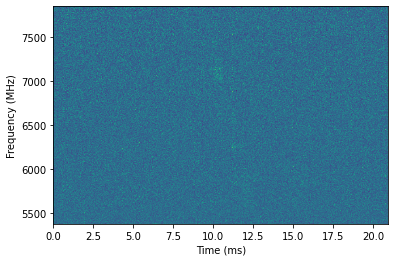

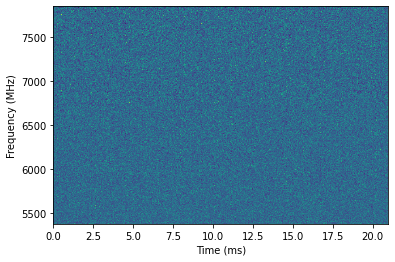

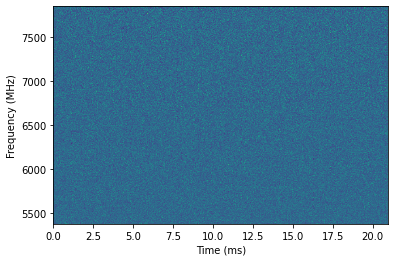

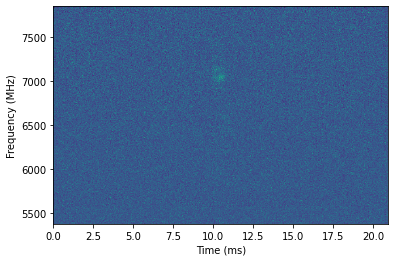

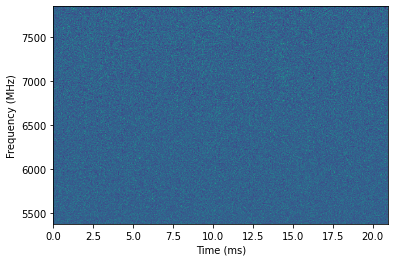

...

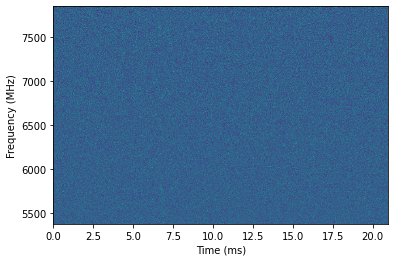

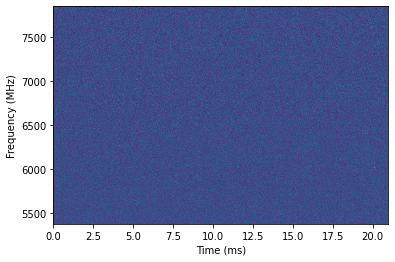

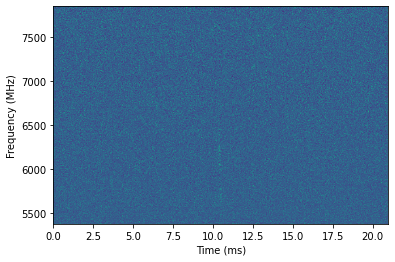

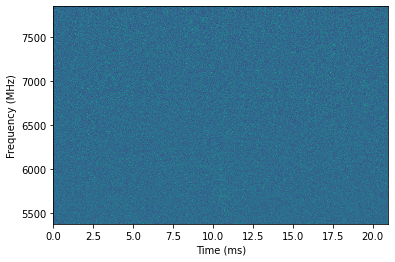

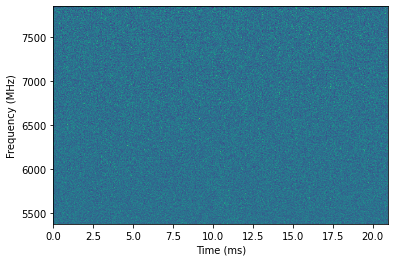

In [39]:
import importlib
importlib.reload(driftrate)
importlib.reload(frbrepeaters)
for filename in glob.glob('data/gajjar2018/*.4p'):
    # if '11A' not in filename:
    #     continue
    if 'fits' in filename:# or '12B' in filename:
        continue
    _, _, origwfall, burstmetadata = frbrepeaters.loadpsrfits(filename, dedisperse=False)
    origwfall[1053:1110, ...] = 0
    origwfall[15360:15471, ...] = 0
    origwfall = np.flipud(origwfall)
    print('DM', burstmetadata['DM'])

    wfall = origwfall.copy()
    lowest_freq = min(burstmetadata['dfs'])
    df = burstmetadata['dfs'][0]-burstmetadata['dfs'][1]
    dt = burstmetadata['duration']/wfall.shape[1]*1000
    burstmetadata['bandwidth'] = abs(burstmetadata['bandwidth'])
    burstmetadata['dfs'].sort()
    duration = dt*wfall.shape[1]

    subfall = driftrate.subsample(wfall, 2432, 2048)
    # match with paper 1
    burstmetadata['bandwidth'] = burstmetadata['bandwidth']*((subfall.shape[0] - ((subfall.shape[0]-2200)+510))/subfall.shape[0])
    lowest_freq = burstmetadata['center_f'] - subfall.shape[0]/2*(df*(19456/2432)) + (df*(19456/2432))*510
    subfall = subfall[510:2200, ...] 
    df = burstmetadata['bandwidth']/subfall.shape[0]
    burstmetadata['dfs'] = np.linspace(lowest_freq, lowest_freq+burstmetadata['bandwidth'], num=subfall.shape[0])
    print(burstmetadata)
    
    print(f"{df = }, {dt = }, {burstmetadata['bandwidth'] = }, {duration = }, {lowest_freq = }")
    print(f"{burstmetadata['dfs'] = }")
    print(f'{subfall.shape=}, {wfall.shape=}')
    # subfall = driftrate.subtractbg(subfall, 0, 20)
    fulltseries = np.nanmean(wfall, axis=0)
    tseries = np.nanmean(subfall, axis=0)
    pkidx = np.nanargmax(tseries)

    view = subfall
    print(">>>", df/(view.shape[0]/wfall.shape[0]))
    extents, correxts = driftrate.getExtents(subfall, df=df, dt=dt/(view.shape[1]/wfall.shape[1]), lowest_freq=lowest_freq)
    plt.figure()
    plt.imshow(view, origin='lower', aspect='auto', extent=extents, interpolation='none'); plt.xlabel('Time (ms)'); plt.ylabel('Frequency (MHz)')
    print(extents)
    
    bid = filename.split('/')[-1].split('_')[0]
    wfallout = f'data/gajjar2018/{bid}.npz'
    np.savez(wfallout, wfall=view, **burstmetadata)
    print('saved', wfallout)


In [122]:
ret = np.load('burstregions_gajjaroct1.npy', allow_pickle=True)
print(ret[0])
## example
# {
#   "11A": {
#       "a": [2.4,2.8],
#       "b": [2.8,3.3],
#       "c": [3.3,4.1],
#       "d": [4.1,5.6],
#       "background": [0.0,1.6]
#   },
#   "12A": {
#       "a": [0.7,1.3],
#       "b": [1.3,3.3],
#       "background": [0.0, 0.7]
#   }
# }
resultsdf = pd.read_csv('results/FRB121102_aggarwal_1122rows_Feb02.csv').set_index('name')
driftrate.readRegions(resultsdf)

{'11A': {'a': [2.4049999713897705, 2.880000114440918], 'b': [2.880000114440918, 3.384000062942505], 'c': [3.384000062942505, 4.156000137329102], 'd': [4.156000137329102, 5.640999794006348], 'background': [0.0, 1.6619999408721924]}, '12A': {'a': [0.7770000100135803, 1.343999981880188], 'b': [1.343999981880188, 3.384000062942505], 'background': [0.0, 0.753000020980835]}}


{'B093': {'background': 18.0979995727539,
  'a': [0.0, 24.5900001525879],
  'b': [24.5900001525879, 39.3442611694336]},
 'B121': {'background': 9.2209997177124,
  'a': [0.0, 9.2209997177124],
  'b': [9.2209997177124, 15.6149997711182],
  'c': [15.6149997711182, 24.590164184570305]},
 'B109': {'background': 38.0050010681152,
  'a': [0.0, 47.015998840332],
  'b': [47.015998840332, 78.36065673828129]}}

{'11A': {'a': [2.4049999713897705, 2.880000114440918], 'b': [2.880000114440918, 3.384000062942505], 'c': [3.384000062942505, 4.156000137329102], 'd': [4.156000137329102, 5.640999794006348], 'background': [0.0, 1.6619999408721924]}, '12A': {'a': [0.7770000100135803, 1.343999981880188], 'b': [1.343999981880188, 3.384000062942505], 'background': [0.0, 0.753000020980835]}}
plotting 11A


/mnt/b/dev/frbrepeaters/driftrate.py:190: ComplexWarning: Casting complex values to real discards the imaginary part
  temp_array_a[0:nx,:] = result_shifted[nx-1:2*nx-1,:]
/mnt/b/dev/frbrepeaters/driftrate.py:191: ComplexWarning: Casting complex values to real discards the imaginary part
  temp_array_a[nx:2*nx-1,:] = result_shifted[0:nx-1,:]


plotting 11A
plotting 11A
plotting 11A
plotting 11A
plotting 11A
plotting 11A
plotting 11A
plotting 11A
plotting 11A
plotting 11A
plotting 11A
plotting 11A
plotting 11A
plotting 11A
plotting 11A
plotting 11A
plotting 11A
plotting 11A
plotting 11A
plotting 11A
plotting 11A
plotting 11A_a
plotting 11A_a
plotting 11A_a
plotting 11A_a
plotting 11A_a
plotting 11A_a
plotting 11A_a
plotting 11A_a
plotting 11A_a
plotting 11A_a
plotting 11A_a
plotting 11A_a
plotting 11A_a
plotting 11A_a
plotting 11A_a
plotting 11A_a
plotting 11A_a
plotting 11A_a
plotting 11A_a
plotting 11A_a
plotting 11A_a
plotting 11A_a
plotting 11A_b
plotting 11A_b
plotting 11A_b
plotting 11A_b
plotting 11A_b
plotting 11A_b
plotting 11A_b
plotting 11A_b
plotting 11A_b
plotting 11A_b
plotting 11A_b
plotting 11A_b
plotting 11A_b
plotting 11A_b
plotting 11A_b
plotting 11A_b
plotting 11A_b
plotting 11A_b
plotting 11A_b
plotting 11A_b
plotting 11A_b
plotting 11A_b
plotting 11A_c
plotting 11A_c
plotting 11A_c
plotting 11A_c
plottin

True

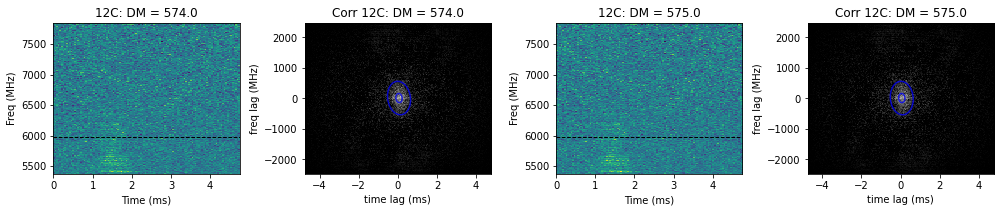

In [7]:
import importlib
importlib.reload(driftrate)

regionsfile = np.load('burstregions_gajjaroct1.npy', allow_pickle=True)[0]
print(regionsfile)
files = glob.glob('data/gajjar2018/*.npz')
masks = None
# regionsfile = 'burstregions_gajjaroct1.npy'
filename = 'GajjarFRB121102_results_506rows_Oct19.csv'
resultsdf = pd.read_csv(filename).set_index('name')
driftrate.plotResults(filename, datafiles=files)
# for name, row in resultsdf.iterrows():
#     print(name)
#     if '_' in name:
#         regcols = [col for col in row.index if 'reg' in col]
#         regcols.append('background') if 'background' in row.index else None
#         subname = '11A_a'
#         [print(col, row[col]) for col in regcols]
#         key = regcols[0].split('_')[-1]
#         print(key, row[f'regstart_{key}'], row[f'regend_{key}'])
#         regions = {'11A': {key: [row[f'regstart_{key}'], row[f'regend_{key}']]}}
#         print(regions)
# list(regionsfile['11A'].keys())[:-1]

## .fits Bursts

data/gajjar2018/11L_841sec_tot.fits
Loading: data/gajjar2018/11L_841sec_tot.fits
Load time: 0.21 s
32.2265625 0.3588059999999995 4063.96484375
(128, 4096) (128, 4096)
data/gajjar2018/11P_1257sec_tot.fits
Loading: data/gajjar2018/11P_1257sec_tot.fits
Load time: 0.09 s
8.056640625 1.435143999999998 4055.442116477273
(512, 1024) (512, 1024)


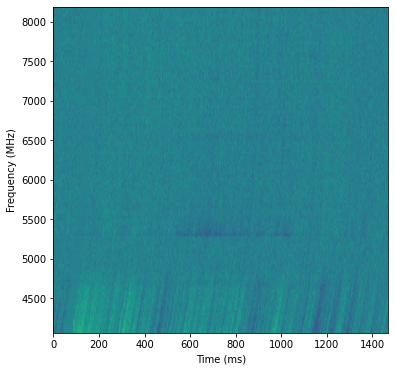

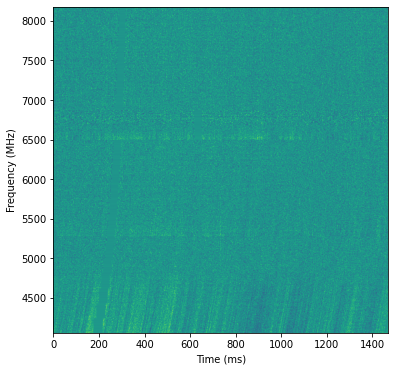

In [47]:
for filename in glob.glob('data/gajjar2018/*.fits'):
    print(filename)
    ar = pypulse.Archive(filename, prepare=False)
    ar.pscrunch()
    ar.center()

    wfall, subfall = ar.getData(), None
    wfall = np.flipud(wfall)
    # wfall = driftrate.subtractbg(wfall, 0, 200)
    # wfall = driftrate.subsample(wfall, 128, wfall.shape[1]//8)
    
    burstmetadata = {
        'dt'        : ar.getTimes(),
        'dfs'       : ar.getFreqs(),
        'DM'        : ar.getDM(),
        'bandwidth' : -ar.getBandwidth(),
        'duration'  : ar.getDuration(), # usually in seconds
        'center_f'  : ar.getCenterFrequency(),
        'freq_unit' : ar.getFrequencyUnit(),
        'time_unit' : ar.getTimeUnit(),
        'int_unit'  : ar.getIntensityUnit(),
        'telescope' : ar.getTelescope(),
        'burstSN'   : ar.getSN(),
        'tbin'      : ar.getTbin(),
    }
    
    df = burstmetadata['bandwidth'] / wfall.shape[0]
    dt = burstmetadata['duration'] / wfall.shape[1]*1000
    lowest_freq = burstmetadata['center_f'] - burstmetadata['bandwidth']/2
    print(df, dt, lowest_freq)
    # view = driftrate.cropwfall(wfall, twidth=50)
    view = wfall
    print(wfall.shape, view.shape)
    extents, _ = driftrate.getExtents(view, df, dt, lowest_freq=lowest_freq)
    
    plt.figure(figsize=(6,6))
    # plt.imshow(wfall[:, wfall.shape[1]-100:wfall.shape[1]+100], origin='lower', aspect='auto', extent=extents)
    plt.imshow(view, origin='lower', aspect='auto', extent=extents)
    plt.xlabel('Time (ms)'); plt.ylabel('Frequency (MHz)')
    
    bid = filename.split('/')[-1].split('_')[0]
    wfallout = f'data/gajjar2018/{bid}.npz'
    np.savez(wfallout, wfall=view, **burstmetadata)


## 12B

data/gajjar2018/12B_743sec.calib.4p
Loading: data/gajjar2018/12B_743sec.calib.4p
Load time: 6.63 s
done loading
DM 557.91
{'dt': array([0.01548015]), 'dfs': array([5373.5351125 , 5375.00082353, 5376.46653457, ..., 7846.18962793,
       7847.65533897, 7849.12105   ]), 'DM': 557.91, 'bandwidth': 2475.5859375, 'duration': 0.030960298666666636, 'center_f': 6407.7148, 'freq_unit': 'MHz', 'time_unit': 'SEC', 'int_unit': 'Jy', 'telescope': 'GBT', 'burstSN': 6.3726125, 'tbin': 1.0321084351296098e-05}
df = 1.46484375, dt = 0.010320099555555545, burstmetadata['bandwidth'] = 2475.5859375, duration = 30.960298666666635, lowest_freq = 5373.5351125
burstmetadata['dfs'] = array([5373.5351125 , 5375.00082353, 5376.46653457, ..., 7846.18962793,
       7847.65533897, 7849.12105   ])
subfall.shape=(1690, 3000), wfall.shape=(19456, 3000)
>>> 16.86390532544379
(0.0, 30.960298666666635, 5373.5351125, 7849.12105)
saved data/gajjar2018/12B.npz


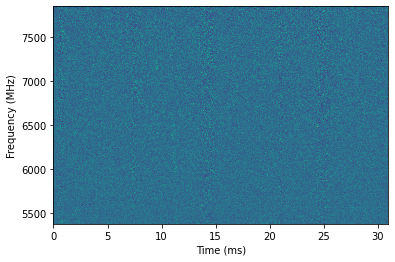

In [49]:
import importlib
importlib.reload(driftrate)
importlib.reload(frbrepeaters)
for filename in glob.glob('data/gajjar2018/*.4p'):
    if '12B' not in filename:
        continue
        
    print(filename)
    _, _, origwfall, burstmetadata = frbrepeaters.loadpsrfits(filename, dedisperse=False)
    origwfall[1053:1110, ...] = 0
    origwfall[15360:15471, ...] = 0
    origwfall = np.flipud(origwfall)
    print('DM', burstmetadata['DM'])

    wfall = origwfall.copy()
    lowest_freq = min(burstmetadata['dfs'])
    df = burstmetadata['dfs'][0]-burstmetadata['dfs'][1]
    dt = burstmetadata['duration']/wfall.shape[1]*1000
    burstmetadata['bandwidth'] = abs(burstmetadata['bandwidth'])
    burstmetadata['dfs'].sort()
    duration = dt*wfall.shape[1]

    subfall = driftrate.subsample(wfall, 2432, 2048)
    # match with paper 1
    burstmetadata['bandwidth'] = burstmetadata['bandwidth']*((subfall.shape[0] - ((subfall.shape[0]-2200)+510))/subfall.shape[0])
    lowest_freq = burstmetadata['center_f'] - subfall.shape[0]/2*(df*(19456/2432)) + (df*(19456/2432))*510
    subfall = subfall[510:2200, ...] 
    df = burstmetadata['bandwidth']/subfall.shape[0]
    burstmetadata['dfs'] = np.linspace(lowest_freq, lowest_freq+burstmetadata['bandwidth'], num=subfall.shape[0])
    print(burstmetadata)
    
    print(f"{df = }, {dt = }, {burstmetadata['bandwidth'] = }, {duration = }, {lowest_freq = }")
    print(f"{burstmetadata['dfs'] = }")
    print(f'{subfall.shape=}, {wfall.shape=}')
    # subfall = driftrate.subtractbg(subfall, 0, 20)
    fulltseries = np.nanmean(wfall, axis=0)
    tseries = np.nanmean(subfall, axis=0)
    pkidx = np.nanargmax(tseries)

    view = subfall
    print(">>>", df/(view.shape[0]/wfall.shape[0]))
    extents, correxts = driftrate.getExtents(subfall, df=df, dt=dt/(view.shape[1]/wfall.shape[1]), lowest_freq=lowest_freq)
    plt.figure()
    plt.imshow(view, origin='lower', aspect='auto', extent=extents, interpolation='none'); plt.xlabel('Time (ms)'); plt.ylabel('Frequency (MHz)')
    print(extents)
    
    bid = filename.split('/')[-1].split('_')[0]
    wfallout = f'data/gajjar2018/{bid}.npz'
    np.savez(wfallout, wfall=view, **burstmetadata)
    print('saved', wfallout)


# Li et al. 2021

## Burst Selection

In [14]:
f"{10**(-2.4):.4f} - {10**(-2.2):.5f} and {10**1.8:.4f} - {10**2}"

'0.0040 - 0.00631 and 63.0957 - 100'

<AxesSubplot: xlabel='log(Energy)', ylabel='log(WaitTime)'>

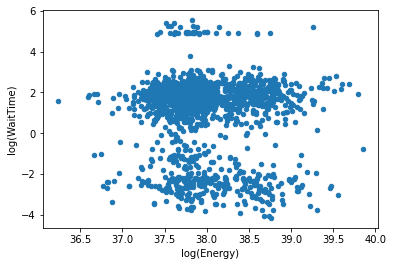

In [15]:
burstpropertiesdf.plot.scatter('log(Energy)', 'log(WaitTime)')

/home/mohammed/.local/lib/python3.8/site-packages/pandas/core/arraylike.py:364: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


len(waittimedf1) = 11 len(waittimedf2) = 13
len(peak1df) = 143 len(peak2df) = 29


,BurstID,Burst_time(MJD)($),DM,Width(ms),Bandwidth(GHz),Peak_Flux(mJy),Fluence(Jy_ms),Energy(erg),MJD_topo (Detected at 1.5GHz),MJD_topo (refined at 1.5GHz),...,File_ID,Sample_ID,DM_d_error,Width_d_error,Flux_error,Fluence_error,Energy_d_error,WaitTime(s),log(WaitTime),log(Energy)
PulseID,,,,,,,,,,,,,,,,,,,,,
P0138,138,58725.937984,564.9,28.30,0.20,233.25,6.6010,7.066000e+39,58725.938848,58725.938848,...,0437,17395,6.0,5.0,3.1,2.0,39.0,0.174839,-0.757361,39.849174
P0601,601,58732.977597,567.2,78.52,0.17,9.99,0.7844,8.397000e+38,58732.977795,58732.977795,...,tracking_3-M01_0178,9002,5.0,9.0,0.1,7.0,38.0,2.920432,0.465447,38.924124
P0732,732,58735.026640,566.7,21.27,0.40,31.10,0.6615,7.081000e+38,58735.026641,58735.026641,...,0133,9912,7.0,9.0,2.6,6.0,38.0,137.010018,2.136752,38.850095
P0749,749,58735.043385,568.2,25.80,0.25,36.28,0.9360,1.002000e+39,58735.043385,58735.043385,...,0245,45920,8.0,9.0,2.8,8.0,39.0,254.313587,2.405370,39.000868
P1101,1101,58750.891145,568.8,61.56,0.05,17.99,1.1075,1.186000e+39,58750.889607,58750.889607,...,0239,84333,5.0,9.0,6.0,9.0,39.0,69.816038,1.843955,39.074085
P1628,1628,58776.839025,567.4,23.22,0.22,5.64,0.1310,1.402000e+38,58776.835133,58776.835133,...,0014,8526,6.0,9.0,1.3,8.0,38.0,165425.251286,5.218602,38.146748


,BurstID,Burst_time(MJD)($),DM,Width(ms),Bandwidth(GHz),Peak_Flux(mJy),Fluence(Jy_ms),Energy(erg),MJD_topo (Detected at 1.5GHz),MJD_topo (refined at 1.5GHz),...,File_ID,Sample_ID,DM_d_error,Width_d_error,Flux_error,Fluence_error,Energy_d_error,WaitTime(s),log(WaitTime),log(Energy)
PulseID,,,,,,,,,,,,,,,,,,,,,
P0292,292,58727.035076,568.6,6.73,0.10,40.160,0.2703,2.893000e+38,58727.035837,58727.035837,...,0826,48853,5.0,8.0,4.1,3.0,38.0,0.005098,-2.292629,38.461348
P0311,311,58727.087528,566.0,4.41,0.12,57.355,0.2532,2.711000e+38,58727.088284,58727.088284,...,1180,7987,5.0,6.0,0.7,4.0,38.0,0.005772,-2.238706,38.433130
P0390,390,58728.025302,563.2,6.69,0.20,50.730,0.3394,3.633000e+38,58728.025970,58728.025970,...,0977,100502,4.0,6.0,4.0,2.0,38.0,0.004277,-2.368896,38.560265
P0430,430,58729.015584,564.4,3.51,0.40,87.360,0.3066,3.282000e+38,58729.016159,58729.016159,...,0388,98695,4.0,3.0,5.3,2.0,38.0,0.004631,-2.334305,38.516139
P0447,447,58729.030253,566.8,4.28,0.30,208.790,0.8936,9.566000e+38,58729.030827,58729.030827,...,0487,14111,3.0,1.0,4.9,1.0,38.0,0.004839,-2.315275,38.980730
P0455,455,58729.043570,562.5,10.49,0.40,97.970,1.0277,1.100000e+39,58729.044143,58729.044143,...,0576,52076,2.0,9.0,12.7,23.0,39.0,0.005460,-2.262776,39.041393
P0738,738,58735.031125,564.3,3.16,0.30,325.620,1.0290,1.101000e+39,58735.031126,58735.031126,...,0163,19643,5.0,1.0,7.5,1.0,39.0,0.005719,-2.242650,39.041787
P0762,762,58736.979509,564.3,5.82,0.35,151.770,0.8833,9.456000e+38,58736.979321,58736.979321,...,0095,22208,5.0,3.0,4.6,1.0,38.0,0.005659,-2.247257,38.975707
P1187,1187,58752.869665,564.7,3.57,0.45,71.140,0.2540,2.719000e+38,58752.867936,58752.867936,...,0140,117386,5.0,3.0,5.6,2.0,38.0,0.006307,-2.200165,38.434409


,BurstID,Burst_time(MJD)($),DM,Width(ms),Bandwidth(GHz),Peak_Flux(mJy),Fluence(Jy_ms),Energy(erg),MJD_topo (Detected at 1.5GHz),MJD_topo (refined at 1.5GHz),...,File_ID,Sample_ID,DM_d_error,Width_d_error,Flux_error,Fluence_error,Energy_d_error,WaitTime(s),log(WaitTime),log(Energy)
PulseID,,,,,,,,,,,,,,,,,,,,,
P1549,1549,58758.964048,566.2,5.15,0.200,10.330,0.0532,5.695000e+37,58758.961738,58758.961738,...,0164,69541,5.0,5.0,0.8,0.0,37.0,178.811384,2.252395,37.755494
P0518,518,58732.871317,566.3,3.49,0.105,14.689,0.0513,5.489000e+37,58732.871525,58732.871525,...,tracking-M01_0024,34706,5.0,5.0,0.2,1.0,37.0,40.281632,1.605107,37.739493
P0607,607,58732.981322,566.0,3.95,0.070,13.595,0.0537,5.745000e+37,58732.981520,58732.981520,...,tracking_3-M01_0203,5651,5.0,6.0,0.1,0.0,37.0,62.542869,1.796178,37.759290
P0815,815,58738.981354,567.9,3.63,0.100,14.960,0.0543,5.813000e+37,58738.980972,58738.980972,...,0153,105787,9.0,3.0,0.9,0.0,37.0,201.736803,2.304785,37.764400
P0598,598,58732.976571,566.0,3.55,0.080,14.701,0.0521,5.581000e+37,58732.976769,58732.976769,...,tracking_3-M01_0171,24827,5.0,5.0,0.1,0.0,37.0,12.711695,1.104203,37.746712
P0571,571,58732.967675,566.0,4.61,0.160,11.908,0.0549,5.872000e+37,58732.967874,58732.967874,...,tracking_3-M01_0111,70747,5.0,7.0,0.1,0.0,37.0,12.094375,1.082583,37.768786
P1157,1157,58752.850891,565.5,3.21,0.305,15.400,0.0494,5.292000e+37,58752.849164,58752.849164,...,0015,2246,5.0,4.0,1.0,0.0,37.0,0.005452,-2.263427,37.723620
P1428,1428,58756.869569,564.4,3.69,0.140,12.750,0.0471,5.036000e+37,58756.867458,58756.867458,...,0184,33621,5.0,4.0,1.0,0.0,37.0,7.024839,0.846636,37.702086
P0879,879,58745.947021,566.1,3.21,0.120,16.130,0.0518,5.543000e+37,58745.945962,58745.945962,...,0151,114394,3.0,3.0,1.2,0.0,37.0,0.006255,-2.203773,37.743745


,BurstID,Burst_time(MJD)($),DM,Width(ms),Bandwidth(GHz),Peak_Flux(mJy),Fluence(Jy_ms),Energy(erg),MJD_topo (Detected at 1.5GHz),MJD_topo (refined at 1.5GHz),...,File_ID,Sample_ID,DM_d_error,Width_d_error,Flux_error,Fluence_error,Energy_d_error,WaitTime(s),log(WaitTime),log(Energy)
PulseID,,,,,,,,,,,,,,,,,,,,,
P1290,1290,58755.000407,566.4,1.80,0.35,213.84,0.3849,4.120000e+38,58754.998474,58754.998474,...,0118,45659,12.0,1.0,1.5,0.0,38.0,0.001676,-2.775736,38.614897
P1289,1289,58755.000407,564.4,2.00,0.32,210.78,0.4216,4.513000e+38,58754.998474,58754.998474,...,0118,45636,3.0,0.0,1.9,0.0,38.0,248.682130,2.395645,38.654465
P0342,342,58727.940379,567.0,4.36,0.10,100.11,0.4365,4.672000e+38,58727.941055,58727.941055,...,0448,48478,3.0,3.0,4.9,1.0,38.0,0.001417,-2.848642,38.669503
P0665,665,58733.914039,565.2,3.18,0.07,119.91,0.3813,4.082000e+38,58733.914147,58733.914147,...,0112,31227,5.0,2.0,6.3,1.0,38.0,24.055454,1.381214,38.610873
P0539,539,58732.956126,564.0,2.66,0.15,142.20,0.3782,4.049000e+38,58732.956326,58732.956326,...,tracking_3-M01_0034,13941,2.0,1.0,5.8,1.0,38.0,39.823721,1.600142,38.607348
P0223,223,58726.938301,562.7,2.61,0.35,178.31,0.4654,4.982000e+38,58726.939071,58726.939071,...,0148,66635,1.0,1.0,6.5,1.0,38.0,101.291385,2.005573,38.697404
P0595,595,58732.975991,564.2,2.87,0.20,141.21,0.4053,4.338000e+38,58732.976189,58732.976189,...,tracking_3-M01_0167,39054,4.0,1.0,6.0,1.0,38.0,2.183449,0.339143,38.637290
P0192,192,58725.986481,567.4,3.95,0.10,101.00,0.3990,4.271000e+38,58725.987340,58725.987340,...,0754,39014,4.0,2.0,5.1,1.0,38.0,0.001900,-2.721158,38.630530
P0451,451,58729.037217,566.2,3.09,0.30,128.21,0.3962,4.241000e+38,58729.037790,58729.037790,...,0533,104602,4.0,6.0,10.7,6.0,38.0,0.002064,-2.685193,38.627468


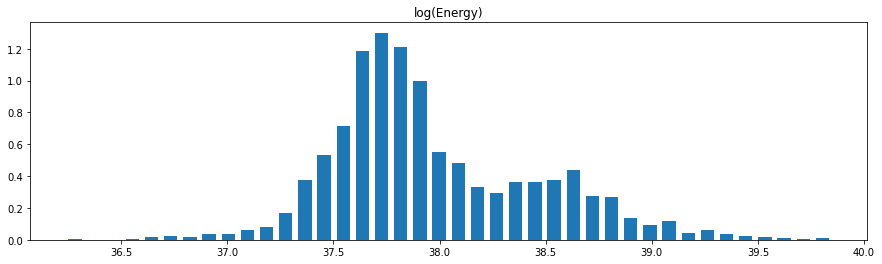

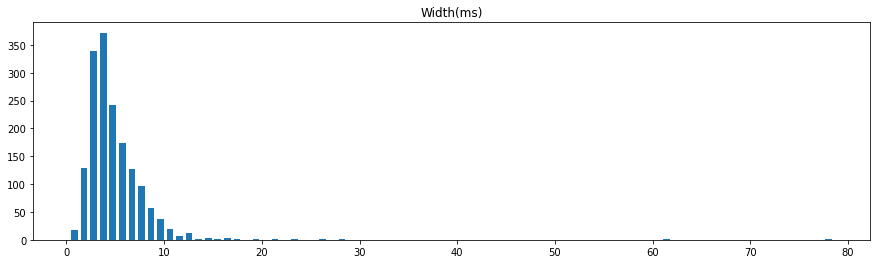

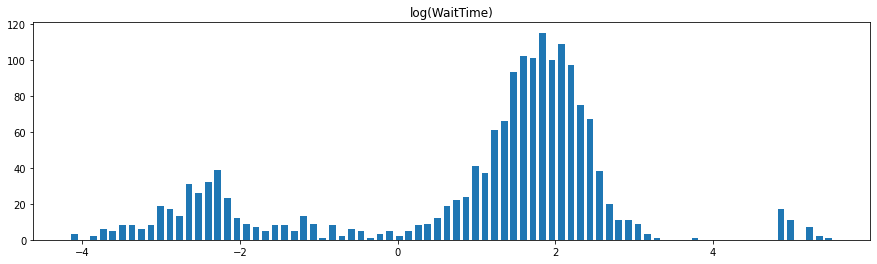

In [19]:
%matplotlib inline
# Load and Merge
burstpropertiesdf = pd.read_csv('data/li2019/FRB121102_1652burstListClean.csv').set_index("BurstID")
burstpropertiesdf['PulseID'] = [f"P{b:04}" for b in burstpropertiesdf.index]
burstpropertiesdf = burstpropertiesdf.reset_index().set_index("PulseID")
burstfilesdf      = pd.read_csv('data/li2019/PulseID_fileIDlist.csv', delimiter=';').set_index("Pulse_ID")
burstpropertiesdf = burstpropertiesdf.merge(burstfilesdf, left_index=True, right_index=True)

# Spreadsheet Cleanup
burstpropertiesdf[['DM', 'DM_d_error']] = burstpropertiesdf['DM'].str.split(r'\(\s*(\d*)\s*\)', expand=True)[[0,1]].astype('float64')
burstpropertiesdf[['Width(ms)', 'Width_d_error']] = burstpropertiesdf['Width(ms)'].str.split(r'\(\s*(\d*)\s*\)', expand=True)[[0,1]].astype('float64')
burstpropertiesdf[['Peak_Flux(mJy)', 'Flux_error']] = burstpropertiesdf['Peak_Flux(mJy)'].str.split(expand=True)[[0,2]].astype('float64')
burstpropertiesdf[['Fluence(Jy_ms)', 'Fluence_error']] = burstpropertiesdf['Fluence(Jy_ms)'].str.split(r'\(\s*(\d*)\s*\)', expand=True)[[0,1]].astype('float64')
energyvals = burstpropertiesdf['Energy(erg)'].str.split(expand=True)
burstpropertiesdf['Energy(erg)'] = (energyvals[0]+'e' + energyvals[5]).astype('float64')
burstpropertiesdf['Energy_d_error'] = energyvals[5].astype('float64')

# Compute wait time
burstpropertiesdf['WaitTime(s)'] = burstpropertiesdf["MJD_topo (refined at 1.5GHz)"].diff()*(24*60*60)
burstpropertiesdf['log(WaitTime)'] = np.log10(burstpropertiesdf['WaitTime(s)'])
burstpropertiesdf.replace([np.inf, -np.inf], np.nan, inplace=True)

# display(burstpropertiesdf)
figsize=(15,4)
burstpropertiesdf['log(Energy)'] = np.log10(burstpropertiesdf['Energy(erg)'])
burstpropertiesdf.hist('log(Energy)', bins=40, grid=False, rwidth=0.7, figsize=figsize, density=True)
burstpropertiesdf.hist('Width(ms)', bins=80, grid=False, rwidth=0.7, figsize=figsize)
burstpropertiesdf.hist('log(WaitTime)', bins=80, grid=False, rwidth=0.7, figsize=figsize)

longburstsdf = burstpropertiesdf[burstpropertiesdf['Width(ms)'] > 20]
# -2.4 to -2.2, 1.8 to 2
waittimedf1 = burstpropertiesdf[(burstpropertiesdf['log(WaitTime)'] > -2.4) & (burstpropertiesdf['log(WaitTime)'] < -2.2) & (burstpropertiesdf['Peak_Flux(mJy)'] > 40)]
waittimedf2 = burstpropertiesdf[(burstpropertiesdf['log(WaitTime)'] > 1.8) & (burstpropertiesdf['log(WaitTime)'] < 2) & (burstpropertiesdf['Peak_Flux(mJy)'] > 100)]
print(f"{len(waittimedf1) = } {len(waittimedf2) = }")
waittimedf = pd.concat([waittimedf1, waittimedf2])

peak1df = burstpropertiesdf[(burstpropertiesdf['log(Energy)'] > 37.7) & (burstpropertiesdf['log(Energy)'] < 37.8) & (burstpropertiesdf['Peak_Flux(mJy)'] > 10)]
peak2df = burstpropertiesdf[(burstpropertiesdf['log(Energy)'] > 38.6) & (burstpropertiesdf['log(Energy)'] < 38.7) & (burstpropertiesdf['Peak_Flux(mJy)'] > 100)]
print(f"{len(peak1df) = } {len(peak2df) = }")
display(longburstsdf)
pd.set_option('display.max_rows', 250)
# peak1df.plot(x='Width(ms)', y='Peak_Flux(mJy)', style='o', figsize=figsize)
# peak1df.plot(x='Width(ms)', y='Bandwidth(GHz)', style='o', figsize=figsize)

dfnames = ['data/li2019/peak1sample.csv', 'data/li2019/peak2sample.csv']
if os.path.isfile(dfnames[0]):
    peak1sample = pd.read_csv(dfnames[0]).set_index('PulseID')
else:
    peak1sample = peak1df.sample(10)
if os.path.isfile(dfnames[1]):
    peak2sample = pd.read_csv(dfnames[1]).set_index('PulseID')
else:
    peak2sample = peak2df.sample(10)

brightestdf = burstpropertiesdf.sort_values('Peak_Flux(mJy)', ascending=False)
# brightestdf.to_csv('/mnt/e/Li2021/brightestbursts.csv')
# brightestdf
    
display(waittimedf)
display(peak1sample)
display(peak2sample)

## Burst Downloading

In [ ]:
from tqdm import tqdm
import urllib.request
import ssl, shutil, os, time

longburstsdf.to_csv('data/li2019/longbursts.csv')
display(longburstsdf)
bursturls = np.load('/mnt/e/Li2021/scripts/bursturls.npy') # all available bursts
burstdfs = [waittimedf, peak1sample, peak2sample, brightestdf]
dfnames = ['data/li2019/waittimesample.csv', 'data/li2019/peak1sample.csv', 'data/li2019/peak2sample.csv', '/mnt/e/Li2021/brightestbursts.csv']
outputdirs = ['/mnt/e/Li2021/samp_waittimes', '/mnt/e/Li2021/samp_peak1', '/mnt/e/Li2021/samp_peak2', '/mnt/e/Li2021/samp_brightest']
context = ssl.SSLContext()

# download sampled bursts
for df, name, outdir in zip(burstdfs, dfnames, outputdirs):
    display(df)
    # ensure file ids are padded strings
    if df['File_ID'].dtype != 'string' and df['File_ID'].dtype != object:
        df['File_ID'] = [f"{f:04}" for f in df['File_ID'].astype(int)]
        df['File_ID'] = df['File_ID'].astype('string')
        
    df.to_csv(name)
    obsdates = df['Obs_Date'].str.split('UT', expand=True)[1]
    fileids = df['File_ID']
    pbarbursts = tqdm(zip(obsdates, fileids), total=len(fileids))
    for obsdate, fileid in pbarbursts:
        url = [url for url in bursturls if (obsdate in url) and (fileid in url)]
        if len(url) > 0:
            url = url[0]
        else:
            print(f"URL not found for burst {obsdate} {fileid}")
            continue
        filename = f"{outdir}/{url.split('/')[-1]}"
        if not os.path.isfile(filename):
            pbarbursts.set_description(f"Downloading {url}")
            siteDown = True
            numtries = 0
            while siteDown:
                try:
                    with urllib.request.urlopen(url, context=context) as response, open(filename, 'wb') as outfile:
                        shutil.copyfileobj(response, outfile)
                    siteDown = False
                except Exception as e:
                    print(f'attempt {numtries} waiting 5 minutes', e)
                    numtries += 1
                    time.sleep(60*5)
        else:
            print(f"Skipping {filename}")


,BurstID,Burst_time(MJD)($),DM,Width(ms),Bandwidth(GHz),Peak_Flux(mJy),Fluence(Jy_ms),Energy(erg),MJD_topo (Detected at 1.5GHz),MJD_topo (refined at 1.5GHz),...,File_ID,Sample_ID,DM_d_error,Width_d_error,Flux_error,Fluence_error,Energy_d_error,WaitTime(s),log(WaitTime),log(Energy)
PulseID,,,,,,,,,,,,,,,,,,,,,
P0138,138,58725.937984,564.9,28.30,0.20,233.25,6.6010,7.066000e+39,58725.938848,58725.938848,...,0437,17395,6.0,5.0,3.1,2.0,39.0,0.174839,-0.757361,39.849174
P0601,601,58732.977597,567.2,78.52,0.17,9.99,0.7844,8.397000e+38,58732.977795,58732.977795,...,tracking_3-M01_0178,9002,5.0,9.0,0.1,7.0,38.0,2.920432,0.465447,38.924124
P0732,732,58735.026640,566.7,21.27,0.40,31.10,0.6615,7.081000e+38,58735.026641,58735.026641,...,0133,9912,7.0,9.0,2.6,6.0,38.0,137.010018,2.136752,38.850095
P0749,749,58735.043385,568.2,25.80,0.25,36.28,0.9360,1.002000e+39,58735.043385,58735.043385,...,0245,45920,8.0,9.0,2.8,8.0,39.0,254.313587,2.405370,39.000868
P1101,1101,58750.891145,568.8,61.56,0.05,17.99,1.1075,1.186000e+39,58750.889607,58750.889607,...,0239,84333,5.0,9.0,6.0,9.0,39.0,69.816038,1.843955,39.074085
P1628,1628,58776.839025,567.4,23.22,0.22,5.64,0.1310,1.402000e+38,58776.835133,58776.835133,...,0014,8526,6.0,9.0,1.3,8.0,38.0,165425.251286,5.218602,38.146748


,BurstID,Burst_time(MJD)($),DM,Width(ms),Bandwidth(GHz),Peak_Flux(mJy),Fluence(Jy_ms),Energy(erg),MJD_topo (Detected at 1.5GHz),MJD_topo (refined at 1.5GHz),...,File_ID,Sample_ID,DM_d_error,Width_d_error,Flux_error,Fluence_error,Energy_d_error,WaitTime(s),log(WaitTime),log(Energy)
PulseID,,,,,,,,,,,,,,,,,,,,,
P0292,292,58727.035076,568.6,6.73,0.10,40.160,0.2703,2.893000e+38,58727.035837,58727.035837,...,0826,48853,5.0,8.0,4.1,3.0,38.0,0.005098,-2.292629,38.461348
P0311,311,58727.087528,566.0,4.41,0.12,57.355,0.2532,2.711000e+38,58727.088284,58727.088284,...,1180,7987,5.0,6.0,0.7,4.0,38.0,0.005772,-2.238706,38.433130
P0390,390,58728.025302,563.2,6.69,0.20,50.730,0.3394,3.633000e+38,58728.025970,58728.025970,...,0977,100502,4.0,6.0,4.0,2.0,38.0,0.004277,-2.368896,38.560265
P0430,430,58729.015584,564.4,3.51,0.40,87.360,0.3066,3.282000e+38,58729.016159,58729.016159,...,0388,98695,4.0,3.0,5.3,2.0,38.0,0.004631,-2.334305,38.516139
P0447,447,58729.030253,566.8,4.28,0.30,208.790,0.8936,9.566000e+38,58729.030827,58729.030827,...,0487,14111,3.0,1.0,4.9,1.0,38.0,0.004839,-2.315275,38.980730
P0455,455,58729.043570,562.5,10.49,0.40,97.970,1.0277,1.100000e+39,58729.044143,58729.044143,...,0576,52076,2.0,9.0,12.7,23.0,39.0,0.005460,-2.262776,39.041393
P0738,738,58735.031125,564.3,3.16,0.30,325.620,1.0290,1.101000e+39,58735.031126,58735.031126,...,0163,19643,5.0,1.0,7.5,1.0,39.0,0.005719,-2.242650,39.041787
P0762,762,58736.979509,564.3,5.82,0.35,151.770,0.8833,9.456000e+38,58736.979321,58736.979321,...,0095,22208,5.0,3.0,4.6,1.0,38.0,0.005659,-2.247257,38.975707
P1187,1187,58752.869665,564.7,3.57,0.45,71.140,0.2540,2.719000e+38,58752.867936,58752.867936,...,0140,117386,5.0,3.0,5.6,2.0,38.0,0.006307,-2.200165,38.434409


100%|██████████████████████████████████████████████████████████████████████████████████| 24/24 [00:00<00:00, 453.25it/s]

Skipping /mnt/e/Li2021/samp_waittimes/FRB121102_tracking-M01_0826.fits
Skipping /mnt/e/Li2021/samp_waittimes/FRB121102_tracking-M01_1180.fits
Skipping /mnt/e/Li2021/samp_waittimes/FRB121102_tracking-M01_0977.fits
Skipping /mnt/e/Li2021/samp_waittimes/FRB121102_tracking-M01_0388.fits
Skipping /mnt/e/Li2021/samp_waittimes/FRB121102_tracking-M01_0487.fits
Skipping /mnt/e/Li2021/samp_waittimes/FRB121102_tracking-M01_0576.fits
Skipping /mnt/e/Li2021/samp_waittimes/FRB121102_tracking-M01_0163.fits
Skipping /mnt/e/Li2021/samp_waittimes/FRB121102_tracking-M01_0095.fits
Skipping /mnt/e/Li2021/samp_waittimes/FRB121102_tracking-M01_0140.fits
Skipping /mnt/e/Li2021/samp_waittimes/FRB121102_tracking-M01_0179.fits
Skipping /mnt/e/Li2021/samp_waittimes/FRB121102_tracking-M01_0085.fits
Skipping /mnt/e/Li2021/samp_waittimes/FRB121102_tracking-M01_0103.fits
Skipping /mnt/e/Li2021/samp_waittimes/FRB121102_tracking-M01_0630.fits
Skipping /mnt/e/Li2021/samp_waittimes/FRB121102_tracking-M01_0415.fits
Skippi

,BurstID,Burst_time(MJD)($),DM,Width(ms),Bandwidth(GHz),Peak_Flux(mJy),Fluence(Jy_ms),Energy(erg),MJD_topo (Detected at 1.5GHz),MJD_topo (refined at 1.5GHz),MJD_bary (at 1.5GHz),Obs_Date,File_ID,Sample_ID,DM_d_error,Width_d_error,Flux_error,Fluence_error,Energy_d_error,log(Energy)
PulseID,,,,,,,,,,,,,,,,,,,,
P1549,1549,58758.964048,566.2,5.15,0.200,10.330,0.0532,5.695000e+37,58758.961738,58758.961738,58758.964048,UT20191003,0164,69541,5.0,5.0,0.8,0.0,37.0,37.755494
P0518,518,58732.871317,566.3,3.49,0.105,14.689,0.0513,5.489000e+37,58732.871525,58732.871525,58732.871317,UT20190907,tracking-M01_0024,34706,5.0,5.0,0.2,1.0,37.0,37.739493
P0607,607,58732.981322,566.0,3.95,0.070,13.595,0.0537,5.745000e+37,58732.981520,58732.981520,58732.981322,UT20190907,tracking_3-M01_0203,5651,5.0,6.0,0.1,0.0,37.0,37.759290
P0815,815,58738.981354,567.9,3.63,0.100,14.960,0.0543,5.813000e+37,58738.980972,58738.980972,58738.981354,UT20190913,0153,105787,9.0,3.0,0.9,0.0,37.0,37.764400
P0598,598,58732.976571,566.0,3.55,0.080,14.701,0.0521,5.581000e+37,58732.976769,58732.976769,58732.976571,UT20190907,tracking_3-M01_0171,24827,5.0,5.0,0.1,0.0,37.0,37.746712
P0571,571,58732.967675,566.0,4.61,0.160,11.908,0.0549,5.872000e+37,58732.967874,58732.967874,58732.967675,UT20190907,tracking_3-M01_0111,70747,5.0,7.0,0.1,0.0,37.0,37.768786
P1157,1157,58752.850891,565.5,3.21,0.305,15.400,0.0494,5.292000e+37,58752.849164,58752.849164,58752.850891,UT20190927,0015,2246,5.0,4.0,1.0,0.0,37.0,37.723620
P1428,1428,58756.869569,564.4,3.69,0.140,12.750,0.0471,5.036000e+37,58756.867458,58756.867458,58756.869569,UT20191001,0184,33621,5.0,4.0,1.0,0.0,37.0,37.702086
P0879,879,58745.947021,566.1,3.21,0.120,16.130,0.0518,5.543000e+37,58745.945962,58745.945962,58745.947021,UT20190920,0151,114394,3.0,3.0,1.2,0.0,37.0,37.743745


100%|██████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 665.07it/s]

Skipping /mnt/e/Li2021/samp_peak1/FRB121102_tracking-M01_0164.fits
Skipping /mnt/e/Li2021/samp_peak1/FRB121102_tracking-M01_0024.fits
Skipping /mnt/e/Li2021/samp_peak1/FRB121102_tracking_3-M01_0203.fits
Skipping /mnt/e/Li2021/samp_peak1/FRB121102_tracking-M01_0153.fits
Skipping /mnt/e/Li2021/samp_peak1/FRB121102_tracking_3-M01_0171.fits
Skipping /mnt/e/Li2021/samp_peak1/FRB121102_tracking_3-M01_0111.fits
Skipping /mnt/e/Li2021/samp_peak1/FRB121102_tracking-M01_0015.fits
Skipping /mnt/e/Li2021/samp_peak1/FRB121102_tracking-M01_0184.fits
Skipping /mnt/e/Li2021/samp_peak1/FRB121102_tracking-M01_0151.fits
Skipping /mnt/e/Li2021/samp_peak1/FRB121102_tracking-M01_0133.fits


,BurstID,Burst_time(MJD)($),DM,Width(ms),Bandwidth(GHz),Peak_Flux(mJy),Fluence(Jy_ms),Energy(erg),MJD_topo (Detected at 1.5GHz),MJD_topo (refined at 1.5GHz),MJD_bary (at 1.5GHz),Obs_Date,File_ID,Sample_ID,DM_d_error,Width_d_error,Flux_error,Fluence_error,Energy_d_error,log(Energy)
PulseID,,,,,,,,,,,,,,,,,,,,
P1290,1290,58755.000407,566.4,1.80,0.35,213.84,0.3849,4.120000e+38,58754.998474,58754.998474,58755.000407,UT20190929,0118,45659,12.0,1.0,1.5,0.0,38.0,38.614897
P1289,1289,58755.000407,564.4,2.00,0.32,210.78,0.4216,4.513000e+38,58754.998474,58754.998474,58755.000407,UT20190929,0118,45636,3.0,0.0,1.9,0.0,38.0,38.654465
P0342,342,58727.940379,567.0,4.36,0.10,100.11,0.4365,4.672000e+38,58727.941055,58727.941055,58727.940379,UT20190902,0448,48478,3.0,3.0,4.9,1.0,38.0,38.669503
P0665,665,58733.914039,565.2,3.18,0.07,119.91,0.3813,4.082000e+38,58733.914147,58733.914147,58733.914039,UT20190908,0112,31227,5.0,2.0,6.3,1.0,38.0,38.610873
P0539,539,58732.956126,564.0,2.66,0.15,142.20,0.3782,4.049000e+38,58732.956326,58732.956326,58732.956126,UT20190907,tracking_3-M01_0034,13941,2.0,1.0,5.8,1.0,38.0,38.607348
P0223,223,58726.938301,562.7,2.61,0.35,178.31,0.4654,4.982000e+38,58726.939071,58726.939071,58726.938301,UT20190901,0148,66635,1.0,1.0,6.5,1.0,38.0,38.697404
P0595,595,58732.975991,564.2,2.87,0.20,141.21,0.4053,4.338000e+38,58732.976189,58732.976189,58732.975991,UT20190907,tracking_3-M01_0167,39054,4.0,1.0,6.0,1.0,38.0,38.637290
P0192,192,58725.986481,567.4,3.95,0.10,101.00,0.3990,4.271000e+38,58725.987340,58725.987340,58725.986481,UT20190831,0754,39014,4.0,2.0,5.1,1.0,38.0,38.630530
P0451,451,58729.037217,566.2,3.09,0.30,128.21,0.3962,4.241000e+38,58729.037790,58729.037790,58729.037217,UT20190903,0533,104602,4.0,6.0,10.7,6.0,38.0,38.627468


100%|██████████████████████████████████████████████████████████████████████████████████| 10/10 [00:00<00:00, 622.06it/s]

Skipping /mnt/e/Li2021/samp_peak2/FRB121102_tracking-M01_0118.fits
Skipping /mnt/e/Li2021/samp_peak2/FRB121102_tracking-M01_0118.fits
Skipping /mnt/e/Li2021/samp_peak2/FRB121102_tracking-M01_0448.fits
Skipping /mnt/e/Li2021/samp_peak2/FRB121102_tracking-M01_0112.fits
Skipping /mnt/e/Li2021/samp_peak2/FRB121102_tracking_3-M01_0034.fits
Skipping /mnt/e/Li2021/samp_peak2/FRB121102_tracking-M01_0148.fits
Skipping /mnt/e/Li2021/samp_peak2/FRB121102_tracking_3-M01_0167.fits
Skipping /mnt/e/Li2021/samp_peak2/FRB121102_tracking-M01_0754.fits
Skipping /mnt/e/Li2021/samp_peak2/FRB121102_tracking-M01_0533.fits
Skipping /mnt/e/Li2021/samp_peak2/FRB121102_tracking-M01_0112.fits


,BurstID,Burst_time(MJD)($),DM,Width(ms),Bandwidth(GHz),Peak_Flux(mJy),Fluence(Jy_ms),Energy(erg),MJD_topo (Detected at 1.5GHz),MJD_topo (refined at 1.5GHz),...,File_ID,Sample_ID,DM_d_error,Width_d_error,Flux_error,Fluence_error,Energy_d_error,WaitTime(s),log(WaitTime),log(Energy)
PulseID,,,,,,,,,,,,,,,,,,,,,
P0506,506,58730.906966,564.4,3.51,0.300,1654.830,5.8084,6.218000e+39,58730.907361,58730.907361,...,0264,74150,2.0,0.0,7.7,0.0,39.0,79.577502,1.900790,39.793651
P0464,464,58729.063070,564.6,3.18,0.400,1015.450,3.2291,3.457000e+39,58729.063641,58729.063641,...,0707,18607,2.0,0.0,7.1,0.0,39.0,602.332735,2.779836,39.538699
P0777,777,58736.998265,564.7,3.97,0.400,945.190,3.7524,4.017000e+39,58736.998076,58736.998076,...,0220,121472,4.0,0.0,7.4,0.0,39.0,265.339965,2.423803,39.603902
P0950,950,58747.851778,567.0,2.42,0.300,896.240,2.1689,2.322000e+39,58747.850534,58747.850534,...,0070,101636,8.0,0.0,5.0,0.0,39.0,282.365499,2.450812,39.365862
P0634,634,58733.901694,563.9,4.21,0.400,861.120,3.6253,3.881000e+39,58733.901804,58733.901804,...,0029,61752,3.0,0.0,7.7,0.0,39.0,145.507623,2.162886,39.588944
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
P1550,1550,58758.964149,569.0,7.33,0.085,2.546,0.0187,1.997000e+37,58758.961840,58758.961840,...,0165,27938,5.0,9.0,0.0,0.0,37.0,8.795364,0.944254,37.300378
P0671,671,58733.916133,564.5,4.17,0.060,2.488,0.0104,1.111000e+37,58733.916241,58733.916241,...,0126,36499,5.0,6.0,0.0,0.0,37.0,48.504891,1.685786,37.045714
P0620,620,58732.987803,556.7,7.81,0.150,2.447,0.0191,2.046000e+37,58732.988000,58732.988000,...,tracking_3-M01_0246,65444,5.0,9.0,0.0,0.0,37.0,107.422183,2.031094,37.310906


  0%|                                                                                          | 0/1652 [00:00<?, ?it/s]

Skipping /mnt/e/Li2021/samp_brightest/FRB121102_tracking-M01_0264.fits
Skipping /mnt/e/Li2021/samp_brightest/FRB121102_tracking-M01_0707.fits
Skipping /mnt/e/Li2021/samp_brightest/FRB121102_tracking-M01_0220.fits
Skipping /mnt/e/Li2021/samp_brightest/FRB121102_tracking-M01_0070.fits
Skipping /mnt/e/Li2021/samp_brightest/FRB121102_tracking-M01_0029.fits
Skipping /mnt/e/Li2021/samp_brightest/FRB121102_tracking-M01_0053.fits
Skipping /mnt/e/Li2021/samp_brightest/FRB121102_tracking-M01_0197.fits
Skipping /mnt/e/Li2021/samp_brightest/FRB121102_tracking-M01_1300.fits
Skipping /mnt/e/Li2021/samp_brightest/FRB121102_tracking-M01_0407.fits
Skipping /mnt/e/Li2021/samp_brightest/FRB121102_tracking_3-M01_0132.fits
Skipping /mnt/e/Li2021/samp_brightest/FRB121102_tracking-M01_0944.fits
Skipping /mnt/e/Li2021/samp_brightest/FRB121102_tracking-M01_0776.fits
Skipping /mnt/e/Li2021/samp_brightest/FRB121102_tracking-M01_0136.fits
Skipping /mnt/e/Li2021/samp_brightest/FRB121102_tracking-M01_0034.fits
Skip

Skipping /mnt/e/Li2021/samp_brightest/FRB121102_tracking-M01_0274.fits
Skipping /mnt/e/Li2021/samp_brightest/FRB121102_tracking-M01_0055.fits
Skipping /mnt/e/Li2021/samp_brightest/FRB121102_tracking-M01_0405.fits
Skipping /mnt/e/Li2021/samp_brightest/FRB121102_tracking-M01_0057.fits
Skipping /mnt/e/Li2021/samp_brightest/FRB121102_tracking-M01_0105.fits
Skipping /mnt/e/Li2021/samp_brightest/FRB121102_tracking-M01_0118.fits
Skipping /mnt/e/Li2021/samp_brightest/FRB121102_tracking-M01_0101.fits
Skipping /mnt/e/Li2021/samp_brightest/FRB121102_tracking-M01_0118.fits
Skipping /mnt/e/Li2021/samp_brightest/FRB121102_tracking-M01_0487.fits
URL not found for burst 20190830 0162
Skipping /mnt/e/Li2021/samp_brightest/FRB121102_tracking-M01_1300.fits
URL not found for burst 20190903 0243
Skipping /mnt/e/Li2021/samp_brightest/FRB121102_tracking-M01_0140.fits
Skipping /mnt/e/Li2021/samp_brightest/FRB121102_tracking-M01_0181.fits
Skipping /mnt/e/Li2021/samp_brightest/FRB121102_tracking-M01_0748.fits
S

Skipping /mnt/e/Li2021/samp_brightest/FRB121102_tracking-M01_0101.fits


Skipping /mnt/e/Li2021/samp_brightest/FRB121102_tracking-M01_0101.fits


Skipping /mnt/e/Li2021/samp_brightest/FRB121102_tracking-M01_0163.fits


Skipping /mnt/e/Li2021/samp_brightest/FRB121102_tracking-M01_0147.fits
Skipping /mnt/e/Li2021/samp_brightest/FRB121102_tracking_3-M01_0112.fits
Skipping /mnt/e/Li2021/samp_brightest/FRB121102_tracking-M01_0013.fits


Skipping /mnt/e/Li2021/samp_brightest/FRB121102_tracking-M01_0200.fits


## Burst Loading

In [13]:
burstnpzs = glob.glob('/mnt/e/Li2021/samp*/*.npz')
def updatenpz(field):
    for npz in burstnpzs:
        data = np.load(npz)
        duration = data['dt']*data['wfall'].shape[1]
        newdata = {}
        for key in data.files:
            if key == field:
                newdata[key] = duration
            else:
                newdata[key] = data[key]
        np.savez(npz, **newdata)
        
updatenpz('duration')

0.098304 98.304 9.8304e-05
0.098304 98.304 9.8304e-05
0.098304 98.304 9.8304e-05
0.098304 98.304 9.8304e-05
0.098304 98.304 9.8304e-05
0.098304 98.304 9.8304e-05
0.098304 98.304 9.8304e-05
0.098304 98.304 9.8304e-05
0.098304 98.304 9.8304e-05
0.098304 98.304 9.8304e-05
0.098304 98.304 9.8304e-05
0.098304 98.304 9.8304e-05
0.098304 98.304 9.8304e-05
0.098304 98.304 9.8304e-05
0.098304 98.304 9.8304e-05
0.098304 98.304 9.8304e-05
0.098304 98.304 9.8304e-05
0.098304 98.304 9.8304e-05
0.098304 98.304 9.8304e-05
0.098304 98.304 9.8304e-05
0.098304 98.304 9.8304e-05
0.098304 98.304 9.8304e-05
0.098304 98.304 9.8304e-05
0.098304 98.304 9.8304e-05


In [31]:
a = your.Your('/mnt/e/Li2021/samp_waittimes/FRB121102_tracking_3-M01_0031.fits')
a.your_header

Unified Header:
  "basename": "FRB121102_tracking_3-M01_0031"
  "bw": 500.0
  "center_freq": 1250.0
  "dec_deg": -12.582441388888888
  "dtype": "uint8"
  "fch1": 1000.0
  "filelist": [
    "/mnt/e/Li2021/samp_waittimes/FRB121102_tracking_3-M01_0031.fits"
  ]
  "filename": "/mnt/e/Li2021/samp_waittimes/FRB121102_tracking_3-M01_0031.fits"
  "foff": 0.1220703125
  "format": "fits"
  "frequency_decimation_factor": 1
  "gb": 50.088153193929415
  "gl": 116.65328579971941
  "native_foff": 0.1220703125
  "native_nbits": 8
  "native_nchans": 4096
  "native_nspectra": 131072
  "native_tsamp": 9.8304e-05
  "nbits": 8
  "nchans": 4096
  "npol": 4
  "nspectra": 131072
  "poln_order": "AABBCRCI"
  "ra_deg": 188.7366208333333
  "source_name": "J2000-1234"
  "time_decimation_factor": 1
  "tsamp": 9.8304e-05
  "tstart": 58732.96033673742
  "tstart_utc": "2019-09-06T23:02:53.094"

Reading bursts:   0%|                                                                            | 0/23 [00:00<?, ?it/s]

/mnt/e/Li2021/samp_waittimes/FRB121102_tracking-M01_0041.fits 568.6
data loaded: (4096, 131072)


/home/mohammed/.local/lib/python3.8/site-packages/numpy/core/fromnumeric.py:755: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  a.partition(kth, axis=axis, kind=kind, order=order)


(4096, 131072)
(256, 131072)


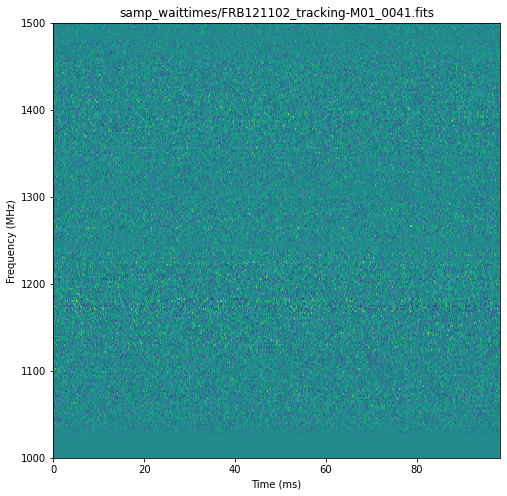

Reading bursts:   4%|██▊                                                              | 1/23 [11:27<4:12:09, 687.71s/it]

/mnt/e/Li2021/samp_waittimes/FRB121102_tracking-M01_0055.fits 566.0
data loaded: (4096, 131072)
(4096, 131072)
(256, 131072)


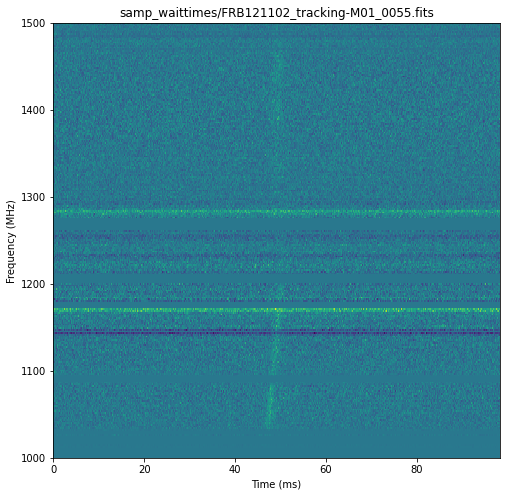

Reading bursts:   9%|█████▋                                                           | 2/23 [19:45<3:40:43, 630.63s/it]

/mnt/e/Li2021/samp_waittimes/FRB121102_tracking-M01_0085.fits 563.2
data loaded: (4096, 131072)
(4096, 131072)
(256, 131072)


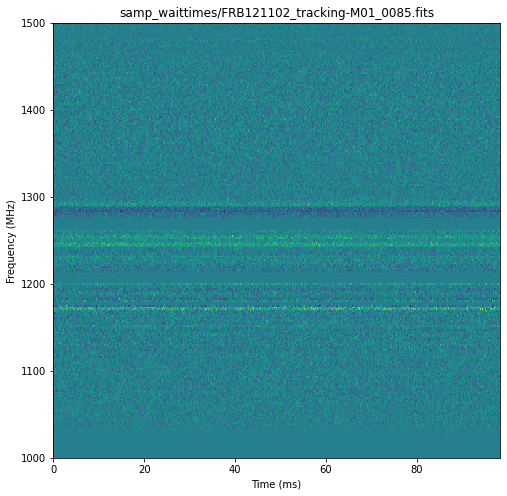

Reading bursts:  13%|████████▍                                                        | 3/23 [26:33<3:07:56, 563.83s/it]

/mnt/e/Li2021/samp_waittimes/FRB121102_tracking-M01_0095.fits 564.4
data loaded: (4096, 131072)
(4096, 131072)
(256, 131072)


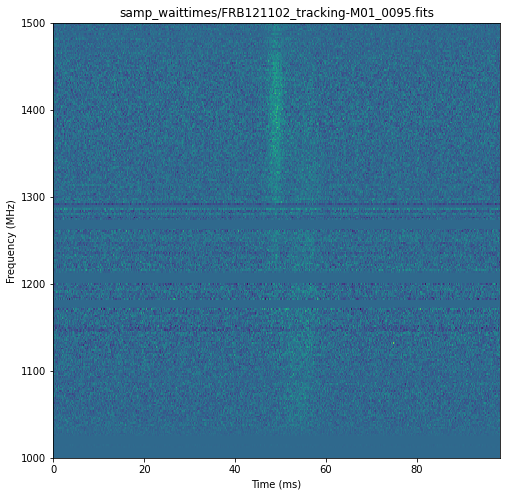

Reading bursts:  17%|███████████▎                                                     | 4/23 [34:22<2:49:36, 535.61s/it]

/mnt/e/Li2021/samp_waittimes/FRB121102_tracking-M01_0103.fits 566.8
data loaded: (4096, 131072)
(4096, 131072)
(256, 131072)


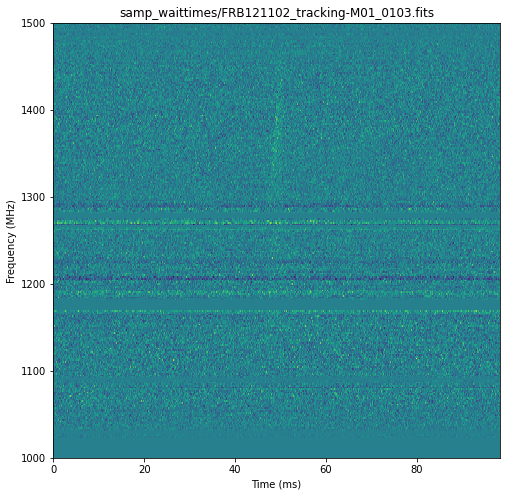

Reading bursts:  22%|██████████████▏                                                  | 5/23 [41:33<2:31:12, 504.02s/it]

/mnt/e/Li2021/samp_waittimes/FRB121102_tracking-M01_0140.fits 562.5
data loaded: (4096, 131072)
(4096, 131072)
(256, 131072)


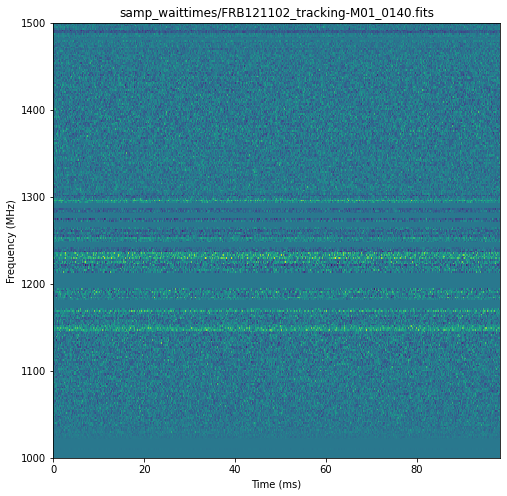

Reading bursts:  26%|████████████████▉                                                | 6/23 [49:28<2:20:19, 495.26s/it]

/mnt/e/Li2021/samp_waittimes/FRB121102_tracking-M01_0163.fits 564.3
data loaded: (4096, 131072)
(4096, 131072)
(256, 131072)


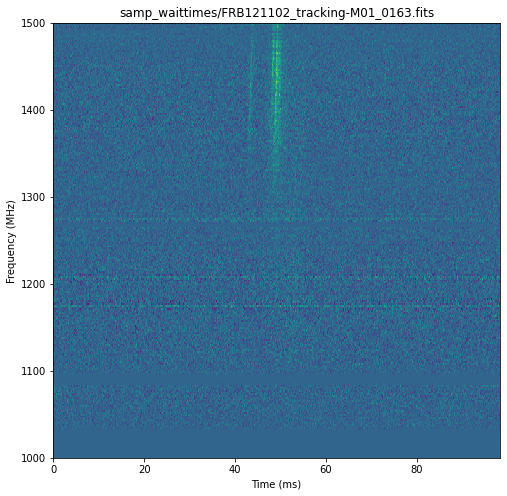

Reading bursts:  30%|███████████████████▊                                             | 7/23 [56:18<2:05:17, 469.82s/it]

/mnt/e/Li2021/samp_waittimes/FRB121102_tracking-M01_0179.fits 564.3
data loaded: (4096, 131072)
(4096, 131072)
(256, 131072)


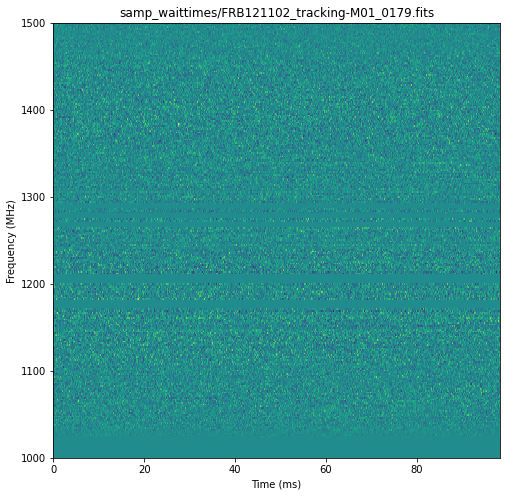

Reading bursts:  35%|█████████████████████▉                                         | 8/23 [1:02:53<1:51:50, 447.38s/it]

/mnt/e/Li2021/samp_waittimes/FRB121102_tracking-M01_0221.fits 564.7
data loaded: (4096, 131072)
(4096, 131072)
(256, 131072)


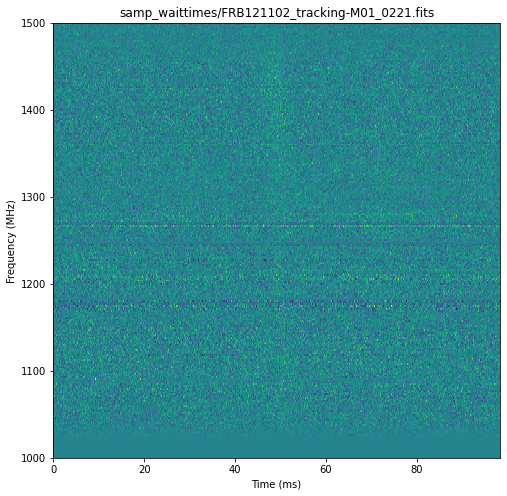

Reading bursts:  39%|████████████████████████▋                                      | 9/23 [1:09:55<1:42:36, 439.75s/it]

/mnt/e/Li2021/samp_waittimes/FRB121102_tracking-M01_0238.fits 568.2
data loaded: (4096, 131072)
(4096, 131072)
(256, 131072)


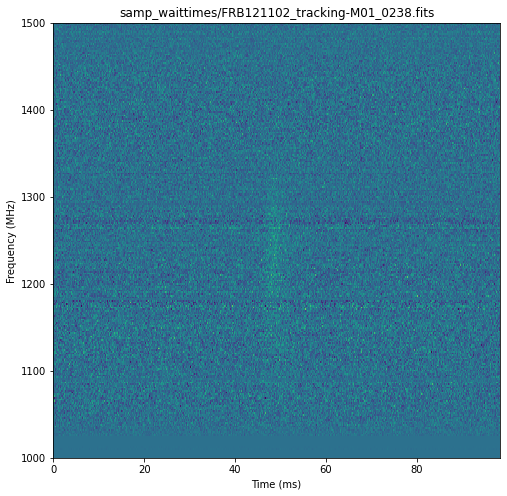

Reading bursts:  43%|██████████████████████████▉                                   | 10/23 [1:17:08<1:34:48, 437.59s/it]

/mnt/e/Li2021/samp_waittimes/FRB121102_tracking-M01_0264.fits 564.2
data loaded: (4096, 131072)
(4096, 131072)
(256, 131072)


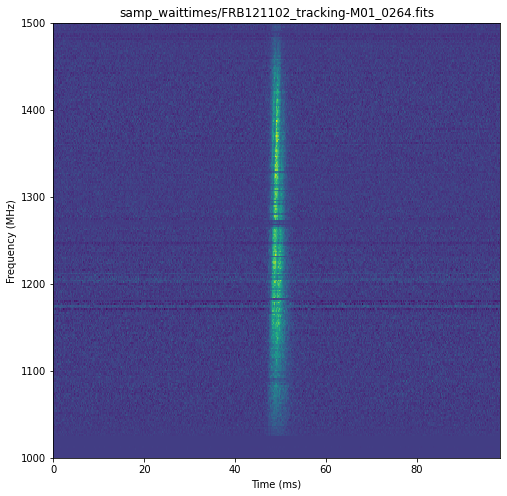

Reading bursts:  48%|█████████████████████████████▋                                | 11/23 [1:23:58<1:25:54, 429.53s/it]

/mnt/e/Li2021/samp_waittimes/FRB121102_tracking-M01_0388.fits 564.5
data loaded: (4096, 131072)
(4096, 131072)
(256, 131072)


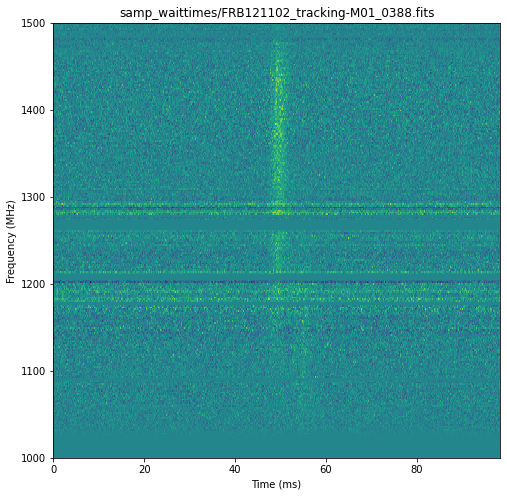

Reading bursts:  52%|████████████████████████████████▎                             | 12/23 [1:31:10<1:18:51, 430.15s/it]

/mnt/e/Li2021/samp_waittimes/FRB121102_tracking-M01_0415.fits 564.6
data loaded: (4096, 131072)
(4096, 131072)
(256, 131072)


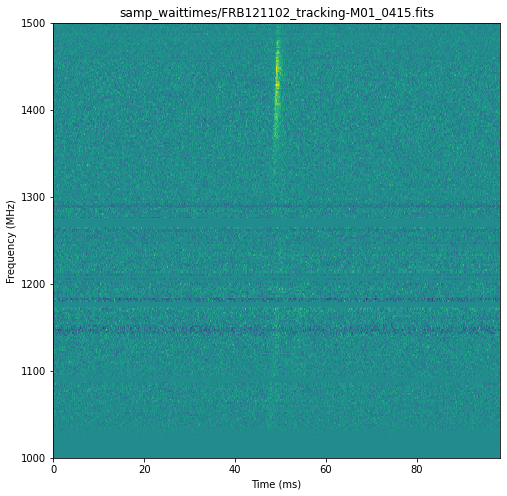

Reading bursts:  57%|███████████████████████████████████                           | 13/23 [1:38:07<1:11:04, 426.40s/it]

/mnt/e/Li2021/samp_waittimes/FRB121102_tracking-M01_0487.fits 563.6
data loaded: (4096, 131072)
(4096, 131072)
(256, 131072)


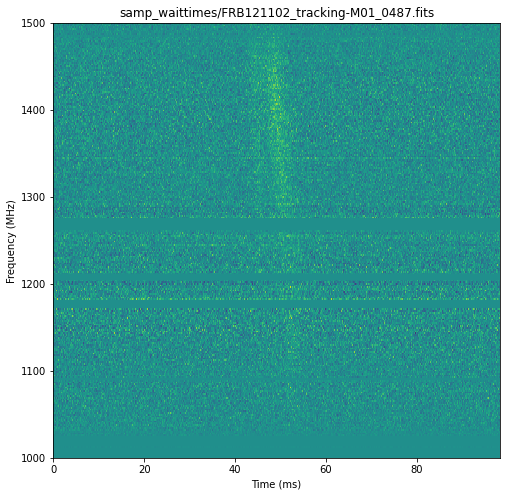

Reading bursts:  61%|█████████████████████████████████████▋                        | 14/23 [1:46:00<1:06:03, 440.38s/it]

/mnt/e/Li2021/samp_waittimes/FRB121102_tracking-M01_0576.fits 562.5
data loaded: (4096, 131072)
(4096, 131072)
(256, 131072)


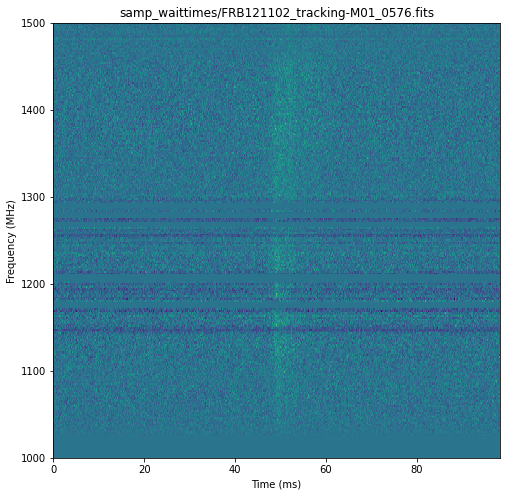

Reading bursts:  65%|█████████████████████████████████████████▋                      | 15/23 [1:52:49<57:27, 430.89s/it]

/mnt/e/Li2021/samp_waittimes/FRB121102_tracking-M01_0630.fits 564.0
data loaded: (4096, 131072)
(4096, 131072)
(256, 131072)


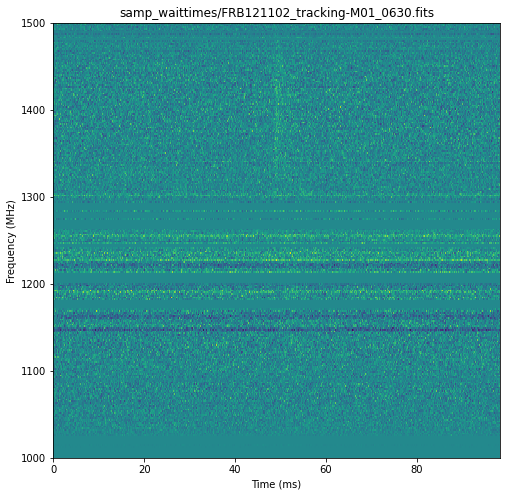

Reading bursts:  70%|████████████████████████████████████████████▌                   | 16/23 [2:00:12<50:41, 434.47s/it]

/mnt/e/Li2021/samp_waittimes/FRB121102_tracking-M01_0634.fits 564.9
data loaded: (4096, 131072)
(4096, 131072)
(256, 131072)


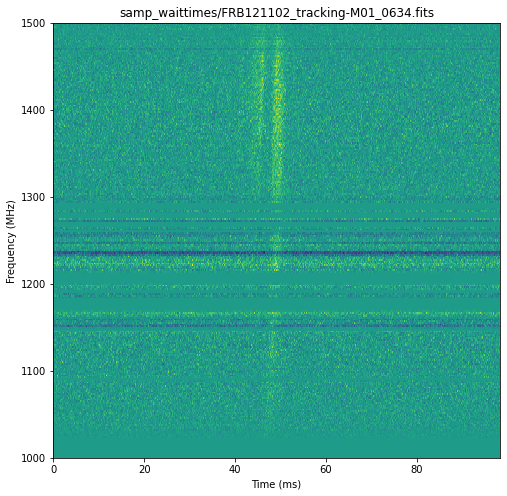

Reading bursts:  74%|███████████████████████████████████████████████▎                | 17/23 [2:07:50<44:08, 441.42s/it]

/mnt/e/Li2021/samp_waittimes/FRB121102_tracking-M01_0774.fits 566.2
data loaded: (4096, 131072)
(4096, 131072)
(256, 131072)


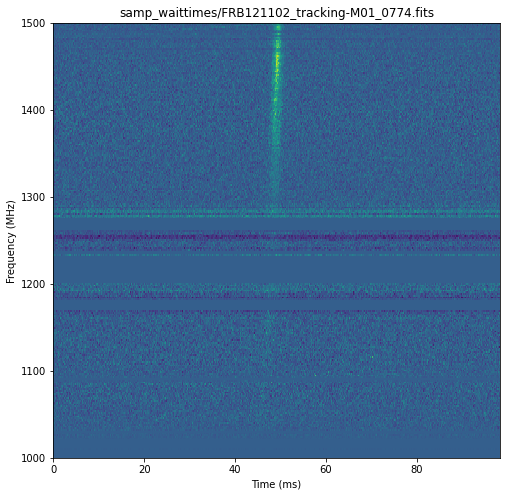

Reading bursts:  78%|██████████████████████████████████████████████████              | 18/23 [2:15:34<37:20, 448.14s/it]

/mnt/e/Li2021/samp_waittimes/FRB121102_tracking-M01_0826.fits 567.7
data loaded: (4096, 131072)
(4096, 131072)
(256, 131072)


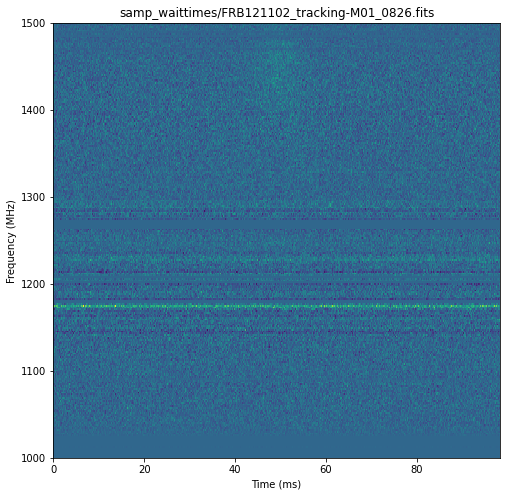

Reading bursts:  83%|████████████████████████████████████████████████████▊           | 19/23 [2:21:53<28:29, 427.41s/it]

/mnt/e/Li2021/samp_waittimes/FRB121102_tracking-M01_0977.fits 564.4
data loaded: (4096, 131072)
(4096, 131072)
(256, 131072)


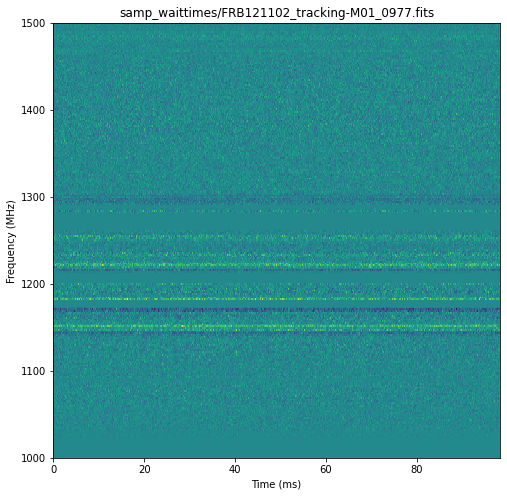

Reading bursts:  87%|███████████████████████████████████████████████████████▋        | 20/23 [2:28:35<21:00, 420.01s/it]

/mnt/e/Li2021/samp_waittimes/FRB121102_tracking-M01_1180.fits 565.4
data loaded: (4096, 131072)
(4096, 131072)
(256, 131072)


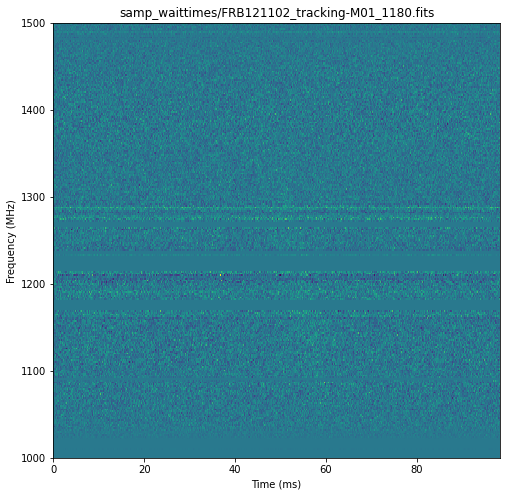

Reading bursts:  91%|██████████████████████████████████████████████████████████▍     | 21/23 [2:35:22<13:52, 416.05s/it]

/mnt/e/Li2021/samp_waittimes/FRB121102_tracking_3-M01_0031.fits 564.2
data loaded: (4096, 131072)
(4096, 131072)
(256, 131072)


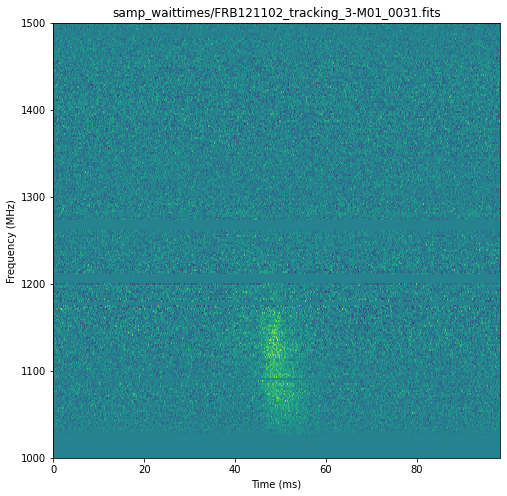

Reading bursts:  96%|█████████████████████████████████████████████████████████████▏  | 22/23 [2:42:31<06:59, 419.89s/it]

/mnt/e/Li2021/samp_waittimes/FRB121102_tracking_3-M01_0153.fits 564.2
data loaded: (4096, 131072)
(4096, 131072)
(256, 131072)


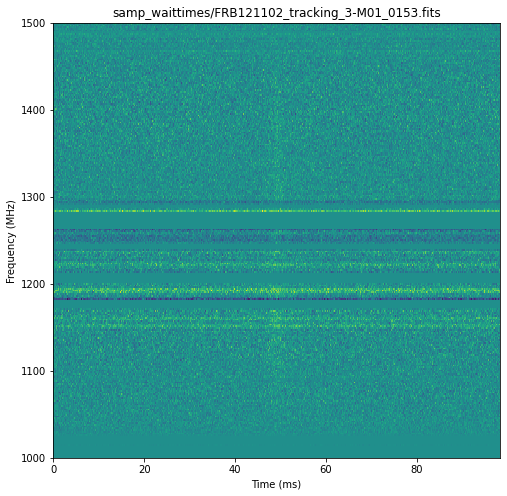

Reading bursts: 100%|████████████████████████████████████████████████████████████████| 23/23 [2:49:17<00:00, 441.65s/it]


In [43]:
import os, glob, itertools
import numpy as np
import matplotlib.pyplot as plt
import pypulse, your
import driftrate, driftlaw
import frbrepeaters
import pandas as pd
from tqdm import tqdm
from your.utils.rfi import sk_sg_filter
from your.utils.rfi import sk_sg_filter
import logging
logging.getLogger().setLevel(logging.ERROR)

# burstfiles = glob.glob('/mnt/e/Li2021/samp*/*.fits')
# samplecsvs = ['data/li2019/longbursts.csv', 'data/li2019/peak1sample.csv', 'data/li2019/peak2sample.csv']
burstfiles = glob.glob('/mnt/e/Li2021/samp_waittimes/*.fits')
samplecsvs = ['data/li2019/waittimesample.csv']
sampledfs  = pd.concat([pd.read_csv(s).set_index('PulseID') for s in samplecsvs])
dms = sampledfs['DM']

for filename, dm in tqdm(zip(burstfiles, dms), desc='Reading bursts', total=len(burstfiles)):
    # if filename != '/mnt/e/Li2021/samp_longduration/FRB121102_tracking_3-M01_0178.fits':
    #     continue
    print(filename, dm)
    burst = your.Your(filename)
    bandwidth = burst.your_header.bw
    lowest_freq = burst.your_header.fch1
    dt = burst.your_header.tsamp*1000
    df = burst.your_header.foff
    nspectra = burst.your_header.nspectra
    duration = dt*nspectra
    
    wfall = burst.get_data(nstart=0, nsamp=nspectra).T
    print('data loaded:', wfall.shape)

    sksgmask = sk_sg_filter(wfall.T, burst, savgol_frequency_window=15)
    wfall[sksgmask, :] = 0

    wfall = driftrate.dedisperse(wfall, dm, lowest_freq, df, dt)
    print(wfall.shape)
    subfall = driftrate.subsample(wfall, 256, wfall.shape[1])
    subfall = driftrate.subtractbg(subfall, 0, 1000)
    df, dt = bandwidth/subfall.shape[0], duration/subfall.shape[1]
    print(subfall.shape)

    ts    = np.nanmean(subfall, axis=0)
    pkidx = np.nanargmax(ts)
    twidth = 500
    subfall = subfall[..., pkidx-twidth:pkidx+twidth]

    plt.figure(figsize=(8,8))
    extents, correxts = driftrate.getExtents(subfall, df=df, dt=dt, lowest_freq=lowest_freq)
    title = '/'.join(filename.split('/')[-2:])
    
    plt.imshow(subfall, origin='lower', interpolation='none', aspect='auto', extent=extents)
    plt.xlabel("Time (ms)"); plt.ylabel("Frequency (MHz)")
    plt.title(title)
    plt.show()
    
    burstmetadata = {
        'dt'        : dt,
        'dfs'       : extents[2:],
        'DM'        : dm,
        'bandwidth' : bandwidth,
        'duration'  : extents[1]/1000, # usually in seconds
        'center_f'  : burst.your_header.center_freq,
        'freq_unit' : 'MHz',
        'time_unit' : 's',
        'int_unit'  : 'mJy', # not sure
        'telescope' : 'FAST',
        'burstSN'   : -1,
        'tbin'      : burst.your_header.nspectra, #??
    }
    np.savez(filename.split('.fits')[0], wfall=subfall, **burstmetadata)

Unified Header:
  "basename": "FRB121102_tracking-M01_0405"
  "bw": 500.0
  "center_freq": 1250.0
  "dec_deg": -12.582441388888888
  "dtype": "uint8"
  "fch1": 1000.0
  "filelist": [
    "data/li2019/FRB121102_tracking-M01_0405.fits"
  ]
  "filename": "data/li2019/FRB121102_tracking-M01_0405.fits"
  "foff": 0.1220703125
  "format": "fits"
  "frequency_decimation_factor": 1
  "gb": 50.088153193929415
  "gl": 116.65328579971941
  "native_foff": 0.1220703125
  "native_nbits": 8
  "native_nchans": 4096
  "native_nspectra": 131072
  "native_tsamp": 9.8304e-05
  "nbits": 8
  "nchans": 4096
  "npol": 4
  "nspectra": 131072
  "poln_order": "AABBCRCI"
  "ra_deg": 188.7366208333333
  "source_name": "J2000-1234"
  "time_decimation_factor": 1
  "tsamp": 9.8304e-05
  "tstart": 58729.07883102692
  "tstart_utc": "2019-09-03T01:53:31.001"

(4096, 131072)
(4096, 131072)
(256, 131072)


Text(0, 0.5, 'Frequency (MHz)')

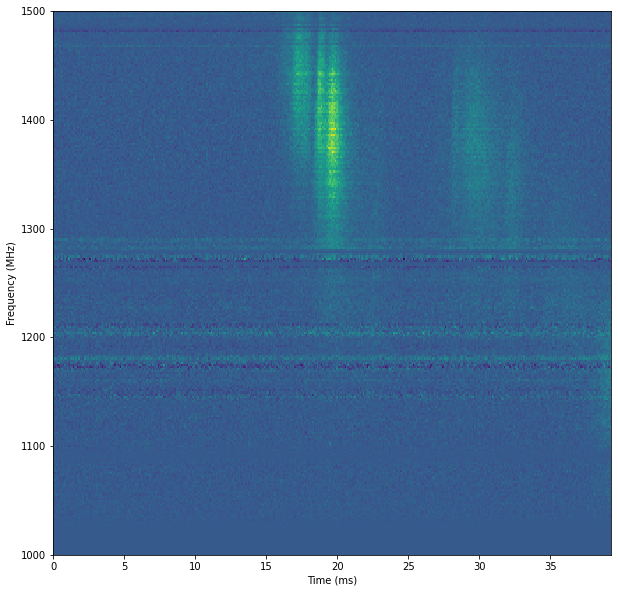

In [42]:
import os, glob, itertools
import numpy as np
import matplotlib.pyplot as plt
import pypulse, your
import driftrate, driftlaw
import frbrepeaters
import pandas as pd
from your.utils.rfi import sk_sg_filter
from your.utils.rfi import sk_sg_filter
import logging
logging.getLogger().setLevel(logging.ERROR)

filename = 'data/li2019/FRB121102_tracking-M01_0405.fits'

burst = your.Your(filename)
print(burst.your_header)
bandwidth = burst.your_header.bw
lowest_freq = burst.your_header.fch1
dt = burst.your_header.tsamp*1000
df = burst.your_header.foff
nspectra = burst.your_header.nspectra
duration = dt*nspectra

# burstmetadata = {
#     'dt'        : ar.getTimes(),
#     'dfs'       : ar.getFreqs(),
#     'DM'        : ar.getDM(),
#     'bandwidth' : ar.getBandwidth(),
#     'duration'  : ar.getDuration(), # usually in seconds
#     'center_f'  : ar.getCenterFrequency(),
#     'freq_unit' : ar.getFrequencyUnit(),
#     'time_unit' : ar.getTimeUnit(),
#     'int_unit'  : ar.getIntensityUnit(),
#     'telescope' : ar.getTelescope(),
#     'burstSN'   : ar.getSN(),
#     'tbin'      : ar.getTbin(),
# }

wfall = burst.get_data(nstart=0, nsamp=nspectra).T
print(wfall.shape)

# sksgmask = sk_sg_filter(wfall.T, burst, savgol_frequency_window=15)
wfall[sksgmask, :] = 0

wfall = driftrate.dedisperse(wfall, 563.5, lowest_freq, df, dt)
print(wfall.shape)
subfall = driftrate.subsample(wfall, 256, wfall.shape[1])
subfall = driftrate.subtractbg(subfall, 0, 1000)
df, dt = bandwidth/subfall.shape[0], duration/subfall.shape[1]
print(subfall.shape)

ts    = np.nanmean(subfall, axis=0)
pkidx = np.nanargmax(ts)
twidth = 200
subfall = subfall[..., pkidx-twidth:pkidx+twidth]

plt.figure(figsize=(10,10))
extents, correxts = driftrate.getExtents(subfall, df=df, dt=dt, lowest_freq=lowest_freq)
plt.imshow(subfall, origin='lower', interpolation='none', aspect='auto', extent=extents)
plt.xlabel("Time (ms)"); plt.ylabel("Frequency (MHz)")


## Results PDF

In [3]:
import importlib
import warnings
warnings.filterwarnings("ignore")
importlib.reload(driftrate)

# filename = 'results/FRB121102_Li_waittimes_1592rows_Apr08.csv'
# files = glob.glob('/mnt/e/Li2021/samp_wait*/*.npz')
# masks = np.load('li_masks_Apr04.npy', allow_pickle=True)[0]
# mask2 = np.load('li_masks_Apr08.npy', allow_pickle=True)[0]
# masks.update(mask2)
# np.save('li_masks_may3', [masks])
masks = np.load('li_masks_may3.npy', allow_pickle=True)[0]
# driftrate.plotResults(filename, datafiles=files, masks=masks)

filename = 'results/FRB121102_Li_waittimes_1758rows_May04.csv'
files = glob.glob('/mnt/e/Li2021/samp_*/*.npz')
driftrate.plotResults(filename, datafiles=files, masks=masks)

results/FRB121102_Li_waittimes_1758rows_May04.pdf
plotting FRB121102_tracking-M01_0055
plotting FRB121102_tracking-M01_0055_a
plotting FRB121102_tracking-M01_0055_b
plotting FRB121102_tracking-M01_0095
plotting FRB121102_tracking-M01_0095_a
plotting FRB121102_tracking-M01_0095_b
plotting FRB121102_tracking-M01_0103
plotting FRB121102_tracking-M01_0163
plotting FRB121102_tracking-M01_0163_a
plotting FRB121102_tracking-M01_0163_b
plotting FRB121102_tracking-M01_0163_c
plotting FRB121102_tracking-M01_0221
plotting FRB121102_tracking-M01_0238
plotting FRB121102_tracking-M01_0264
plotting FRB121102_tracking-M01_0264_a
plotting FRB121102_tracking-M01_0264_b
plotting FRB121102_tracking-M01_0264_c
plotting FRB121102_tracking-M01_0388
plotting FRB121102_tracking-M01_0388_a
plotting FRB121102_tracking-M01_0388_b
plotting FRB121102_tracking-M01_0415
plotting FRB121102_tracking-M01_0415_a
plotting FRB121102_tracking-M01_0415_b
plotting FRB121102_tracking-M01_0415_c
plotting FRB121102_tracking-M01_

True

# Michilli et al. 2018

In [106]:
files = glob.glob('/mnt/b/dev/subdriftlaw/data/*.DD.ASCII')
# michillidf = pd.read_csv('/mnt/b/dev/subdriftlaw/bursts.csv').set_index('name')[:16]
michillidf = pd.read_csv('/mnt/b/dev/subdriftlaw/michilli.csv').set_index('name')
display(michillidf)
for filename, row in tqdm(zip(files, michillidf.iterrows()), total=len(files)):
    burstname, burst = row[0], row[1]

,filename,edge,angle,peak,sigmax,sigmay,Slope,drift (mhz/ms),drift error (mhz/ms),center,center_f,time_res,freq_res,sigmax_error,sigmay_error,angle_error,red_chisq,stale?
name,,,,,,,,,,,,,,,,,,
M001,01_puppi_57747_C0531+33_0558_5.dm559.72.calibP...,1525.0,1.720000,10429.0,173.731526,47.364587,-6.652439,-1039.359422,0.190767,228.755888,4458.212325,0.00001,1.5625,0.011140,0.003007,0.000026,9.733683,NaN
M002,02_puppi_57747_C0531+33_0558_1183.dm559.72.cal...,1850.0,1.780000,5692.0,177.080918,44.911875,-4.736866,-740.578566,0.652317,209.060564,4427.438381,0.00001,1.5625,0.081784,0.020486,0.000174,3.818413,NaN
M003,03_puppi_57747_C0531+33_0558_1202.dm559.72.cal...,1975.0,1.620000,5668.0,169.749001,19.463885,-19.669528,-2823.770453,2.623174,249.051665,4489.924477,0.00001,1.5625,0.052822,0.005950,0.000050,4.049445,NaN
M004,04_puppi_57747_C0531+33_0558_25437.dm559.72.ca...,1450.0,1.710000,5038.0,160.360329,26.706231,-7.137257,-1104.756403,21.768613,322.029396,4603.952181,0.00001,1.5625,1.780140,0.292807,0.002672,3.318850,NaN
M005,05_puppi_57747_C0531+33_0558_3683.dm559.72.cal...,1450.0,1.639204,5031.0,37.747383,166.280492,-14.595503,-2111.819665,67.749909,214.396765,4435.776195,0.00001,1.5625,0.258022,1.153948,0.002306,3.360715,NaN
M006,06_puppi_57747_C0531+33_0558_3687.dm559.72.cal...,1150.0,1.590000,5569.0,156.557708,12.416683,-52.066970,-6051.049490,11.249634,263.938012,4513.184394,0.00001,1.5625,0.065385,0.005173,0.000047,6.719788,NaN
M007,07_puppi_57747_C0531+33_0558_3688.dm559.72.cal...,1590.0,1.720000,5821.0,102.259272,38.969184,-6.652439,-1019.972935,0.845772,160.167242,4351.042566,0.00001,1.5625,0.019954,0.007547,0.000121,6.302707,NaN
M008,08_puppi_57747_C0531+33_0558_3689.dm559.72.cal...,2000.0,1.990000,5666.0,171.395398,64.792725,-2.244076,-340.369797,0.064490,296.067560,4563.386812,0.00001,1.5625,0.019619,0.007370,0.000071,6.146570,NaN
M009,09_puppi_57747_C0531+33_0558_3690.dm559.72.cal...,1600.0,2.240000,5041.0,133.024941,89.628038,-1.264288,-191.720931,5.297999,216.215087,4438.617323,0.00001,1.5625,1.038778,0.697559,0.013465,3.361416,"dont use, see 9a,b"


100%|████████████████████████████████████████████████████████████████████████████████| 16/16 [00:00<00:00, 11212.84it/s]


100%|███████████████████████████████████████████████████████████████████████████████████| 16/16 [01:41<00:00,  6.35s/it]


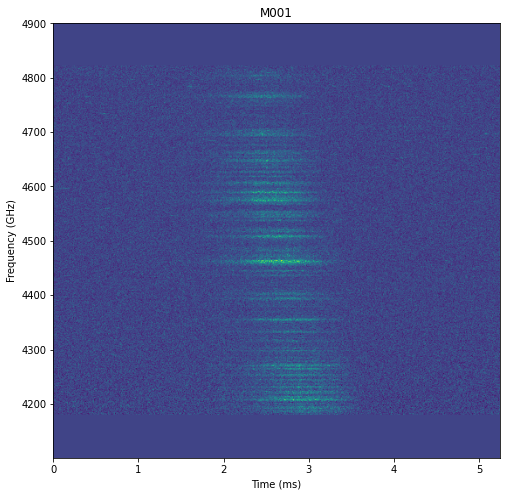

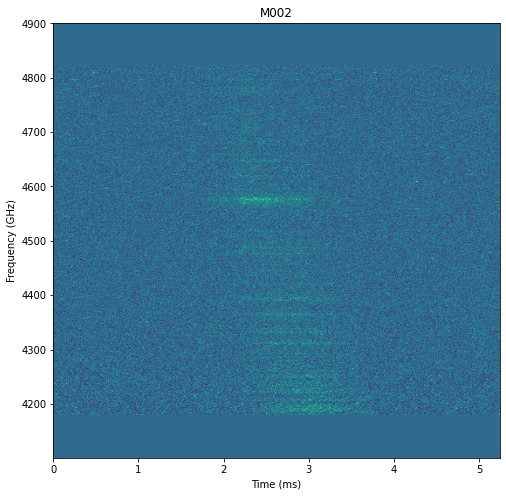

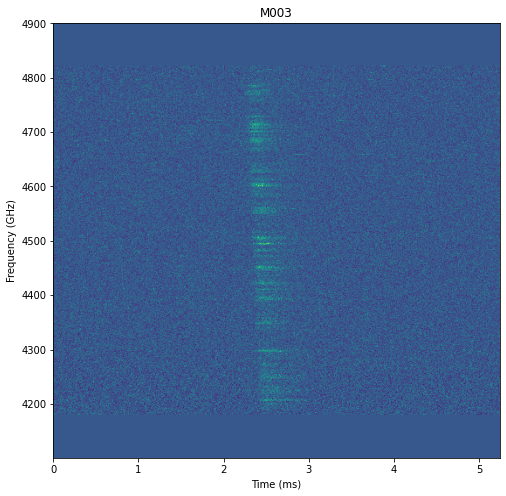

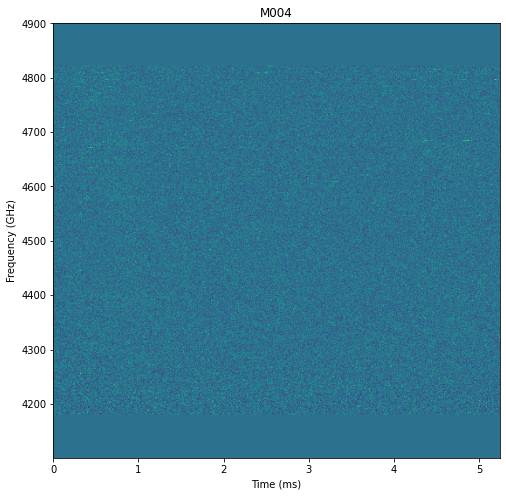

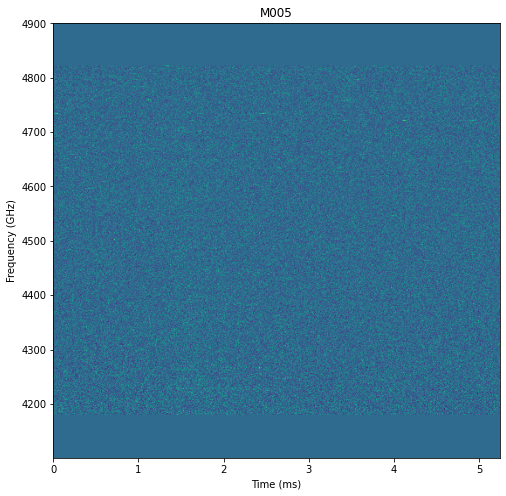

...

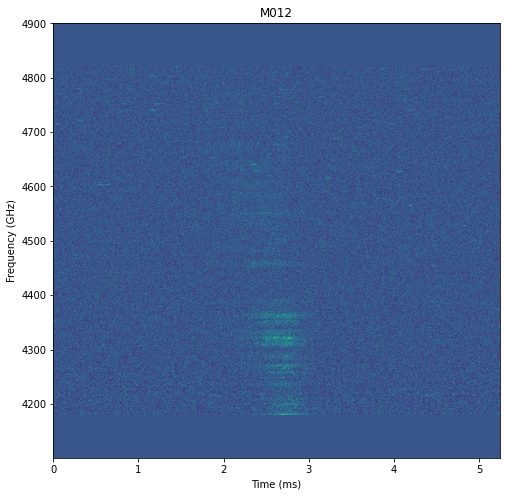

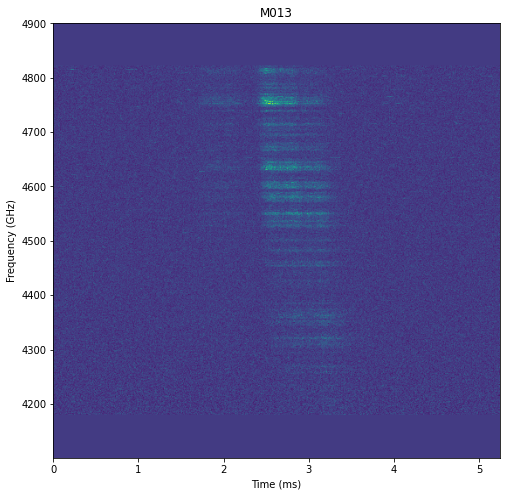

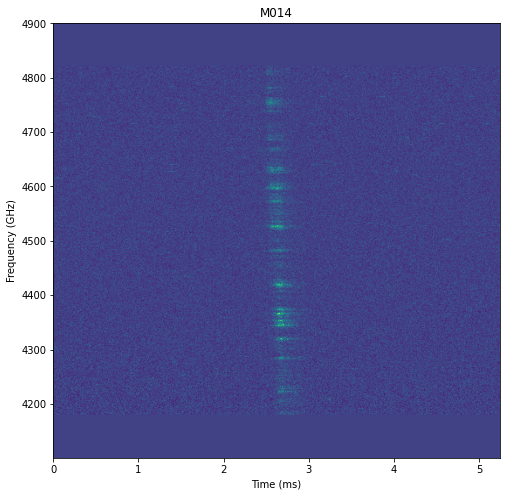

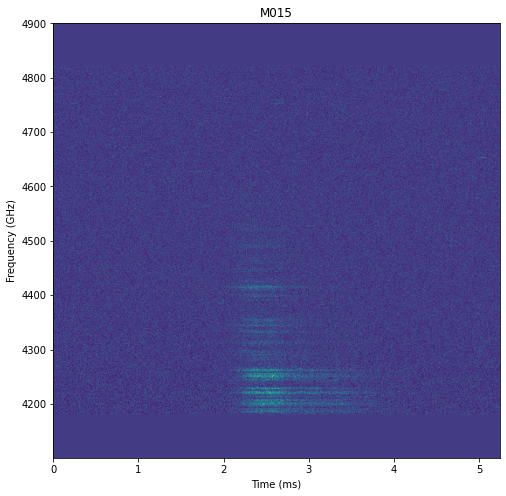

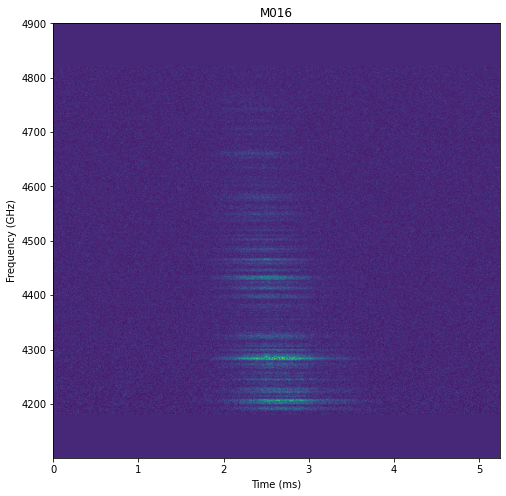

In [108]:

centerDM = 559.7 # pc/cm^3
files = glob.glob('/mnt/b/dev/subdriftlaw/data/*.DD.ASCII')
michillidf = pd.read_csv('/mnt/b/dev/subdriftlaw/michilli.csv').set_index('name')

for filename, row in tqdm(zip(files, michillidf.iterrows()), total=len(files)):
    burstname, burst = row[0], row[1]
    edge = burst['edge']

    # print('processing {}'.format(filename))
    #junk, nchan, nbin, I, Q, U, V = np.loadtxt('{}/{}'.format(folder, filename), delimiter=' ', unpack=True)
    #Q, U, V = None, None, None

    junk, nchan, nbin, I = [], [], [], []
    with open(filename) as infile:
        for line in infile:
            junki, nchani, nbini, Ii, _, _, _ = line.split(' ')
            junk.append(junki)
            nchan.append(nchani)
            nbin.append(nbini)
            I.append(Ii)
    junk  = np.array(junk, dtype=float)
    nchan = np.array(nchan, dtype=float)
    nbin  = np.array(nbin, dtype=float)
    I     = np.array(I, dtype=float)

    n = len(junk)
    edge = int(edge)
    # print("Data loaded")

    binmax = int(nbin[n-1])+1
    frequencymax = (int(nchan[n-1])+1)
    intensity = np.zeros((frequencymax, binmax))

    X = np.zeros(binmax)
    Y = np.zeros(frequencymax)

    # what are these?
    tmin = 500 
    tmax = 1500

    #### 1. remove noise
    intensitynoise1 = np.zeros(tmin-1)
    intensitynoise2 = np.zeros(binmax-tmax)
    for i in tqdm(range(frequencymax-50,51,-1), desc='noise removal', disable=True):

        Y[i-1] = 4.15 + (i-1) * 1.5625 # ?

        for j in range(1,tmin) :

            intensitynoise1[j-1] = (I[j-1 + binmax*(frequencymax-i)])/(tmin-1)


        for j in range(tmax+1,binmax+1) :

            intensitynoise2[j-1-tmax] = (I[j-1 + binmax*(frequencymax-i)])/(binmax-tmax)

        a = sum(intensitynoise1)
        b = sum(intensitynoise2)

        for j in range(1,binmax+1) :
            X[j-1] = j-1
            intensity[i-1,j-1] = I[j-1 + binmax*(frequencymax-i)] - (a+b)/2

    burstwindow = intensity[:,edge:edge+frequencymax]
    # def dedisperse(intensity, DM, nu_low, df_mhz, dt_ms, cshift=0):
    # burstwindow = driftrate.dedisperse(burstwindow, centerDM, 4100.78125, 1.5625, 0.01024)
    
    dt_ms = 0.01024
    df_mhz = 1.5625
    lowest_f = 4100.78125
    extents = [0, 
       10.24e-6 * burstwindow.shape[-1] * 1e3, 
       4100.78125, 
       (4100.78125 + 1.5625*burstwindow.shape[-2])]
    bandwidth = extents[3] - extents[2]
    fontsize=10
    
    plt.figure(figsize=(8,8))
    plt.title(burstname)
    plt.imshow(burstwindow, aspect='auto', origin="lower", extent=extents)
    plt.xlabel("Time (ms)", size=fontsize)
    plt.ylabel("Frequency (GHz)", size=fontsize)
    
    burstmetadata = {
        'dt'        : dt_ms,
        'dfs'       : extents[2:],
        'DM'        : centerDM,
        'bandwidth' : bandwidth,
        'duration'  : extents[1]/1000, # usually in seconds
        'center_f'  : lowest_f+bandwidth/2,
        'freq_unit' : 'MHz',
        'time_unit' : 's',
        'int_unit'  : 'mJy', # not sure
        'telescope' : 'Arecibo',
        'burstSN'   : -1,
        'tbin'      : burstwindow.shape[1], #??
    }
    np.savez(f'data/michilli2018/{burstname}.npz', wfall=burstwindow, **burstmetadata)

# Scholz et al. 2016

saved ../guppi_57339_FRB121102_0004_fullsplit_0004_wfall_bpass_masked_full_498.frbgui.npz
saved ../puppi_57364_C0531+33_4998_ds_fullsplit_0001_wfall_bpass_masked_full_129.frbgui.npz
saved ../guppi_57345_FRB121102_0002_fullsplit_0003_wfall_bpass_masked_full_324.frbgui.npz
saved ../guppi_57345_FRB121102_0002_fullsplit_0004_wfall_bpass_masked_full_78.frbgui.npz
saved ../guppi_57345_FRB121102_0002_fullsplit_0002_wfall_bpass_masked_full_596.frbgui.npz
saved ../guppi_57345_FRB121102_0002_fullsplit_0004_wfall_bpass_masked_full_494.frbgui.npz


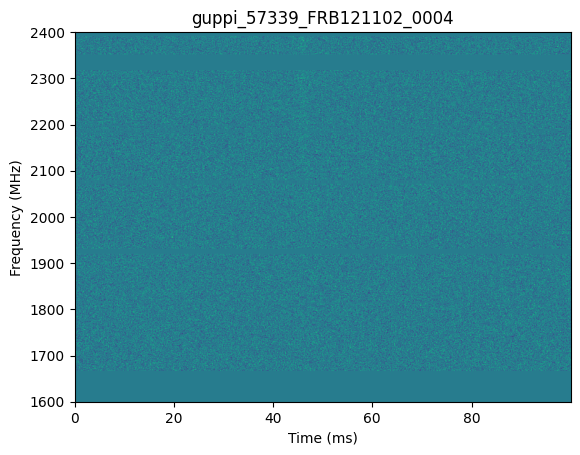

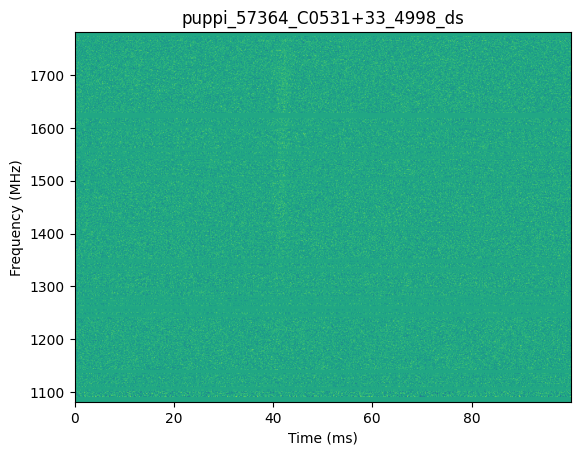

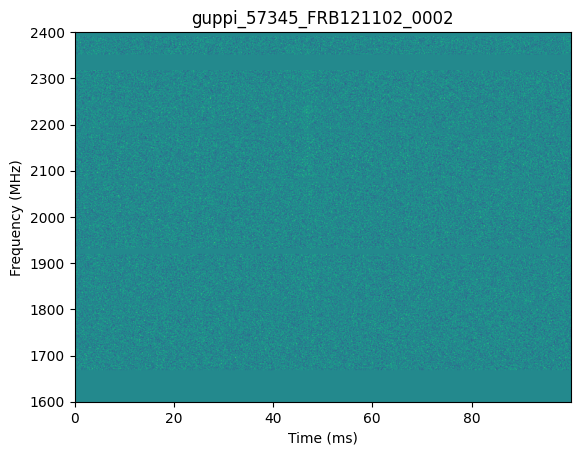

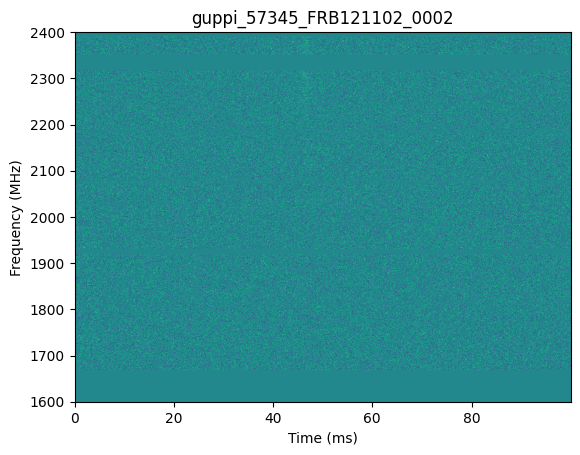

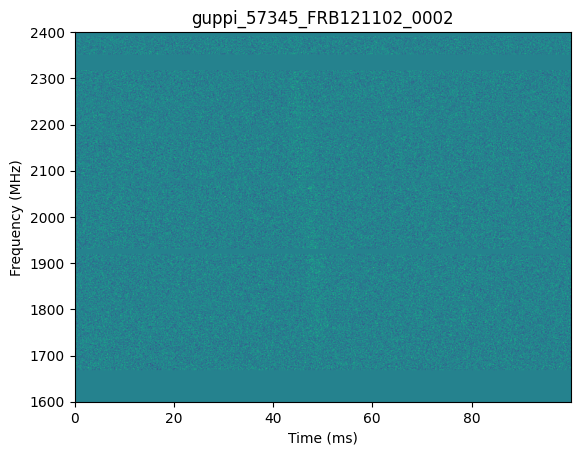

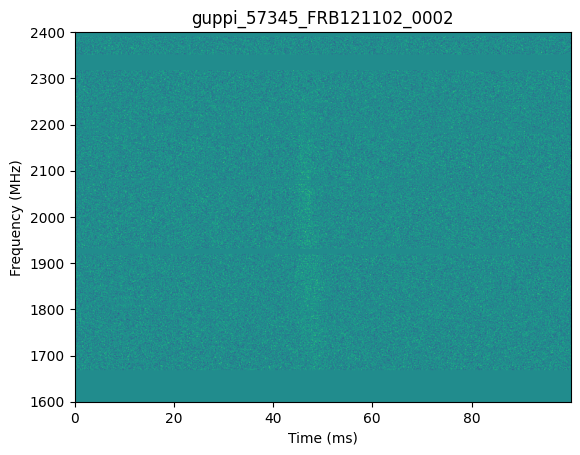

In [95]:
files = glob.glob('data/scholz2016/uppi_full_res/*.npz')
DM = 559.0

for file in files:
    data = np.load(file)
    plt.figure()
    spec = data['data']
    freqs = data['freqs']
    times = data['times']*1000
    bandwidth = freqs[-1] - freqs[0]
    duration = (times[-1] - times[0])/1000

    extent, _ = driftrate.getExtents(spec, abs(freqs[1]-freqs[0]), abs(times[1]-times[0]), min(freqs))
    # print(bandwidth, duration)
    # print(extent)
    plt.imshow(data['data'], extent=extent, aspect='auto')
    plt.xlabel("Time (ms)")
    plt.ylabel("Frequency (MHz)")
    plt.title(file.split('/')[-1].split('_fullsplit')[0])

    # save for frbgui
    filename = file.split('/')[-1].split('.')[0]+'.frbgui.npz'
    burstmetadata = {
        'dfs'       : freqs,# array of frequency channels in MHz,
        'DM'        : DM, # dispersion measure (DM) in pc/cm^3, float
        'bandwidth' : bandwidth,# bandwidth of `wfall` in MHz, float
        'duration'  : duration,# duration of `wfall` in seconds, float
        'telescope' : "GBT", # string of observing telescope, e.g. 'Arecibo', optional,
    }
    np.savez('data/scholz2016/'+filename, wfall=spec, **burstmetadata); print(f"saved ../{filename}")

# Bethapudi et al. 2022

dict_keys(['wfall', 'dt', 'dfs', 'DM', 'bandwidth', 'duration'])
(2048, 760) 348.82 4000.48828125 5999.51171875
(2048, 100)
df_mhz = 0.9765625, dt_ms = 0.13157894736842105 lowest_freq = 4000.48828125


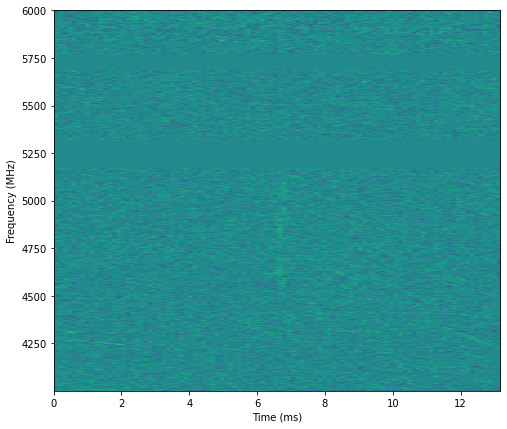

In [42]:
data = np.load('data/bethapudi2022/old/Ba1_fix.npz')
data = dict(data)
print(data.keys())
wfall = data['wfall'].T # transpose array
# wfall = np.flipud(wfall) # is the array upside down?
print(wfall.shape, data['DM'], min(data['dfs']), max(data['dfs']))

df_mhz = data['bandwidth']/wfall.shape[0]
dt_ms = data['duration'] / wfall.shape[1]*1000
lowest_freq = min(data['dfs'])

wfall = driftrate.dedisperse(wfall, 348.82, min(data['dfs']), df_mhz, dt_ms) # data needs to be dedispersed completely
wfall = driftrate.subtractbg(wfall, 0, 100)   # subtract background noise
wfall = driftrate.cropwfall(wfall, twidth=50) # center the burst
# Noise
wfall[1725:1810] = 0
wfall[1200:1350] = 0

# do we need to downsample to see the burst?
# f_factor = 8
# wfall = driftrate.subsample(wfall, wfall.shape[0]//f_factor, wfall.shape[1]) 
# df_mhz *= f_factor

print(wfall.shape)
print(f"{df_mhz = }, {dt_ms = } {lowest_freq = }")
extent, corrextents = driftrate.getExtents(wfall, df=df_mhz, dt=dt_ms, lowest_freq=lowest_freq)

plt.figure(figsize=(8, 7))
plt.imshow(wfall, aspect='auto', origin='lower', extent=extent)
plt.xlabel("Time (ms)")
plt.ylabel("Frequency (MHz)")

data['wfall'] = wfall
data['duration'] = extent[1]/1000 # update with new duration in seconds
np.savez('data/bethapudi2022/Ba1_fix_transpose_dedisperse_center.npz', **data, allow_pickle=True)

# Josephy et al. 2019

,tau_w_ms
name,
C1,26.9


,angle,theta,angle_error,sigmax,sigmay,sigmax_error,sigmay_error,slope (mhz/ms),slope error (mhz/ms),center_f,time_res,time_res (s),freq_res,tau_w_ms,tau_w,tau_w_error,red_chisq,slope_over_nuobs
name,,,,,,,,,,,,,,,,,,
C1,1.9077,1.9077,0.1,184,63,1,1,-3.92,0.01,630,0.003,3.0,3,26.9,0.0269,0.12,1,0.006222


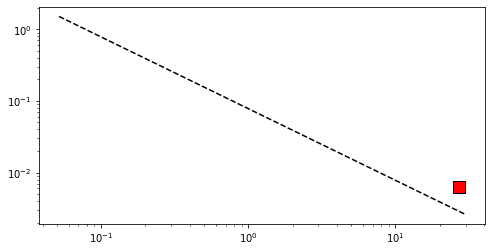

In [51]:
C1data = ['C1', 1.9077, 184, 63, -3.92, 0.01, 630, 0.003, 3, 11.4, 11.4/1000, 0.12, 1] # may 28 2020
josephyburst = pd.DataFrame([C1data], columns=['name', 'angle', 'sigmax', 'sigmay', 'slope (mhz/ms)', 'slope error (mhz/ms)', 'center_f', 'time_res', 'freq_res', 'tau_w_ms', 'tau_w', 'tau_w_error', 'red_chisq']).set_index('name')

# tw = np.mean([3.1, 10.1, 7]) # average of durations in table 1
tw = 26.9 # duration from figure 1
# tw = 11.4 # my mystery duration from may 28 2020
C1data = ['C1', 1.9077, 1.9077, 0.1, 184, 63, 1, 1, -3.92, 0.01, 630, 0.003, 0.003*1000, 3, tw, tw/1000, 0.12, 1]
josephyburst = pd.DataFrame([C1data], columns=['name', 'angle', 'theta', 'angle_error', 'sigmax', 'sigmay', 'sigmax_error', 'sigmay_error', 'slope (mhz/ms)', 'slope error (mhz/ms)', 'center_f', 'time_res', 'time_res (s)', 'freq_res', 'tau_w_ms', 'tau_w', 'tau_w_error', 'red_chisq']).set_index('name')
# josephyburst = driftlaw.computeModelDetails(josephyburst)
josephyburst['slope_over_nuobs'] = -1*josephyburst['slope (mhz/ms)']/josephyburst['center_f']
# xerr, yerr = driftlaw.modelerror(josephyburst)

plt.figure(figsize=(8, 4))
plt.scatter(josephyburst['tau_w_ms'], josephyburst['slope_over_nuobs'], c='r', s=125, edgecolors='k', marker='s', label='FRB20121102A Josephy et al. (2019)')
plt.gca().set_yscale('log'); plt.gca().set_xscale('log')
plt.errorbar(josephyburst['tau_w_ms'], josephyburst['slope_over_nuobs'], xerr=xerr[0], yerr=yerr[0], ecolor='r')
xlim, ylim = (0.051633323078591635, 19.650999684989646), (0.0014031099752617444, 11.853834155691562)

# plt.xlim(xlim), plt.ylim(ylim)
display(josephyburst[['tau_w_ms']])
display(josephyburst)
x = np.linspace(xlim[0], xlim[1]+10, num=1200)
plt.plot(x, 0.078/x, 'k--')

# Migrate Masks

In [118]:
# gdata['masks'][gdata['currfile']] = {'chans':[], 'ranges':{}}
migratedmasks = {}
masks = np.load('aggarwalmasks_sept12.npy', allow_pickle=True)[0]
for burstfile, mask in masks.items():
    # print(burstfile, mask)
    migratedmasks[burstfile] = {'chans': mask, 'ranges': {}}
migratedmasks
np.save('aggarwalmasks_apr20_2022.npy', [migratedmasks])

In [108]:
# gdata['masks'][gdata['currfile']] = {'chans':[], 'ranges':{}}
migratedmasks = {}
masks = np.load('oostrummasks_aug28.npy', allow_pickle=True)[0]
for burstfile, mask in masks.items():
    # print(burstfile, mask)
    migratedmasks[burstfile] = {'chans': mask, 'ranges': {}}
migratedmasks
np.save('oostrummasks_may2_2022.npy', [migratedmasks])

In [29]:
def migrateMasks(oldmask, newmask):
	migratedmasks = {}
	masks = np.load(oldmask, allow_pickle=True)[0]
	for burstfile, mask in masks.items():
		# print(burstfile, mask)
		migratedmasks[burstfile] = {'chans': mask, 'ranges': {}}
	np.save(newmask, [migratedmasks])
	print(f"Saved {newmask}")
	return [migratedmasks]

np.load('li_masks_may3.npy', allow_pickle=True)[0]

{'E:\\Li2021\\samp_waittimes\\FRB121102_tracking-M01_0041.npz': {'chans': [],
  'ranges': {}},
 'E:\\Li2021\\samp_waittimes\\FRB121102_tracking-M01_0055.npz': {'chans': [83,
   84,
   85,
   86,
   87,
   72,
   75,
   73,
   74,
   140,
   141,
   142,
   143,
   144,
   145,
   94,
   93,
   92,
   128,
   129,
   130,
   131,
   132,
   133,
   117,
   119,
   118,
   247,
   248,
   250,
   253,
   112,
   113,
   107,
   108,
   109,
   69,
   70,
   71,
   110,
   111,
   79,
   102,
   150,
   149,
   147,
   146],
  'ranges': {}},
 'E:\\Li2021\\samp_waittimes\\FRB121102_tracking-M01_0630.npz': {'chans': [],
  'ranges': {}},
 'E:\\Li2021\\samp_waittimes\\FRB121102_tracking-M01_0634.npz': {'chans': [],
  'ranges': {}},
 'E:\\Li2021\\samp_waittimes\\FRB121102_tracking-M01_0774.npz': {'chans': [],
  'ranges': {}},
 'E:\\Li2021\\samp_waittimes\\FRB121102_tracking-M01_0826.npz': {'chans': [],
  'ranges': {}},
 'E:\\Li2021\\samp_waittimes\\FRB121102_tracking-M01_0977.npz': {'chans': [

# All PDFs

In [1]:
import os, glob, itertools
import numpy as np
import driftrate, driftlaw
import importlib, warnings
import os, glob, itertools
import matplotlib.pyplot as plt
import pypulse, your
import frbrepeaters
import pandas as pd
from tqdm import tqdm
importlib.reload(driftrate)
warnings.filterwarnings('ignore')
%matplotlib inline

results = [
    # 'results/FRB121102_michilli_924rows_Jul07.csv',
    # 'results/FRB121102_oostrum_1025rows_Jul07.csv',
    # 'results/FRB121102_aggarwal_4785rows_Jul07.csv',
    # 'results/GajjarFRB121102_1092rows_Jul16.csv',
    # 'results/FRB121102_Li_419rows_Jul07.csv',
    # 'results/FRB121102_Li_waittimes_1758rows_Jul07.csv',
    'results/FRB121102_driftratesv2_922rows_Jul17.csv'
]

datadirs = [
    # 'data/michilli2018/*.npz',
    # 'data/oostrum2020/R1_frb121102/*.npz',
    # 'data/aggarwal2021/*.npz',
    # 'data/gajjar2018/*.npz',
    # '/mnt/e/Li2021/samp_peak*/*.npz',
    # '/mnt/e/Li2021/samp_wait*/*.npz',
    'data/driftrates/*.npz'
]

maskfiles = [
    # None, 
    # 'oostrummasks_may2_2022.npy', 
    # 'aggarwalmasks_Jun17_2022.npy', 
    # None, 
    # 'li_masks_may3.npy', 
    # 'li_masks_may3.npy',
    'driftratemasks_jul16_22.npy'
]

for filename, datadir, masks in zip(results, datadirs, maskfiles):
    files = glob.glob(datadir)
    masks = None if not masks else np.load(masks, allow_pickle=True)[0]
    driftrate.plotResults(filename, datafiles=files, masks=masks)    

results/FRB121102_driftratesv2_922rows_Jul17.pdf
plotting 11A
plotting 12A
plotting 12B
plotting B003
plotting B032
plotting B071
plotting B093
plotting B109
plotting B121
plotting FRB121102_tracking-M01_0055
plotting FRB121102_tracking-M01_0095
plotting FRB121102_tracking-M01_0163
plotting FRB121102_tracking-M01_0264
plotting FRB121102_tracking-M01_0388
plotting FRB121102_tracking-M01_0415
plotting FRB121102_tracking-M01_0487
plotting FRB121102_tracking-M01_0576
plotting FRB121102_tracking-M01_0630
plotting FRB121102_tracking-M01_0634
plotting M009
plotting M010
plotting M013


# Combine Measurement Spreadsheets

In [14]:
sheetsdf = pd.concat([pd.read_csv(f).set_index('name') for f in glob.glob('results/*.csv') if 'driftrate' not in f])
datestr = datetime.now().strftime('%b%d')
sheetsdf.to_csv(f'results/AllMeasurements_{len(sheetsdf)}rows_{datestr}.csv')

# Compute Center Frequency Error

In [27]:
import driftrate
import importlib
importlib.reload(driftrate)

def load_and_centerf_err(resultsfile, datafiles=[], masks=None):
    resultsdf = pd.read_csv(resultsfile).set_index('name')

    if type(masks) == str: # filename
        if os.path.exists(masks):
            masks = np.load(masks, allow_pickle=True)[0]

    pname = ''
    center_f_errs = []
    pbar = tqdm(resultsdf.iterrows(), total=len(resultsdf))
    for name, row in pbar:
        if pname != name: 
            # print('processing', name)  # print once
            pbar.set_description(f'processing {name}')
        pname = name
        ismulti = any([suffix in name[-2:] for suffix in driftrate.subburst_suffixes])
        if 'background' in row.index and not np.isnan(row['background']) and ismulti:
            subname = name
            name, suffix = '_'.join(name.split('_')[:-1]), name.split('_')[-1]
            regcols = [col for col in row.index if 'reg' in col]
            regcols.append('background') if 'background' in row.index else None
            regions = {suffix: [row[f'regstart_{suffix}'], row[f'regend_{suffix}']]}
            regions['background'] = [0, row['background']]
        else:
            regions = None

        file = [f for f in datafiles if name in f][0]
        data = np.load(file, allow_pickle=True)

        wfall = data['wfall']
        storedshape = wfall.shape

        df, dt_ms = row['f_res (mhz)'], row['time_res (s)']*1000
        lowest_freq = min(data['dfs']) # off by half a channel probably

        # apply masks
        if masks is not None and masks != []:
            mask = [masks[k] for k in masks.keys() if name in k]
            if mask != []:
                mask = mask[0]['chans']
            for m in mask:
                if m < len(wfall):
                    wfall[m] = 0

        # Check if the waterfall was subsampled before measuring and subsample if so
        if 'downf' in row and 'downt' in row:
            wfall = driftrate.subsample(wfall, int(wfall.shape[0]/row['downf']), int(wfall.shape[1]/row['downt']))
        if 'tsamp_width' in row:
            wfall = driftrate.cropwfall(wfall, twidth=row['tsamp_width']) # crop after subsampling.

        if 'subbg_start (ms)' in row and not np.isnan(row['subbg_start (ms)']):
            tleft, tright = row['subbg_start (ms)'], row['subbg_end (ms)']
            timerange = [0, round(dt_ms*wfall.shape[1])]
            tleft  = round(np.interp(tleft, timerange, [0, wfall.shape[1]]))
            tright = round(np.interp(tright, timerange, [0, wfall.shape[1]]))
            wfall = driftrate.subtractbg(wfall, tleft, tright)

        extents, corrextents = driftrate.getExtents(wfall, df=df, dt=dt_ms, lowest_freq=lowest_freq)
        if regions:
            wfall = driftrate.getSubbursts(wfall, df, dt_ms, lowest_freq, regions)[suffix]
            extents, corrextents = driftrate.getExtents(wfall, df=df, dt=dt_ms, lowest_freq=lowest_freq)

        # dedisperse
        ddm = row['DM'] - data['DM']
        wfall = driftrate.dedisperse(wfall, ddm, lowest_freq, df, dt_ms)

        # and centerf_err
        center_i, errorsumi = driftrate.findCenter(wfall)
        center_f = center_i*df + lowest_freq
        errorsum = errorsumi*df
        wfallsigma = np.std( wfall[:, 0:wfall.shape[1]//20] ) # use the first 5% of channels
        center_f_err = np.sqrt(df**2/12 + 4*wfallsigma**2*errorsum**2)
        center_f_errs.append(center_f_err)
    
    resultsdf['center_f_err'] = center_f_errs
    return resultsdf

        
results = [
    "results/FRB121102_michilli_924rows_Jul07.csv",
    'results/GajjarFRB121102_1092rows_Jul16.csv', 
    'results/FRB121102_oostrum_1025rows_Jul07.csv', 
    'results/FRB121102_aggarwal_4785rows_Jul07.csv',
    'results/FRB121102_Li_419rows_Jul07.csv',
    'results/FRB121102_Li_waittimes_1758rows_Jul07.csv',
    'results/FRB121102_driftratesv2_922rows_Jul17.csv'
]

datadirs = [
    'data/michilli2018/*.npz',
    'data/gajjar2018/*.npz',
    'data/oostrum2020/R1_frb121102/*.npz',
    'data/aggarwal2021/*.npz',
    '/mnt/e/Li2021/samp_peak*/*.npz',
    '/mnt/e/Li2021/samp_wait*/*.npz',
    '/mnt/b/dev/frbrepeaters/data/driftrates/*.npz'
]

maskfiles = [
    None, 
    None, 
    'oostrummasks_may2_2022.npy', 
    'aggarwalmasks_Jun17_2022.npy', 
    'li_masks_may3.npy', 
    'li_masks_may3.npy',
    'driftratemasks_jul16_22.npy'
]

for filename, datadir, masks in zip(results, datadirs, maskfiles):
    files = glob.glob(datadir)
    masks = None if not masks else np.load(masks, allow_pickle=True)[0]
    resultsdf = load_and_centerf_err(filename, datafiles=files, masks=masks)
    display(resultsdf[['center_f', 'center_f_err']])
    resultsdf.to_csv(filename)

processing M016: 100%|████████████████████████████████████████████████████████████████| 924/924 [00:10<00:00, 88.42it/s]


,center_f,center_f_err
name,,
M001,4436.468057,1.806007
M001,4436.468057,1.806023
M001,4436.468057,1.806049
M001,4436.468057,1.806053
M001,4436.468057,1.806003
...,...,...
M016,4297.404737,1.810058
M016,4297.404737,1.810234
M016,4297.404737,1.810526


processing 12C: 100%|███████████████████████████████████████████████████████████████| 1092/1092 [01:15<00:00, 14.48it/s]


,center_f,center_f_err
name,,
11A,6646.863449,2.765357
11A,6646.863545,2.770720
11A,6646.863457,2.778950
11A,6646.863545,2.774625
11A,6646.863543,2.759717
...,...,...
12C,6238.690707,12.428728
12C,6238.690703,12.477070
12C,6238.690711,12.569121


processing R1_B30: 100%|███████████████████████████████████████████████████████████| 1025/1025 [00:07<00:00, 142.53it/s]


,center_f,center_f_err
name,,
R1_B01,1337.481792,0.599322
R1_B01,1337.481792,0.598189
R1_B01,1337.481792,0.601244
R1_B01,1337.481792,0.597738
R1_B01,1337.481792,0.594358
...,...,...
R1_B30,1387.384775,0.927090
R1_B30,1387.384775,0.927781
R1_B30,1387.384775,0.926629


processing B133: 100%|█████████████████████████████████████████████████████████████| 4785/4785 [00:33<00:00, 144.31it/s]


,center_f,center_f_err
name,,
B001,1513.558699,7.631613
B001,1513.558699,7.672123
B001,1513.558699,7.654194
B001,1513.558699,7.679904
B001,1513.558699,7.714762
...,...,...
B133,1459.093211,3.724935
B133,1459.093211,3.729288
B133,1459.093211,3.729038


processing FRB121102_tracking_3-M01_0171: 100%|███████████████████████████████████████| 419/419 [00:08<00:00, 47.19it/s]


,center_f,center_f_err
name,,
FRB121102_tracking-M01_0112,1259.075365,1.156680
FRB121102_tracking-M01_0112,1259.075365,1.151409
FRB121102_tracking-M01_0112,1259.075365,1.164096
FRB121102_tracking-M01_0112,1259.075365,1.169900
FRB121102_tracking-M01_0112,1259.075365,1.172554
...,...,...
FRB121102_tracking_3-M01_0171,1283.254125,3.030953
FRB121102_tracking_3-M01_0171,1283.254125,2.984777
FRB121102_tracking_3-M01_0171,1283.254125,2.972176


processing FRB121102_tracking_3-M01_0153: 100%|█████████████████████████████████████| 1758/1758 [00:21<00:00, 80.18it/s]


,center_f,center_f_err
name,,
FRB121102_tracking-M01_0055,1221.794213,2.270213
FRB121102_tracking-M01_0055,1221.794213,2.269500
FRB121102_tracking-M01_0055,1221.794213,2.269083
FRB121102_tracking-M01_0055,1221.794213,2.268223
FRB121102_tracking-M01_0055,1221.794213,2.269339
...,...,...
FRB121102_tracking_3-M01_0153,1222.302820,2.281167
FRB121102_tracking_3-M01_0153,1222.302820,2.282007
FRB121102_tracking_3-M01_0153,1222.302820,2.281061


processing M013: 100%|████████████████████████████████████████████████████████████████| 922/922 [00:17<00:00, 53.43it/s]


,center_f,center_f_err
name,,
11A,6646.863449,2.765357
11A,6646.863545,2.770720
11A,6646.863457,2.778950
11A,6646.863545,2.774625
11A,6646.863543,2.759717
...,...,...
M013,4632.928314,1.816792
M013,4632.928314,1.816411
M013,4632.928314,1.816716


# Simple Measurements

## One burst test

tw_ms = 1.46 ms,		 t_FWHM = 2.43 ms
old slope = -117.60 mhz/ms,	 new slope = -118.22 mhz/ms
band_FWHM = 203.293 MHz analytical = -441.9442867033085 MHz


Text(0.5, 1.0, 'Bandwidth: band_FWHM = 300.52 MHz')

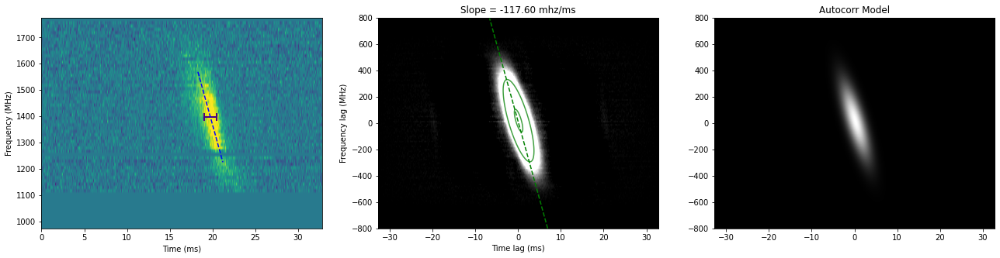

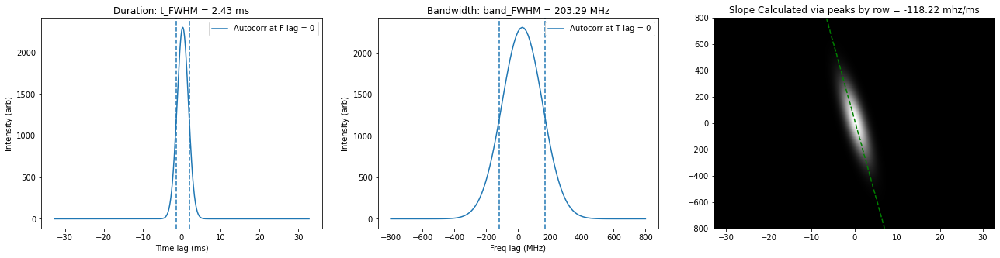

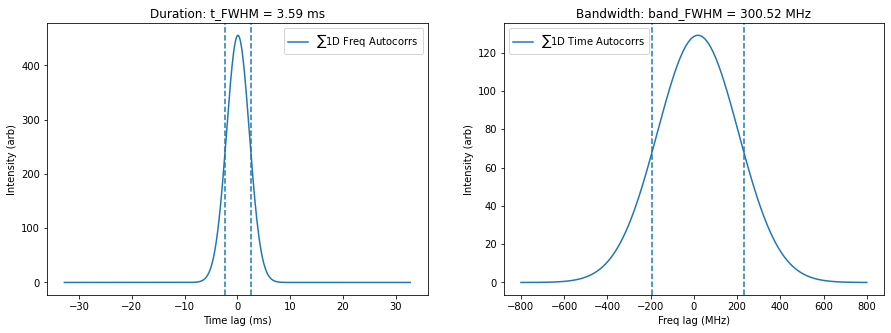

In [170]:
import importlib
importlib.reload(driftrate)
importlib.reload(driftlaw)

%matplotlib inline

aggdf = pd.read_csv('results/FRB121102_aggarwal_4785rows_Jun17.csv').set_index('name')
DM = 559.5
burstrow = aggdf.loc[aggdf['DM'] == DM].loc['B006']
data = np.load('data/aggarwal2021/B006.1.npz')

wfall = data['wfall']
# print(f'{wfall.shape = }')
wfall[0:11] = 0
wfall[22] = 0
wfall[63] = 0
wfall = driftrate.subtractbg(wfall, 0, 100)
# def dedisperse(intensity, DM, nu_low, df_mhz, dt_ms, cshift=0):
wfall = driftrate.dedisperse(wfall, DM - 562.056, min(data['dfs']), data['dfs'][1]-data['dfs'][0], data['dt']*1000)
# wfall = driftrate._dedisperse(wfall, 100, burstmetadata['dfs'], data['dt'])
wfall = wfall[:, 400:800]
downt = 1
wfall = driftrate.subsample(wfall, int(wfall.shape[0]/1), int(wfall.shape[1]/downt))
df = data['bandwidth'] / wfall.shape[0]
dt = data['dt']*1000*downt
lowest_f = min(data['dfs'])
extents, corrextents = driftrate.getExtents(wfall, df=df, dt=dt, lowest_freq=lowest_f)

popt = list(burstrow[['amplitude', 'xo', 'yo', 'sigmax', 'sigmay', 'angle']])
tw_ms = burstrow['tau_w_ms'] #dataspace_df['tau_w_ms'][0]
center_f = burstrow['center_f']
slope = burstrow['slope (mhz/ms)']

corr = driftrate.autocorr2d(wfall)
fitmap = driftrate.makeDataFitmap(popt, corr, corrextents)

plt.figure(figsize=(22, 5))
plt.subplot(1, 3, 1)
plt.xlabel("Time (ms)"); plt.ylabel("Frequency (MHz)")
plt.imshow(wfall, origin='lower', aspect='auto', extent=extents)
pkidx = np.nanargmax(np.nanmean(wfall, axis=0))

plt.errorbar(pkidx*dt, center_f, xerr=tw_ms/2, color='#4b0082', linewidth=2, capthick=2, capsize=5, fmt='none')
xo = pkidx*dt
x = np.array([xo - tw_ms, xo + tw_ms])
plt.plot(x, slope*x + center_f - slope*xo, 'b--', lw=1.5)
plt.xlim(extents[:2])
plt.ylim(extents[2:])

plt.subplot(1, 3, 2)
plt.xlabel("Time lag (ms)"); plt.ylabel("Frequency lag (MHz)")
plt.title(f'Slope = {burstrow["slope (mhz/ms)"]:.2f} mhz/ms')
plt.imshow(corr, origin='lower', aspect='auto', cmap='gray', extent=corrextents)
plt.clim(0, np.max(corr)/20)

if popt[0] > 0:
    plt.contour(fitmap, [popt[0]/4, popt[0]*0.9], colors='g', alpha=0.75, extent=corrextents)
    xo = popt[1]
    x = np.array([corrextents[2] / slope + xo, corrextents[3] / slope + xo])
    plt.plot(x, slope*(x-xo), 'g--')

plt.xlim(corrextents[:2])
plt.ylim(corrextents[2:])

plt.subplot(1, 3, 3)
plt.title('Autocorr Model')
plt.imshow(fitmap, origin='lower', aspect='auto', cmap='gray', extent=corrextents)

### Burst properties

f_lag0_intensity = fitmap[fitmap.shape[0]//2,...]
t_lag0_intensity = fitmap[..., fitmap.shape[1]//2]

def getFWHM(profile):
    left = np.argmax(profile > np.max(profile) / 2)
    if profile[left] > np.max(profile):
        raise "Invalid Pulse shape"
    right = len(profile) - np.argmax(np.flip(profile) > np.max(profile) / 2)
    FWHM = (right - left)
    return FWHM, left, right

# duration calculation
FWHM, tleft, tright = getFWHM(f_lag0_intensity)
t_FWHM = FWHM/np.sqrt(2) * dt

# bandwidth calculation
FWHM, fleft, fright = getFWHM(t_lag0_intensity)
band_FWHM = FWHM/np.sqrt(2) * df

# Slope calculation
peaks = np.argmax(np.flipud(fitmap), axis=1)
peaklags = np.interp(peaks, [0, fitmap.shape[1]], corrextents[:2])
freqs = np.linspace(corrextents[3], corrextents[2], num=len(peaklags))
slope = (freqs[-1] - freqs[0]) / (peaklags[-1] - peaklags[0])

plt.figure(figsize=(22, 5))
plt.subplot(1,3,1)
plt.plot(np.linspace(corrextents[0], corrextents[1], num=len(f_lag0_intensity)), f_lag0_intensity, label='Autocorr at F lag = 0')
plt.legend(); plt.xlabel("Time lag (ms)"); plt.ylabel("Intensity (arb)")
plt.axvline(x=np.interp(tleft, [0, len(f_lag0_intensity)], corrextents[:2]), ls='--') 
plt.axvline(x=np.interp(tright, [0, len(f_lag0_intensity)], corrextents[:2]), ls='--')
plt.title(f"Duration: {t_FWHM = :.2f} ms")

plt.subplot(1,3,2)
plt.plot(np.linspace(corrextents[2], corrextents[3], num=len(t_lag0_intensity)), t_lag0_intensity, label='Autocorr at T lag = 0')
plt.legend(); plt.xlabel("Freq lag (MHz)"); plt.ylabel("Intensity (arb)")
plt.axvline(x=np.interp(fleft, [0, len(t_lag0_intensity)], corrextents[2:]), ls='--') 
plt.axvline(x=np.interp(fright, [0, len(t_lag0_intensity)], corrextents[2:]), ls='--')
plt.title(f"Bandwidth: {band_FWHM = :.2f} MHz")

plt.subplot(1,3,3)
plt.title(f'Slope Calculated via peaks by row = {slope:.2f} mhz/ms')
plt.imshow(fitmap, origin='lower', aspect='auto', cmap='gray', extent=corrextents)
plt.plot(peaklags, freqs, 'g--')

bandwidth = 2*np.sqrt(2*np.log(2))*burstrow['max_sigma']*np.cos(burstrow['theta']-np.pi/2)
print(f"{tw_ms = :.2f} ms,\t\t {t_FWHM = :.2f} ms")
print(f"old slope = {burstrow['slope (mhz/ms)']:.2f} mhz/ms,\t new {slope = :.2f} mhz/ms")
print(f"{band_FWHM = :.3f} MHz analytical = {bandwidth} MHz")

### Summed autocorrelation measurements

summed_tcorr = np.mean(fitmap, axis=0)
summed_fcorr = np.mean(fitmap, axis=1)
FWHM, tleft, tright = getFWHM(summed_tcorr)
t_FWHM = FWHM/np.sqrt(2) * dt
FWHM, fleft, fright = getFWHM(summed_fcorr)
band_FWHM = FWHM/np.sqrt(2) * df

plt.figure(figsize=(15, 5))
plt.subplot(1,2,1)
plt.plot(np.linspace(corrextents[0], corrextents[1], num=len(summed_tcorr)), summed_tcorr, label='$\sum$1D Freq Autocorrs')
plt.legend(); plt.xlabel("Time lag (ms)"); plt.ylabel("Intensity (arb)")
plt.axvline(x=np.interp(tleft, [0, len(summed_tcorr)], corrextents[:2]), ls='--') 
plt.axvline(x=np.interp(tright, [0, len(summed_tcorr)], corrextents[:2]), ls='--')
plt.title(f"Duration: {t_FWHM = :.2f} ms")

plt.subplot(1,2,2)
plt.plot(np.linspace(corrextents[2], corrextents[3], num=len(summed_fcorr)), summed_fcorr, label='$\sum$1D Time Autocorrs')
plt.legend(); plt.xlabel("Freq lag (MHz)"); plt.ylabel("Intensity (arb)")
plt.axvline(x=np.interp(fleft, [0, len(summed_fcorr)], corrextents[2:]), ls='--') 
plt.axvline(x=np.interp(fright, [0, len(summed_fcorr)], corrextents[2:]), ls='--')
plt.title(f"Bandwidth: {band_FWHM = :.2f} MHz")


## Batch Process

In [135]:
from datetime import datetime

# results = [
#     # "results/FRB121102_michilli_924rows_Apr18.csv",
#     # 'results/FRB121102_oostrum_1025rows_Jun10.csv', 
#     # 'results/FRB121102_aggarwal_4785rows_Jun17.csv',
#     # 'results/GajjarFRB121102_672rows_Jun09.csv', 
#     # 'results/FRB121102_Li_419rows_Mar31.csv',
#     # 'results/FRB121102_Li_waittimes_1758rows_May04.csv'
# ]
results = [
    "results/FRB121102_michilli_924rows_Jul07.csv",
    'results/FRB121102_oostrum_1025rows_Jul07.csv', 
    'results/FRB121102_aggarwal_4785rows_Jul07.csv',
    'results/GajjarFRB121102_672rows_Jul07.csv',
    'results/FRB121102_Li_419rows_Jul07.csv',
    'results/FRB121102_Li_waittimes_1758rows_Jul07.csv'
]
datestr = datetime.now().strftime('%b%d')

newdfs = []
for result in results:
    df = pd.read_csv(result).set_index('name')
    for name, burstrow in df.iterrows():
        DM = burstrow['DM']
        corrdummy = np.zeros((int(burstrow['fchans']*2-1), int(burstrow['tchans']*2-1)))
        wfalldummy = np.zeros((int(burstrow['fchans']), int(burstrow['tchans'])))
        df_mhz, dt_ms = burstrow['f_res (mhz)'], burstrow['time_res (s)']*1000
        _, corrextents = driftrate.getExtents(wfalldummy, df=df_mhz, dt=dt_ms, lowest_freq=0)
       
        popt = list(burstrow[['amplitude', 'xo', 'yo', 'sigmax', 'sigmay', 'angle']])
        fitmap = driftrate.makeDataFitmap(popt, corrdummy, corrextents) 
        # if name == 'R1_B02' and DM == 566:
        #     plt.title(f"{name} {DM}")
        #     plt.imshow(fitmap, origin='lower', aspect='auto', cmap='gray', extent=corrextents)

        summed_tcorr = np.mean(fitmap, axis=0)
        summed_fcorr = np.mean(fitmap, axis=1)

        # duration calculation
        FWHM, _, _ = getFWHM(summed_tcorr)
        t_FWHM = FWHM/np.sqrt(2) * dt_ms
        
        # bandwidth calculation
        FWHM, _, _ = getFWHM(summed_fcorr)
        band_FWHM = FWHM/np.sqrt(2) * df_mhz

        peaklags = np.interp(np.argmax(np.flipud(fitmap), axis=1), [0, fitmap.shape[1]], corrextents[:2])
        freqs = np.linspace(corrextents[3], corrextents[2], num=len(peaklags))
        slope = (freqs[-1] - freqs[0]) / (peaklags[-1] - peaklags[0])
        if abs(slope) == np.inf:
            slope = 1 # value to signal invalid measurement and positive slopes will be excluded
        
        df.loc[(df.index == name)  & (df.DM == DM), 'tw_FWHM_ms'] = t_FWHM
        df.loc[(df.index == name)  & (df.DM == DM), 'band_FWHM_mhz'] = band_FWHM
        df.loc[(df.index == name)  & (df.DM == DM), 'line slope (mhz/ms)'] = slope
        # print(f"{name} @ {DM}: {burstrow['tau_w_ms']:.2f} ms --> {t_FWHM:.2f} ms\t {burstrow['slope (mhz/ms)']:.2f} mhz/ms --> {slope:.2f} mhz/ms \t {band_FWHM = } MHz")
            
    newdfs.append(df)
    outfile = f"{'_'.join(result.split('_')[:-1])}_{datestr}_newband.csv"
    # df.to_csv(outfile); print(f'Saved {outfile}')

allmeasurements = pd.concat(newdfs)
display(allmeasurements[['DM', 'tau_w_ms', 'tw_FWHM_ms', 'slope (mhz/ms)', 'line slope (mhz/ms)', 'band_FWHM_mhz']].loc['B006'])

Saved results/FRB121102_michilli_924rows_Jul07.csv
Saved results/FRB121102_oostrum_1025rows_Jul07.csv
B006: t_FWHM = 3.5934934781611427 band_FWHM = 300.5203820042827
Saved results/FRB121102_aggarwal_4785rows_Jul07.csv
Saved results/GajjarFRB121102_672rows_Jul07.csv
Saved results/FRB121102_Li_419rows_Jul07.csv
Saved results/FRB121102_Li_waittimes_1758rows_Jul07.csv


,DM,tau_w_ms,tw_FWHM_ms,slope (mhz/ms),line slope (mhz/ms),band_FWHM_mhz
name,,,,,,
B006,555.000,7.186987,7.186987,-44.197946,-44.197946,300.520382
B006,555.500,6.955149,6.955149,-47.080421,-47.080421,300.520382
B006,556.000,6.491472,6.491472,-50.758578,-50.758578,300.520382
B006,556.500,6.027796,6.027796,-55.530752,-55.530752,300.520382
B006,557.000,5.680038,5.680038,-60.910294,-60.910294,300.520382
B006,557.500,5.216362,5.216362,-67.211359,-67.211359,300.520382
B006,558.000,4.752685,4.752685,-75.255962,-75.255962,300.520382
B006,558.500,4.404927,4.404927,-86.244664,-86.244664,300.520382
B006,559.000,3.941251,3.941251,-99.445378,-99.445378,300.520382


In [280]:
%matplotlib qt
exclusions_layered = [
    ['M009', 'M010', 'M013'],
    ['R1_B10'], # ['R1_B08', 'R1_B09', R1_B10', 'R1_B12']
    ['B016', 'B028', 'B056', 'B109', 'B076', 'B079', 'B082', 'B133', 'B093', 'B091', 'B121', 'B128', 'B005', 'B008', 'B020', 'B022', 'B024', 'B029', 'B032', 'B032_b', 'B033', 'B038', 'B039', 'B041', 'B045', 'B048', 'B048_a', 'B048_b', 'B051', 'B055', 'B060', 'B060_a', 'B060_b', 'B064', 'B068', 'B069', 'B070', 'B071', 'B077', 'B078', 'B083', 'B086', 'B088_a', 'B088_b', 'B097', 'B099', 'B103', 'B107', 'B115', 'B127', 'B131'],
    ['11A', '11B', '12A', '12B', '11G'],
    [],
    [
        'FRB121102_tracking-M01_0576',
        'FRB121102_tracking-M01_1180',#
        'FRB121102_tracking-M01_0055',
        'FRB121102_tracking-M01_0095',
        'FRB121102_tracking-M01_0163',
        'FRB121102_tracking-M01_0264',
        'FRB121102_tracking-M01_0388',
        'FRB121102_tracking-M01_0415',
        'FRB121102_tracking-M01_0487',
        'FRB121102_tracking-M01_0576',
        'FRB121102_tracking-M01_0634'
    ]
]
exclusions = list(np.concatenate(exclusions_layered).flat)
allmeasurements = pd.concat(newdfs)
allmeasurements = allmeasurements.drop(exclusions)
allmeasurements['tdiff_percent'] = 100*abs(allmeasurements['tw_FWHM_ms'] - allmeasurements['tau_w_ms']) / allmeasurements['tau_w_ms']
allmeasurements[allmeasurements['tdiff_percent'] > 100][['tau_w_ms', 'tw_FWHM_ms', 'tdiff_percent']]
# allmeasurements.loc['B037']

,tau_w_ms,tw_FWHM_ms,tdiff_percent
name,,,
B001,0.139121,0.463677,233.289146
B001,0.136980,0.463677,238.500175
B004,0.161024,0.463677,187.955647
B004,0.161518,0.463677,187.074596
B004,0.162044,0.463677,186.142515
B037,1.000000,36.978207,3597.820708
B037,1.000000,36.978207,3597.820708
B037,1.000000,36.978207,3597.820708
B037,1.000000,36.978207,3597.820708


## Switch center_f
(use new calculation)

In [157]:
from datetime import datetime 

files = [
    "results/FRB121102_michilli_924rows_Jul04.csv",
    'results/FRB121102_oostrum_1025rows_Jul04.csv', 
    'results/FRB121102_aggarwal_4785rows_Jul04.csv',
    'results/GajjarFRB121102_672rows_Jul04.csv',
    'results/FRB121102_Li_419rows_Jul04.csv',
    'results/FRB121102_Li_waittimes_1758rows_Jul04.csv'
]

datestr = datetime.now().strftime('%b%d')
for file in files:
    df = pd.read_csv(file).set_index('name')
    
    if df['center_f'][0] != df['center_f_new'][0]:
        df['center_f_old'] = df['center_f']
        df['center_f'] = df['center_f_new']
        # display(df[['center_f', 'center_f_new', 'center_f_old']])
    
    outfile = f"{'_'.join(file.split('_')[:-1])}_{datestr}.csv"
    print(outfile); df.to_csv(outfile)

results/FRB121102_michilli_924rows_Jul07.csv
results/FRB121102_oostrum_1025rows_Jul07.csv
results/FRB121102_aggarwal_4785rows_Jul07.csv
results/GajjarFRB121102_672rows_Jul07.csv
results/FRB121102_Li_419rows_Jul07.csv
results/FRB121102_Li_waittimes_1758rows_Jul07.csv


## Gaussian Autocorrelation Width Factor

Text(0.5, 1.0, 'Autocorr FWHM / FWHM')

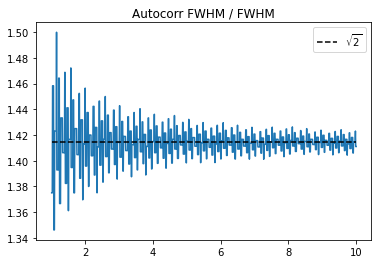

In [329]:
%matplotlib inline 

x = np.linspace(-50, 50, num=1000)
sigma = np.linspace(1, 10, num=1000)
factors = []
for s in sigma:
    y = np.exp(-x**2/(2*s**2))
    autocorr = np.correlate(y, y, 'full')
    FWHM, _, _ = getFWHM(y)
    autoFWHM, _, _ = getFWHM(autocorr)
    factors.append(autoFWHM/FWHM)
    # [plt.axvline(x=l, ls='--') for l in [left, right]]
plt.plot(sigma, factors)
plt.plot(sigma, [np.sqrt(2)]*len(sigma), 'k--', label='$\sqrt{2}$')
plt.legend()
plt.title('Autocorr FWHM / FWHM')

# Simulated

## Slope vs. Cutoff

slope = -7910.780909205685
slope = -7766.842091293334
slope = -7406.19824141128
slope = -6668.699888710216
slope = -5407.069414379758
slope = -3535.8989601504645
slope = -1019.2835423577026
centerfs = [400, 450, 500, 550, 600, 650, 700]
slopes = [-7910.780909205685, -7766.842091293334, -7406.19824141128, -6668.699888710216, -5407.069414379758, -3535.8989601504645, -1019.2835423577026]


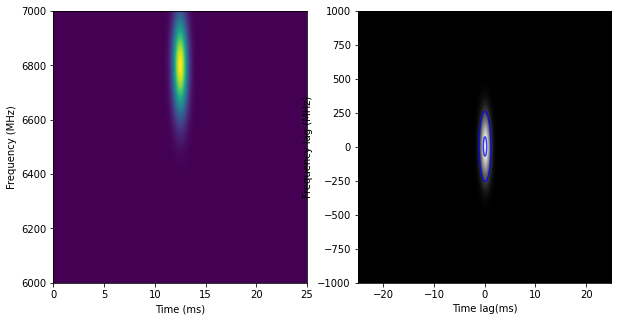

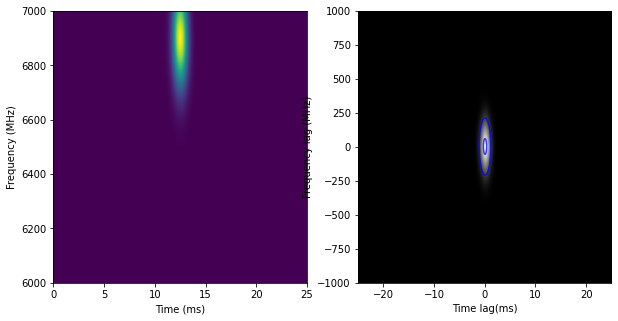

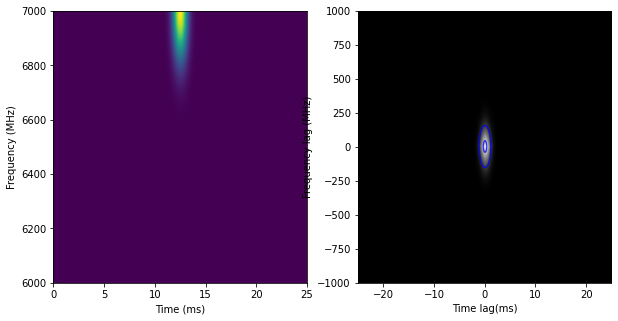

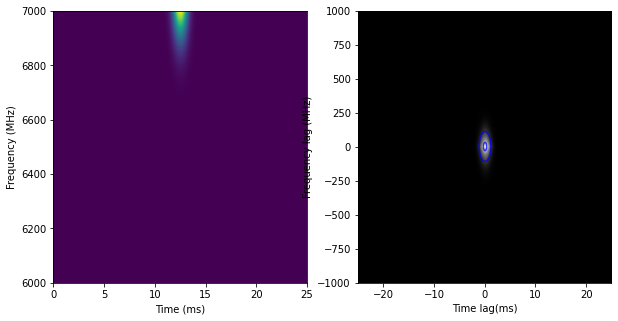

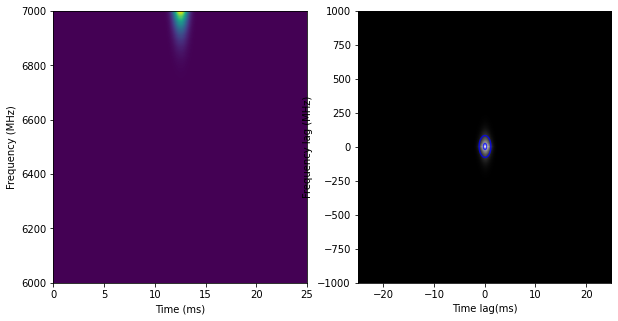

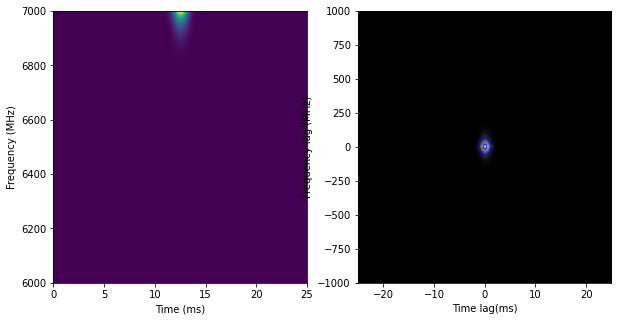

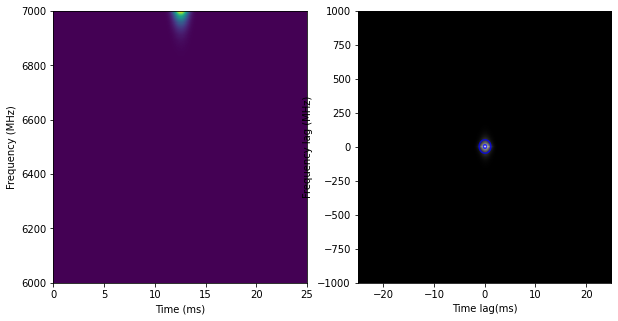

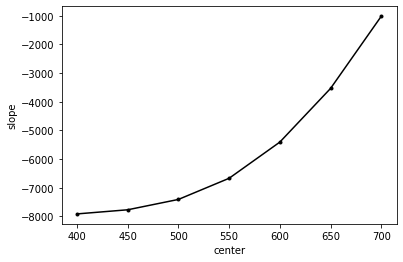

In [179]:
import importlib
importlib.reload(driftrate)
%matplotlib inline

slopes = []
centerfs = [400, 450, 500, 550, 600, 650, 700]
w, h = 500, 500

for centerf in centerfs:
    x, y = np.meshgrid(range(0, w), range(0, h))
    popt = [1, w/2, centerf, 10, 60, 0.005]
    burst = driftrate.twoD_Gaussian((y, x), *popt).reshape(h, w)

    low_f, high_f = 6000, 7000
    tstart, tend = 0, 25
    nu_obs = np.linspace(low_f, high_f, num=h)
    tres = (tend - tstart)/w
    fres = (high_f - low_f)/h

    measurement = driftrate.processBurst(burst, fres, tres, low_f, verbose=False, p0=[])
    slope, slope_err, popt, perr, theta, red_chisq, center_f, fitmap = measurement
    slopes.append(slope)
    print(f'{slope = }')

    extent, corrextent = driftrate.getExtents(burst, fres, tres, low_f)
    plt.figure(figsize=(10,5))
    plt.subplot(1, 2, 1)
    plt.imshow(burst, origin='lower', aspect='auto', interpolation='none', extent=extent)
    plt.ylabel("Frequency (MHz)")
    plt.xlabel("Time (ms)")

    corr = driftrate.autocorr2d(burst)
    fitmap = driftrate.makeFitmap(popt, corr)
    plt.subplot(1, 2, 2)
    plt.imshow(corr, origin='lower', interpolation='none', aspect='auto', cmap='gray', extent=corrextent)
    plt.ylabel("Frequency lag (MHz)")
    plt.xlabel("Time lag(ms)")
    if popt[0] > 0:
        plt.contour(fitmap, [popt[0]/4, popt[0]*0.9], colors='b', alpha=0.75, extent=corrextent, origin='lower')

plt.figure()
plt.plot(centerfs, slopes, 'k.-')
plt.xlabel('center'); plt.ylabel('slope')
print(f'{centerfs = }')
print(f'{slopes = }')

## Slope vs. Aspect Ratio

popt = [1, 2400.0, 32.0, 5, 15, -3.241592653589793]
burst.shape = (64, 4800) fres = 10.9375 tres = 0.005208333333333333
popt = [1, 2400.0, 32.0, 5, 15, -3.0753571328928806]
burst.shape = (64, 4800) fres = 10.9375 tres = 0.005208333333333333
popt = [1, 2400.0, 32.0, 5, 15, -2.9091216121959684]
burst.shape = (64, 4800) fres = 10.9375 tres = 0.005208333333333333
popt = [1, 2400.0, 32.0, 5, 15, -2.742886091499056]
burst.shape = (64, 4800) fres = 10.9375 tres = 0.005208333333333333
popt = [1, 2400.0, 32.0, 5, 15, -2.576650570802143]
burst.shape = (64, 4800) fres = 10.9375 tres = 0.005208333333333333
popt = [1, 2400.0, 32.0, 5, 15, -2.4104150501052306]
burst.shape = (64, 4800) fres = 10.9375 tres = 0.005208333333333333
popt = [1, 2400.0, 32.0, 5, 15, -2.2441795294083184]
burst.shape = (64, 4800) fres = 10.9375 tres = 0.005208333333333333
popt = [1, 2400.0, 32.0, 5, 15, -2.077944008711406]
burst.shape = (64, 4800) fres = 10.9375 tres = 0.005208333333333333
popt = [1, 2400.0, 32.0, 5, 15, -1.9

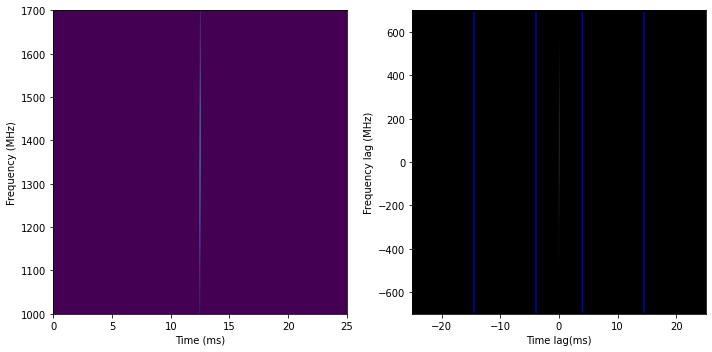

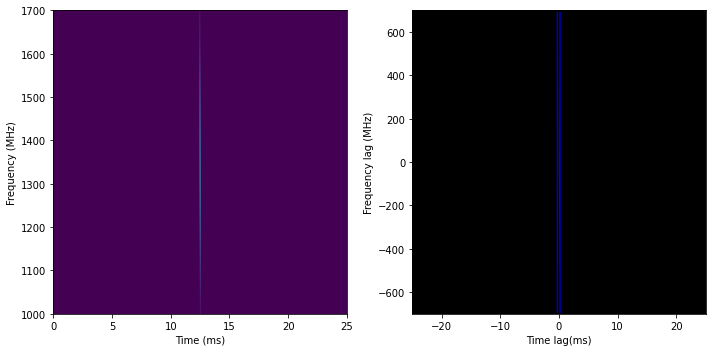

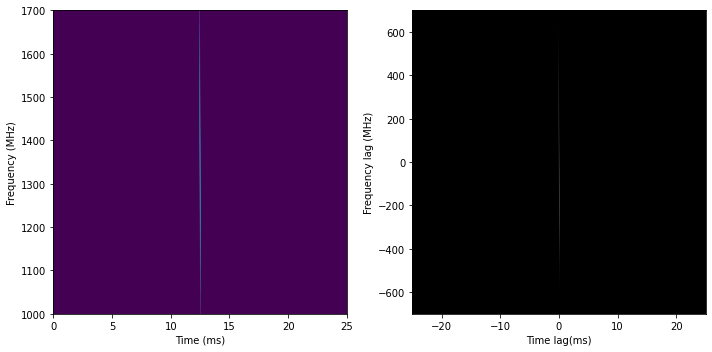

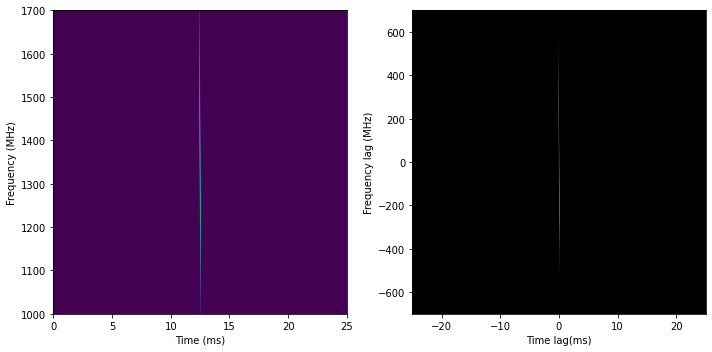

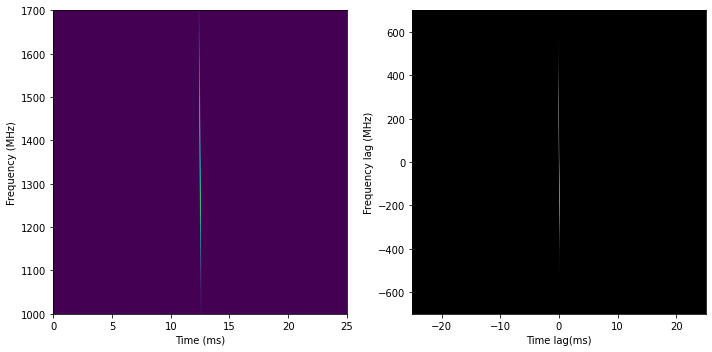

...

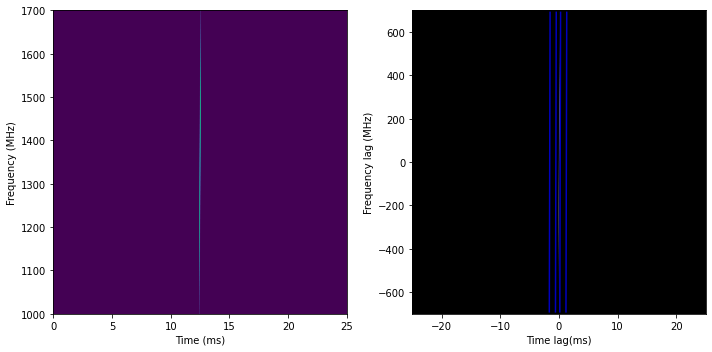

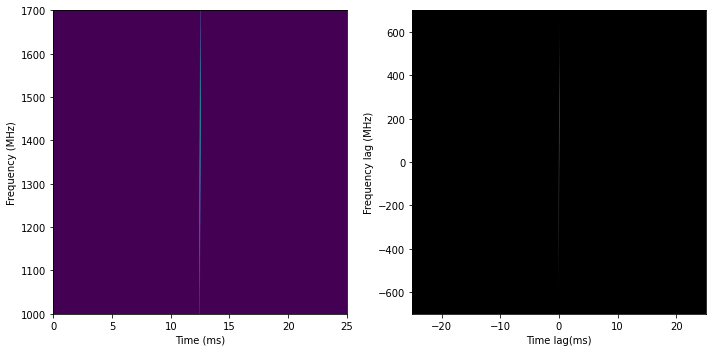

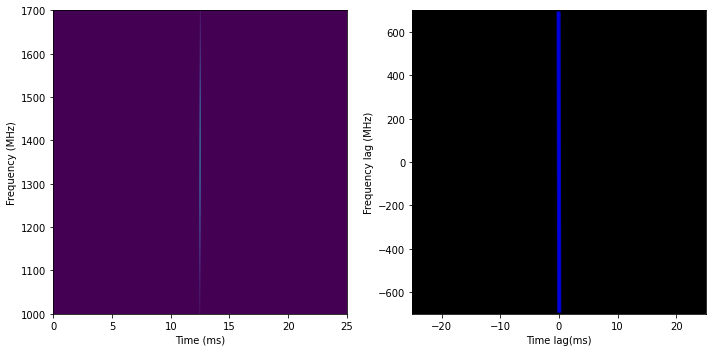

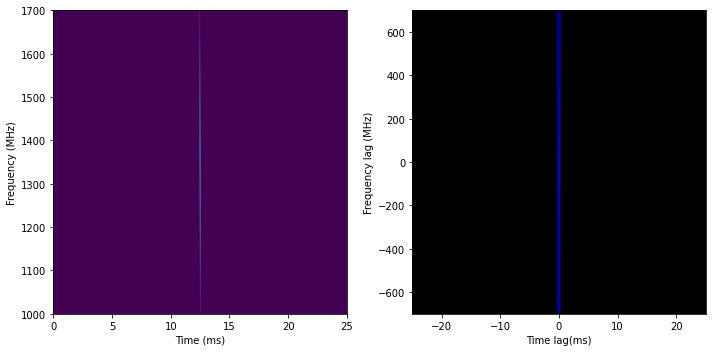

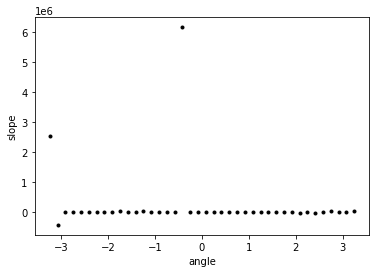

In [62]:
import importlib
importlib.reload(driftrate)
%matplotlib inline

slopes = []
w, h = 4800, 64
# w, h = 64, 480

angles = np.linspace(-np.pi-0.1, np.pi+0.1, num=40)
for angle in angles:
    x, y = np.meshgrid(range(0, w), range(0, h))
    popt = [1, w/2, h/2, 5, 15, angle] # amplitude, xo, yo, sigma_x, sigma_y, theta
    print(f"{popt = }")
    burst = driftrate.twoD_Gaussian((y, x), *popt).reshape(h, w)

    low_f, high_f = 1000, 1700
    tstart, tend = 0, 25
    # fres_MHz = 12.5 tres_ms = 0.08196721311475409
    nu_obs = np.linspace(low_f, high_f, num=h)
    tres = (tend - tstart)/w
    fres = (high_f - low_f)/h
    print(f"{burst.shape = } {fres = } {tres = }")

    measurement = driftrate.processBurst(burst, fres, tres, low_f, verbose=False, p0=[])
    slope, slope_err, popt, perr, theta, red_chisq, center_f, fitmap = measurement
    slopes.append(slope)
    # print(f'{slope = }')

    extent, corrextent = driftrate.getExtents(burst, fres, tres, low_f)
    aspect = 'auto'
    plt.figure(figsize=(10,5))
    plt.subplot(1, 2, 1)
    plt.imshow(burst, origin='lower', aspect=aspect, interpolation='none', extent=extent)
    plt.ylabel("Frequency (MHz)")
    plt.xlabel("Time (ms)")

    corr = driftrate.autocorr2d(burst)
    fitmap = driftrate.makeFitmap(popt, corr)
    plt.subplot(1, 2, 2)
    plt.imshow(corr, origin='lower', interpolation='none', aspect=aspect, cmap='gray', extent=corrextent)
    plt.ylabel("Frequency lag (MHz)")
    plt.xlabel("Time lag(ms)")
    if popt[0] > 0:
        plt.contour(fitmap, [popt[0]/4, popt[0]*0.9], colors='b', alpha=0.75, extent=corrextent, origin='lower')

    plt.tight_layout()
    
plt.figure()
plt.plot(angles, slopes, 'k.')
plt.xlabel('angle'); plt.ylabel('slope')
print(f'{angles = }')
print(f'{slopes = }')

## Superradiance Pulses

In [58]:
import pandas as pd

df = pd.concat([pd.read_csv(file).set_index('name') for file in glob.glob('results/simulated/wfall_*.csv')])
df.to_csv('results/simulated/multiplelines_aish_apr10.csv')

# Experiments

## Integrated and Average Spectrum

processing M016: 100%|███████████████████████████████████████████████████████████████████| 924/924 [00:00<00:00, 4825.77it/s]


(512,) (512,)


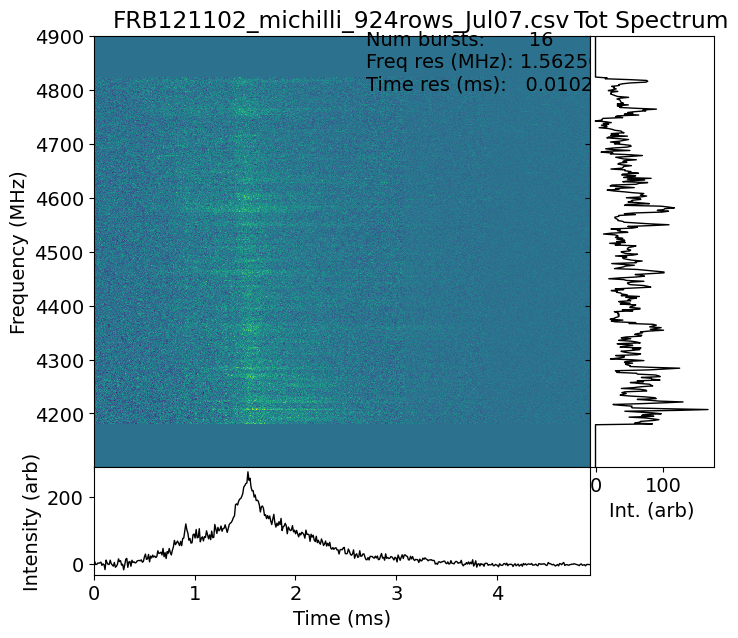

processing 12C: 100%|██████████████████████████████████████████████████████████████████| 1092/1092 [00:00<00:00, 2400.82it/s]


(1690,) (1690,)


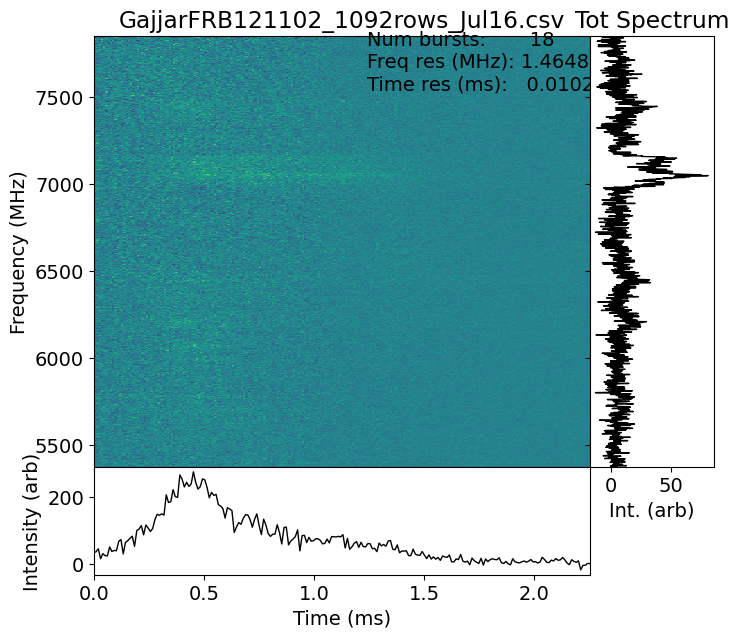

processing R1_B30: 100%|███████████████████████████████████████████████████████████████| 1025/1025 [00:00<00:00, 5180.87it/s]


(128,) (128,)


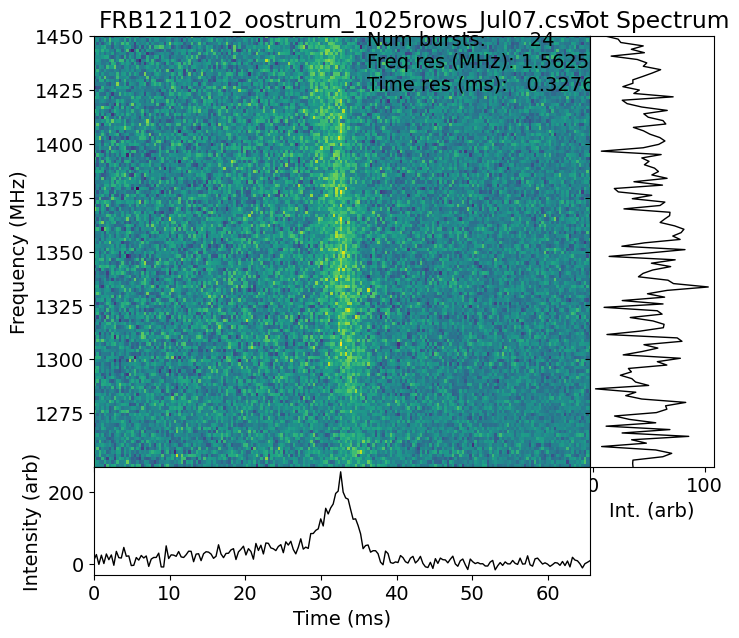

processing B133: 100%|█████████████████████████████████████████████████████████████████| 4785/4785 [00:00<00:00, 6116.09it/s]


(64,) (64,)


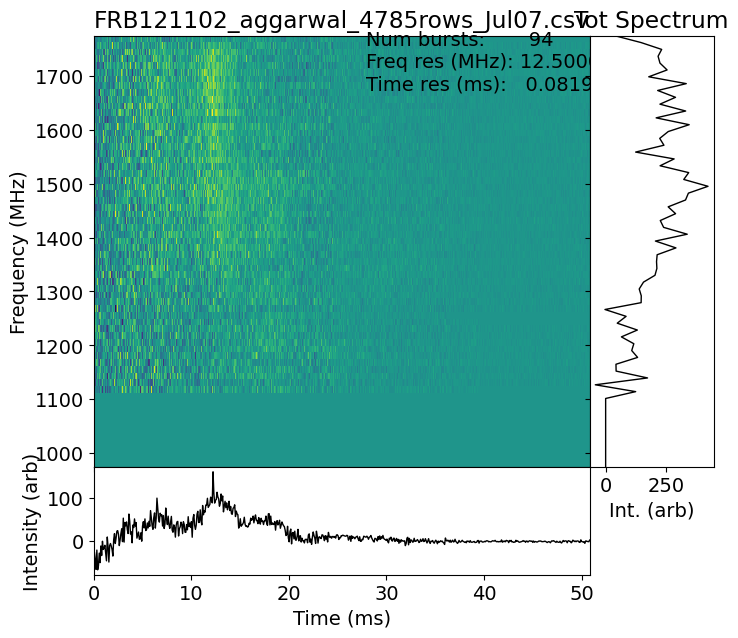

processing FRB121102_tracking_3-M01_0153: 100%|████████████████████████████████████████| 2177/2177 [00:00<00:00, 4002.44it/s]


(256,) (256,)


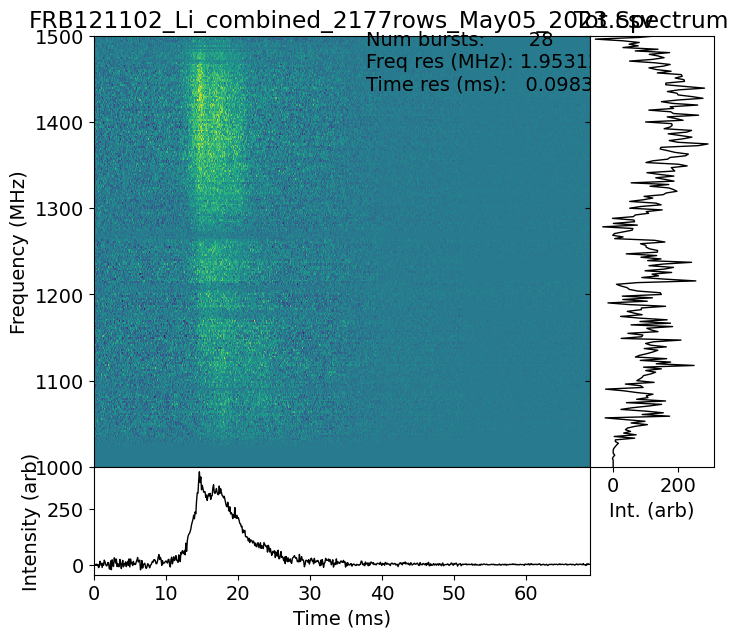

In [4]:
import driftrate
import importlib
import itertools
importlib.reload(driftrate)

def loadwfalls(resultsfile, datafiles=[], masks=None, wfallcb=lambda *a, **k:None):
    resultsdf = pd.read_csv(resultsfile).set_index('name')

    if type(masks) == str: # filename
        if os.path.exists(masks):
            masks = np.load(masks, allow_pickle=True)[0]

    pname = ''
    pbar = tqdm(resultsdf.iterrows(), total=len(resultsdf))
    burstcount = 0
    for name, row in pbar:
        if pname != name: 
            # print('processing', name)  # print once
            pbar.set_description(f'processing {name}')
        pname = name
        ismulti = any([suffix in name[-2:] for suffix in driftrate.subburst_suffixes])
        if ismulti: continue # shortcircuit for average waterfall
        if 'background' in row.index and not np.isnan(row['background']) and ismulti:
            subname = name
            name, suffix = '_'.join(name.split('_')[:-1]), name.split('_')[-1]
            regcols = [col for col in row.index if 'reg' in col]
            regcols.append('background') if 'background' in row.index else None
            regions = {suffix: [row[f'regstart_{suffix}'], row[f'regend_{suffix}']]}
            regions['background'] = [0, row['background']]
        else:
            regions = None

        file = [f for f in datafiles if name in f][0]
        data = np.load(file, allow_pickle=True)
        
        # Only do burst dm for integrating spectrum to save time
        if row['DM'] - data['DM'] != 0:
            continue

        wfall = data['wfall']
        storedshape = wfall.shape

        df, dt_ms = row['f_res (mhz)'], row['time_res (s)']*1000
        lowest_freq = min(data['dfs']) # off by half a channel probably

        # apply masks
        if masks is not None and masks != []:
            mask = [masks[k] for k in masks.keys() if name in k]
            if mask != []:
                mask = mask[0]['chans']
            for m in mask:
                if m < len(wfall):
                    wfall[m] = 0

        # Check if the waterfall was subsampled
        if 'downf' in row and 'downt' in row:
            # wfall = driftrate.subsample(wfall, int(wfall.shape[0]/row['downf']), int(wfall.shape[1]/row['downt']))
            # We won't downsample for integrating/averageing
            df /= row['downf']; dt_ms /= row['downt']
        if 'tsamp_width' in row:
            wfall = driftrate.cropwfall(wfall, twidth=row['tsamp_width']) # crop after subsampling.

        if 'subbg_start (ms)' in row and not np.isnan(row['subbg_start (ms)']):
            tleft, tright = row['subbg_start (ms)'], row['subbg_end (ms)']
            timerange = [0, round(dt_ms*wfall.shape[1])]
            tleft  = round(np.interp(tleft, timerange, [0, wfall.shape[1]]))
            tright = round(np.interp(tright, timerange, [0, wfall.shape[1]]))
            wfall = driftrate.subtractbg(wfall, tleft, tright)

        extents, corrextents = driftrate.getExtents(wfall, df=df, dt=dt_ms, lowest_freq=lowest_freq)
        if regions:
            wfall = driftrate.getSubbursts(wfall, df, dt_ms, lowest_freq, regions)[suffix]
            extents, corrextents = driftrate.getExtents(wfall, df=df, dt=dt_ms, lowest_freq=lowest_freq)

        # dedisperse
        ddm = row['DM'] - data['DM']
        wfall = driftrate.dedisperse(wfall, ddm, lowest_freq, df, dt_ms)

        # DO WHAT YOU WANT
        if name not in ["R1_B30"]:
            burstcount += 1
            wfallcb(wfall, name, extents, ddm)
        
    return df, dt_ms, burstcount

results = [
    "results/FRB121102_michilli_924rows_Jul07.csv",
    'results/GajjarFRB121102_1092rows_Jul16.csv', 
    'results/FRB121102_oostrum_1025rows_Jul07.csv', 
    'results/FRB121102_aggarwal_4785rows_Jul07.csv',
    'results/FRB121102_Li_combined_2177rows_May05_2023.csv',
    # 'results/FRB121102_driftratesv2_922rows_Jul17.csv'
]

datadirs = [
    'data/michilli2018/*.npz',
    'data/gajjar2018/*.npz',
    'data/oostrum2020/R1_frb121102/*.npz',
    'data/aggarwal2021/*.npz',
    '/Volumes/moonhd/Li2021/samp*/*.npz' #'/mnt/e/Li2021/samp*/*.npz',
    # '/mnt/b/dev/frbgui/SurveyFRB20121102A/data/driftrates/*.npz'
]

maskfiles = [
    None, 
    None, 
    'oostrummasks_may2_2022.npy', 
    'aggarwalmasks_Jun17_2022.npy', 
    'li_masks_may3.npy', 
    # 'driftratemasks_jul16_22.npy'
]

%matplotlib inline
mosaic = [["wfall", "spec"]]
summedwfall = None
totextents = None
def integratewfall(wfall, name, extents, ddm, plot=False, center=True):
    global summedwfall, totextents
    # print(name, extents)
    wfall = wfall/np.max(wfall) 
    
    # center on pulse
    if center:
        pkidx = np.nanargmax(np.nanmean(wfall, axis=0))
        wfall = np.roll(wfall, (wfall.shape[1]-1)//2 - pkidx, axis=1)
    
    if type(summedwfall) == np.ndarray:
        if summedwfall.shape == wfall.shape:
            summedwfall += wfall
            totextents = extents
        else: # add up columns lined up on the left
            if wfall.shape[1] <= summedwfall.shape[1]:
                for i in range(0, wfall.shape[1]): 
                    summedwfall[:,i] += wfall[:,i]
            else: # assume the size of wfall, which is larger
                tmp = np.copy(wfall)
                for i in range(0, summedwfall.shape[1]): 
                    tmp[:,i] += summedwfall[:,i]
                summedwfall = np.copy(tmp)
                totextents = extents
    else:
        summedwfall = wfall

    if plot:
        fig, axs = plt.subplot_mosaic(mosaic, gridspec_kw={'wspace':0}, width_ratios=[4,1], sharey=True)
        axs["wfall"].imshow(wfall, origin='lower', interpolation='none', aspect='auto', extent=extents)
        axs["wfall"].set_xlabel("Time (ms)")
        axs["wfall"].set_ylabel("Frequency (MHz)")
        axs["wfall"].set_title(f"{name}")

        freqs = np.linspace(extents[2], extents[3], num=wfall.shape[0])
        spectrum = wfall.sum(axis=1) # freq v intensity
        axs["spec"].plot(spectrum, freqs, c='black', lw=1)
        axs["spec"].set_title("Tot Spectrum")
        plt.show()
        # plt.savefig(f"gallery/{name}.png", facecolor="white", dpi=200)
        plt.close()

int_wfalls = {} # storage for the integrated waterfalls
for filename, datadir, masks in zip(results, datadirs, maskfiles):
    files = glob.glob(datadir)
    masks = None if not masks else np.load(masks, allow_pickle=True)[0]
    df, dt_ms, burstcount = loadwfalls(filename, datafiles=files, masks=masks, wfallcb=integratewfall)
    
    with mpl.rc_context({'font.size': 14}):
        fig, axs = plt.subplot_mosaic([["wfall", "spec"], ["time", '.']], figsize=(8, 7), width_ratios=[4, 1], height_ratios=[4, 1],
                                      gridspec_kw={'wspace':0, 'hspace':0})
        axs["spec"].sharey(axs["wfall"]) # sharey and sharex must be called after axs creation. undefined behaviour otherwise
        axs["time"].sharex(axs["wfall"])
        
        axs["wfall"].imshow(summedwfall, origin='lower', interpolation='none', aspect='auto', extent=totextents)
        axs["wfall"].set_xlabel("Time (ms)")
        axs["wfall"].set_ylabel("Frequency (MHz)")
        axs["wfall"].set_title(f"{filename.split('/')[1]}")
        axs["wfall"].text(0.55, 0.875, 
                          f"Num bursts: {burstcount:8d}\nFreq res (MHz): {df:8.6f}\nTime res (ms):   {dt_ms:8.6f}",
                         transform=axs["wfall"].transAxes)
        axs["wfall"].label_outer()

        freqs = np.linspace(totextents[2], totextents[3], num=summedwfall.shape[0])
        spectrum = summedwfall.sum(axis=1) # freq v intensity
        print(freqs.shape, spectrum.shape)
        axs["spec"].plot(spectrum, freqs, c='black', lw=1)
        axs["spec"].set_xlabel("Int. (arb)")
        axs["spec"].set_title("Tot Spectrum")
        plt.setp(axs["spec"].get_yticklabels(), visible=False)

        times = np.linspace(totextents[0], totextents[1], num=summedwfall.shape[1])
        timeseries = summedwfall.sum(axis=0)
        axs["time"].plot(times, timeseries, c='k', lw=1)
        axs["time"].set_xlabel("Time (ms)")
        axs["time"].set_ylabel("Intensity (arb)")
        axs["time"].label_outer()
        plt.show()
        plt.close()
        
        int_wfalls[filename] = { 
            'wfall': summedwfall, 
            'spec' : spectrum,
            'tseries': timeseries,
            'extent': totextents, 
            'df' : df, 
            'dt_ms': dt_ms, 
            "burstcount": burstcount
        }

    summedwfall, totextents = None, None


michextent = (0.0, 4.9152000000000005, 4100.78125, 4900.78125)
gajjextent = (0.0, 2.2522133333333265, 5373.5351125, 7849.12105)
aggextent = (0.0, 50.819672131147534, 974.53125, 1774.53125)
liextent = (0.0, 68.8128, 1000.0, 1500.0)
oosextent = (0.0, 65.536, 1250.09765625, 1450.09765625)
agg_deltaf = 12.5 li_deltaf = 1.953125 oos_deltaf = 1.5625
nustart=973.53515625 nuend=7847.65620625


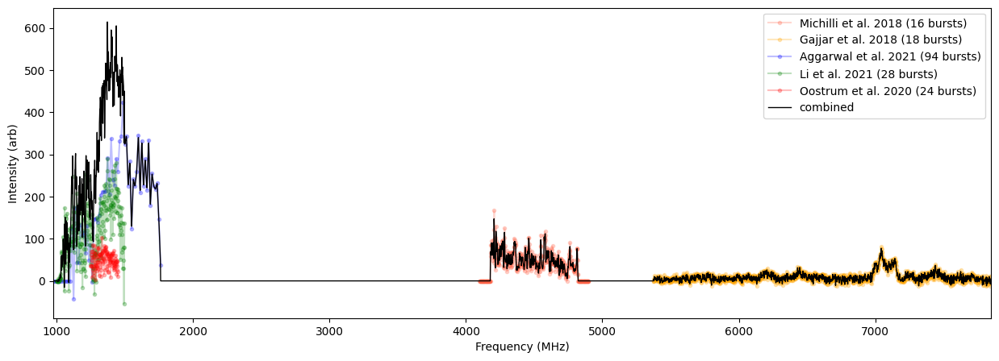

In [42]:
"""
For reference: 
int_wfalls[filename] = { 
    'wfall': summedwfall, 
    'extent': totextents, 
    'df' : df, 
    'dt_ms': dt_ms, 
    "burstcount": burstcount
}
results = [
    "results/FRB121102_michilli_924rows_Jul07.csv",
    'results/GajjarFRB121102_1092rows_Jul16.csv', 
    'results/FRB121102_oostrum_1025rows_Jul07.csv', 
    'results/FRB121102_aggarwal_4785rows_Jul07.csv',
    'results/FRB121102_Li_combined_2177rows_May05_2023.csv',
]
"""
%matplotlib inline
# print(f"{len(Is)=}, {len(nus)=}\n{Is = }\n{nus = }")
plt.figure(figsize=(15, 5))

Ic = np.array([2,2,3,3,4,6,10,6,4,3,3,2,2])
If = np.array([6, 7, 8, 10, 20, 10, 8, 7, 6])

nuc = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13]
nuf = [6.0, 6.2, 6.4, 6.6, 7, 7.2, 7.4, 7.6, 7.8]

step = (nuf[-1] - nuf[0])/len(nuf)
nustart = min(nuf[0], nuc[0])
nuend = max(nuf[-1], nuc[-1])

nus = np.arange(nustart, nuend+step, step)
numpads = (np.where(np.isclose(nus, nuf[0]))[0][0]+1, len(nus)-np.where(np.isclose(nus, nuf[-1]))[0][0]-1)
# print(np.where(np.isclose(nus, nuf[0]))[0][0])
Is = np.interp(nus, nuc, Ic) + np.pad(If, numpads)
# plt.plot(nus, Is, 'k-.')

#########
michextent = int_wfalls['results/FRB121102_michilli_924rows_Jul07.csv']['extent']
mich_deltaf = int_wfalls['results/FRB121102_michilli_924rows_Jul07.csv']['df']
mich_spec = int_wfalls['results/FRB121102_michilli_924rows_Jul07.csv']['spec']
mich_freqs = np.arange(michextent[2], michextent[3], step=mich_deltaf)
mich_count = int_wfalls['results/FRB121102_michilli_924rows_Jul07.csv']['burstcount']
if not len(mich_freqs) == len(mich_spec): raise

gajjextent = int_wfalls['results/GajjarFRB121102_1092rows_Jul16.csv']['extent']
gajj_deltaf = int_wfalls['results/GajjarFRB121102_1092rows_Jul16.csv']['df']
gajj_spec = int_wfalls['results/GajjarFRB121102_1092rows_Jul16.csv']['spec']
gajj_freqs = np.arange(gajjextent[2], gajjextent[3], step=gajj_deltaf)
gajj_count = int_wfalls['results/GajjarFRB121102_1092rows_Jul16.csv']['burstcount']
if not len(gajj_freqs) == len(gajj_spec): raise

aggextent = int_wfalls['results/FRB121102_aggarwal_4785rows_Jul07.csv']['extent']
agg_deltaf = int_wfalls['results/FRB121102_aggarwal_4785rows_Jul07.csv']['df']
agg_spec = int_wfalls['results/FRB121102_aggarwal_4785rows_Jul07.csv']['spec']
agg_freqs = np.arange(aggextent[2], aggextent[3], step=agg_deltaf)
agg_count = int_wfalls['results/FRB121102_aggarwal_4785rows_Jul07.csv']['burstcount']
if not len(agg_freqs) == len(agg_spec): raise

liextent = int_wfalls['results/FRB121102_Li_combined_2177rows_May05_2023.csv']['extent']
li_deltaf = int_wfalls['results/FRB121102_Li_combined_2177rows_May05_2023.csv']['df']
li_spec = int_wfalls['results/FRB121102_Li_combined_2177rows_May05_2023.csv']['spec']
li_freqs = np.arange(liextent[2], liextent[3], step=li_deltaf)
li_count = int_wfalls['results/FRB121102_Li_combined_2177rows_May05_2023.csv']['burstcount']
if not len(li_freqs) == len(li_spec): raise
    
oosextent = int_wfalls['results/FRB121102_oostrum_1025rows_Jul07.csv']['extent']
oos_deltaf = int_wfalls['results/FRB121102_oostrum_1025rows_Jul07.csv']['df']
oos_spec = int_wfalls['results/FRB121102_oostrum_1025rows_Jul07.csv']['spec']
oos_freqs = np.arange(oosextent[2], oosextent[3], step=oos_deltaf)
oos_count = int_wfalls['results/FRB121102_oostrum_1025rows_Jul07.csv']['burstcount']
if not len(oos_freqs) == len(oos_spec): raise

print(f"{michextent = }")
print(f"{gajjextent = }")
print(f"{aggextent = }")
print(f"{liextent = }")
print(f"{oosextent = }")
print(f"{agg_deltaf = } {li_deltaf = } {oos_deltaf = }")
    
step = min(li_deltaf, agg_deltaf, oos_deltaf)
nustart = min(li_freqs[0], agg_freqs[0], oos_freqs[0])
k = np.ceil((oos_freqs[0] - nustart)/step) 
nustart = oos_freqs[0] - k*step # shift by steps of the resolution of the finer spectrum until the whole band is covered
nuend = max(li_freqs[-1], agg_freqs[-1], oos_freqs[-1], mich_freqs[-1], gajj_freqs[-1])
print(f"{nustart=} {nuend=}")

nus = np.arange(nustart, nuend+step, step)
numpads = (np.where(np.isclose(nus, oos_freqs[0]))[0][0], len(nus)-np.where(np.isclose(nus, oos_freqs[-1]))[0][0]-1)
tot_bursts = mich_count + gajj_count + agg_count + li_count + oos_count
tot_bursts=1
Is = np.interp(nus, agg_freqs, agg_spec/tot_bursts, right=0, left=0) +\
     np.interp(nus, li_freqs, li_spec/tot_bursts, right=0, left=0) +\
     np.interp(nus, mich_freqs, mich_spec/tot_bursts, right=0, left=0) +\
     np.interp(nus, gajj_freqs, gajj_spec/tot_bursts, right=0, left=0) +\
     np.pad(oos_spec/tot_bursts, numpads) 

alpha = 0.25
plt.plot(mich_freqs, mich_spec/tot_bursts, '.-', color='tomato', alpha=alpha, label=f"Michilli et al. 2018 ({mich_count} bursts)")
plt.plot(gajj_freqs, gajj_spec/tot_bursts, '.-', color='orange', alpha=alpha, label=f"Gajjar et al. 2018 ({gajj_count} bursts)")
plt.plot(agg_freqs, agg_spec/tot_bursts, 'b.-', alpha=alpha, label=f"Aggarwal et al. 2021 ({agg_count} bursts)")
plt.plot(li_freqs, li_spec/tot_bursts, 'g.-', alpha=alpha, label=f'Li et al. 2021 ({li_count} bursts)')
plt.plot(oos_freqs, oos_spec/tot_bursts, 'r.-', alpha=alpha, label=f'Oostrum et al. 2020 ({oos_count} bursts)')
plt.plot(nus, Is, 'k-', lw=1, label='combined')
plt.xlabel("Frequency (MHz)")
plt.ylabel("Intensity (arb)")
plt.xlim(nustart, gajjextent[3])
plt.legend()